In [5]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

/kaggle/input/unet-data/new_data/real_size.xlsx
/kaggle/input/unet-data/new_data/real_size.csv
/kaggle/input/unet-data/new_data/valid/GT_ICM/Blast_PCRM_R14-0324a ICM_Mask.bmp
/kaggle/input/unet-data/new_data/valid/GT_ICM/Blast_PCRM_R16-0398A ICM_Mask.bmp
/kaggle/input/unet-data/new_data/valid/GT_ICM/Blast_PCRM_1202184 D5 ICM_Mask.bmp
/kaggle/input/unet-data/new_data/valid/GT_ICM/Blast_PCRM_R13-0019 ICM_Mask.bmp
/kaggle/input/unet-data/new_data/valid/GT_ICM/Blast_PCRM_R12-0315 ICM_Mask.bmp
/kaggle/input/unet-data/new_data/valid/GT_ICM/Blast_PCRM_R13-0494a ICM_Mask.bmp
/kaggle/input/unet-data/new_data/valid/GT_ICM/Blast_PCRM_R14-0118 ICM_Mask.bmp
/kaggle/input/unet-data/new_data/valid/GT_ICM/Blast_PCRM_R16-0330A ICM_Mask.bmp
/kaggle/input/unet-data/new_data/valid/GT_ICM/Blast_PCRM_R13-0163 ICM_Mask.bmp
/kaggle/input/unet-data/new_data/valid/GT_ICM/Blast_PCRM_R14-0323 ICM_Mask.bmp
/kaggle/input/unet-data/new_data/valid/GT_ICM/Blast_PCRM_R13-0065A ICM_Mask.bmp
/kaggle/input/unet-data/new_d

In [6]:
import os
import tensorflow as tf
import numpy as np
import glob

BASE_PATH = "/kaggle/input/unet-data/new_data"

# Define folders for train, validation, and test
TRAIN_IMAGES_DIR = os.path.join(BASE_PATH, "train", "images")
TRAIN_MASKS_DIR = os.path.join(BASE_PATH, "train", "GT_TE")

VAL_IMAGES_DIR = os.path.join(BASE_PATH, "valid", "images")
VAL_MASKS_DIR = os.path.join(BASE_PATH, "valid", "GT_TE")

TEST_IMAGES_DIR = os.path.join(BASE_PATH, "test", "images")
TEST_MASKS_DIR = os.path.join(BASE_PATH, "test", "GT_TE")


# Check if files are loaded correctly
print("Train images:", len(os.listdir(TRAIN_IMAGES_DIR)))
print("Train masks:", len(os.listdir(TRAIN_MASKS_DIR)))
print("Validation images:", len(os.listdir(VAL_IMAGES_DIR)))
print("Validation masks:", len(os.listdir(VAL_MASKS_DIR)))
print("Test images:", len(os.listdir(TEST_IMAGES_DIR)))
print("Test masks:", len(os.listdir(TEST_MASKS_DIR)))

IMG_HEIGHT = 256
IMG_WIDTH = 256


def load_image(image_path, mask_path):
    """Load and preprocess a single image-mask pair"""
    # Load image
    image = tf.io.read_file(image_path)
    image = tf.image.decode_bmp(image, channels=3)  # decode as RGB
    image = tf.image.rgb_to_grayscale(image)        # convert to grayscale
    image = tf.image.resize(image, [IMG_HEIGHT, IMG_WIDTH])
    image = tf.cast(image, tf.float32) / 255.0

    # Load mask
    mask = tf.io.read_file(mask_path)
    mask = tf.image.decode_bmp(mask, channels=3)
    mask = tf.image.rgb_to_grayscale(mask)
    mask = tf.image.resize(mask, [IMG_HEIGHT, IMG_WIDTH])
    mask = tf.cast(mask, tf.float32) / 255.0
    mask = tf.where(mask > 0.5, 1.0, 0.0)  # binarize

    return image, mask

def create_dataset(image_dir, mask_dir, batch_size=8, shuffle=True):
    """Create tf.data dataset for training, validation, or testing"""
    image_paths = sorted(glob.glob(os.path.join(image_dir, "*.bmp")))
    mask_paths = sorted(glob.glob(os.path.join(mask_dir, "*.bmp")))

    print(f"Found {len(image_paths)} images and {len(mask_paths)} masks in {image_dir}")

    dataset = tf.data.Dataset.from_tensor_slices((image_paths, mask_paths))
    dataset = dataset.map(load_image, num_parallel_calls=tf.data.AUTOTUNE)

    if shuffle:
        dataset = dataset.shuffle(buffer_size=100)

    return dataset.batch(batch_size).prefetch(tf.data.AUTOTUNE)



BATCH_SIZE = 16
train_dataset = create_dataset(TRAIN_IMAGES_DIR, TRAIN_MASKS_DIR, batch_size=BATCH_SIZE)
val_dataset = create_dataset(VAL_IMAGES_DIR, VAL_MASKS_DIR, batch_size=BATCH_SIZE, shuffle=False)
test_dataset = create_dataset(TEST_IMAGES_DIR, TEST_MASKS_DIR, batch_size=1, shuffle=False)

Train images: 995
Train masks: 995
Validation images: 25
Validation masks: 25
Test images: 25
Test masks: 25
Found 995 images and 995 masks in /kaggle/input/unet-data/new_data/train/images


I0000 00:00:1758217970.422629      36 gpu_device.cc:2022] Created device /job:localhost/replica:0/task:0/device:GPU:0 with 15513 MB memory:  -> device: 0, name: Tesla P100-PCIE-16GB, pci bus id: 0000:00:04.0, compute capability: 6.0


Found 25 images and 25 masks in /kaggle/input/unet-data/new_data/valid/images
Found 25 images and 25 masks in /kaggle/input/unet-data/new_data/test/images


In [8]:
import tensorflow as tf
from tensorflow.keras import layers, Model
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint, Callback
import time
from tensorflow.keras.utils import plot_model
import numpy as np
from sklearn.model_selection import KFold
import os
import glob

In [9]:
class SpatialAttentionLayer(layers.Layer):
    def __init__(self, kernel_size=7, dilation_rate=3, **kwargs):
        super().__init__(**kwargs)
        self.kernel_size = kernel_size
        self.dilation_rate = dilation_rate
        self.conv = layers.Conv2D(
            1, kernel_size,
            padding="same",
            dilation_rate=dilation_rate,
            activation="sigmoid"
        )

    def call(self, x):
        avg_out = tf.reduce_mean(x, axis=-1, keepdims=True)
        max_out = tf.reduce_max(x, axis=-1, keepdims=True)
        concat = tf.concat([avg_out, max_out], axis=-1)
        attn = self.conv(concat)
        return x + x * attn

In [10]:
def unet_with_spatial_block(input_shape=(256, 256, 1)):
    inputs = layers.Input(shape=input_shape)

    # --- Encoder ---
    c1 = layers.Conv2D(64, 3, activation='relu', padding='same', name='enc_c1a')(inputs)
    c1 = layers.Conv2D(64, 3, activation='relu', padding='same', name='enc_c1b')(c1)
    p1 = layers.MaxPooling2D((2, 2), name='pool1')(c1)

    c2 = layers.Conv2D(128, 3, activation='relu', padding='same', name='enc_c2a')(p1)
    c2 = layers.Conv2D(128, 3, activation='relu', padding='same', name='enc_c2b')(c2)
    p2 = layers.MaxPooling2D((2, 2), name='pool2')(c2)

    c3 = layers.Conv2D(256, 3, activation='relu', padding='same', name='enc_c3a')(p2)
    c3 = layers.Conv2D(256, 3, activation='relu', padding='same', name='enc_c3b')(c3)
    p3 = layers.MaxPooling2D((2, 2), name='pool3')(c3)

    c4 = layers.Conv2D(512, 3, activation='relu', padding='same', name='enc_c4a')(p3)
    c4 = layers.Conv2D(512, 3, activation='relu', padding='same', name='enc_c4b')(c4)
    p4 = layers.MaxPooling2D((2, 2), name='pool4')(c4)

    # --- Bottleneck ---
    c5 = layers.Conv2D(1024, 3, activation='relu', padding='same', name='bottleneck1')(p4)
    c5 = layers.Conv2D(1024, 3, activation='relu', padding='same', name='bottleneck2')(c5)
    
    # --- Decoder with SAB + Residuals ---
    def decoder_block(up_input, skip_input, block_name):
        up = layers.Conv2DTranspose(skip_input.shape[-1], 2, strides=2, padding='same',
                                    name=f'{block_name}_up')(up_input)
        skip_att = SpatialAttentionLayer(name=f'{block_name}_att')(skip_input)
        x = layers.concatenate([up, skip_att], name=f'{block_name}_concat')
        return x

    u6 = decoder_block(c5, c4, 'dec6')
    c6 = layers.Conv2D(512, 3, activation='relu', padding='same', name='dec_c6a')(u6)
    c6 = layers.Conv2D(512, 3, activation='relu', padding='same', name='dec_c6b')(c6)

    u7 = decoder_block(c6, c3, 'dec7')
    c7 = layers.Conv2D(256, 3, activation='relu', padding='same', name='dec_c7a')(u7)
    c7 = layers.Conv2D(256, 3, activation='relu', padding='same', name='dec_c7b')(c7)

    u8 = decoder_block(c7, c2, 'dec8')
    c8 = layers.Conv2D(128, 3, activation='relu', padding='same', name='dec_c8a')(u8)
    c8 = layers.Conv2D(128, 3, activation='relu', padding='same', name='dec_c8b')(c8)

    u9 = decoder_block(c8, c1, 'dec9')
    c9 = layers.Conv2D(64, 3, activation='relu', padding='same', name='dec_c9a')(u9)
    c9 = layers.Conv2D(64, 3, activation='relu', padding='same', name='dec_c9b')(c9)

    outputs = layers.Conv2D(1, 1, activation='sigmoid', name='output')(c9)

    return Model(inputs, outputs)


In [11]:
# =======================
# Loss & Metrics
# =======================
def dice_coefficient(y_true, y_pred, smooth=1e-6):
    y_true_f = tf.keras.backend.flatten(y_true)
    y_pred_f = tf.keras.backend.flatten(y_pred)
    intersection = tf.reduce_sum(y_true_f * y_pred_f)
    return (2. * intersection + smooth) / (tf.reduce_sum(y_true_f) + tf.reduce_sum(y_pred_f) + smooth)

def iou_metric(y_true, y_pred, smooth=1e-6):
    y_true_f = tf.keras.backend.flatten(y_true)
    y_pred_f = tf.keras.backend.flatten(y_pred)
    intersection = tf.reduce_sum(y_true_f * y_pred_f)
    union = tf.reduce_sum(y_true_f) + tf.reduce_sum(y_pred_f) - intersection
    return (intersection + smooth) / (union + smooth)

def bce_dice_loss(y_true, y_pred):
    bce = tf.keras.losses.BinaryCrossentropy()(y_true, y_pred)
    dice_loss = 1 - dice_coefficient(y_true, y_pred)
    return bce + dice_loss

In [12]:
# =======================
# Callback to visualize attention maps
# =======================
class AttentionMapLogger(Callback):
    def __init__(self, sample_image, every_n_epochs=5):
        super().__init__()
        self.sample_image = sample_image
        self.every_n_epochs = every_n_epochs

    def on_epoch_end(self, epoch, logs=None):
        if (epoch + 1) % self.every_n_epochs == 0:
            # create a temporary model that outputs all intermediate features
            intermediate_layer_model = Model(
                inputs=self.model.input,
                outputs=[layer.output for layer in self.model.layers if 'conv2d' in layer.name]
            )
            feature_maps = intermediate_layer_model.predict(tf.expand_dims(self.sample_image, 0))
            print(f"Attention feature maps at epoch {epoch+1}: {[fm.shape for fm in feature_maps]}")



In [13]:
# -------------------------
# Image loader
# -------------------------
def load_only_image(image_path):
    img = tf.io.read_file(image_path)
    img = tf.image.decode_bmp(img, channels=3)   # decode as RGB
    img = tf.image.resize(img, [256, 256])
    img = tf.image.rgb_to_grayscale(img)         # convert to 1 channel
    img = tf.cast(img, tf.float32) / 255.0
    return img

def load_image(image_path, mask_path):
    img = load_only_image(image_path)
    mask = load_only_image(mask_path)
    return img, mask


In [14]:
# -------------------------
# Attention map visualizer callback
# -------------------------
class AttentionMapLogger(Callback):
    def __init__(self, sample_image, every_n_epochs=5, save_dir="attention_maps"):
        super().__init__()
        self.sample_image = tf.expand_dims(sample_image, axis=0)  # add batch dim
        self.every_n_epochs = every_n_epochs
        self.save_dir = save_dir
        os.makedirs(save_dir, exist_ok=True)

    def save_attention_maps(self, feature_maps, stage_name, epoch):
        # feature_maps: tensor of shape (1, H, W, C)
        fmap = feature_maps[0]  # remove batch
        fmap_mean = tf.reduce_mean(fmap, axis=-1)  # collapse channels -> (H,W)
        fmap_min = tf.reduce_min(fmap_mean)
        fmap_max = tf.reduce_max(fmap_mean)
        fmap_norm = (fmap_mean - fmap_min) / (fmap_max - fmap_min + 1e-6)

        plt.figure(figsize=(5,5))
        plt.imshow(fmap_norm, cmap='jet')
        plt.axis('off')
        plt.title(f"{stage_name} Epoch {epoch}")
        plt.savefig(os.path.join(self.save_dir, f"{stage_name}_epoch{epoch}.png"))
        plt.close()

    def on_epoch_end(self, epoch, logs=None):
        if (epoch + 1) % self.every_n_epochs != 0:
            return
        
        # Run the model on the sample image and fetch attention maps
        # Assumes your model returns a list of attention feature maps as second output
        # Or that you have a model subclass which exposes encoder/decoder feature maps
        attention_features = self.model.get_attention_features(self.sample_image)  # custom function
        
        for i, fmap in enumerate(attention_features):
            stage_name = f"stage_{i+1}"
            self.save_attention_maps(fmap, stage_name, epoch + 1)



--- Fold 1 ---
Epoch 1/300


I0000 00:00:1758218021.077193      99 service.cc:148] XLA service 0x7deac40016c0 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
I0000 00:00:1758218021.078166      99 service.cc:156]   StreamExecutor device (0): Tesla P100-PCIE-16GB, Compute Capability 6.0
I0000 00:00:1758218022.473759      99 cuda_dnn.cc:529] Loaded cuDNN version 90300
I0000 00:00:1758218046.386963      99 device_compiler.h:188] Compiled cluster using XLA!  This line is logged at most once for the lifetime of the process.


 99/100 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step - accuracy: 0.8704 - dice_coefficient: 0.1856 - iou_metric: 0.1034 - loss: 1.2891

E0000 00:00:1758218069.692773      99 gpu_timer.cc:82] Delay kernel timed out: measured time has sub-optimal accuracy. There may be a missing warmup execution, please investigate in Nsight Systems.
E0000 00:00:1758218069.949060      99 gpu_timer.cc:82] Delay kernel timed out: measured time has sub-optimal accuracy. There may be a missing warmup execution, please investigate in Nsight Systems.


100/100 ━━━━━━━━━━━━━━━━━━━━ 0s 377ms/step - accuracy: 0.8703 - dice_coefficient: 0.1861 - iou_metric: 0.1037 - loss: 1.2875

E0000 00:00:1758218095.654039      97 gpu_timer.cc:82] Delay kernel timed out: measured time has sub-optimal accuracy. There may be a missing warmup execution, please investigate in Nsight Systems.
E0000 00:00:1758218095.888263      97 gpu_timer.cc:82] Delay kernel timed out: measured time has sub-optimal accuracy. There may be a missing warmup execution, please investigate in Nsight Systems.
E0000 00:00:1758218096.508904      97 gpu_timer.cc:82] Delay kernel timed out: measured time has sub-optimal accuracy. There may be a missing warmup execution, please investigate in Nsight Systems.
E0000 00:00:1758218096.766334      97 gpu_timer.cc:82] Delay kernel timed out: measured time has sub-optimal accuracy. There may be a missing warmup execution, please investigate in Nsight Systems.


100/100 ━━━━━━━━━━━━━━━━━━━━ 95s 567ms/step - accuracy: 0.8702 - dice_coefficient: 0.1866 - iou_metric: 0.1040 - loss: 1.2859 - val_accuracy: 0.8332 - val_dice_coefficient: 0.4046 - val_iou_metric: 0.2567 - val_loss: 0.8446
Epoch 2/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 24s 237ms/step - accuracy: 0.7846 - dice_coefficient: 0.4973 - iou_metric: 0.3338 - loss: 0.7441 - val_accuracy: 0.8459 - val_dice_coefficient: 0.6001 - val_iou_metric: 0.4309 - val_loss: 0.5791
Epoch 3/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 24s 237ms/step - accuracy: 0.8262 - dice_coefficient: 0.6340 - iou_metric: 0.4653 - loss: 0.5708 - val_accuracy: 0.8510 - val_dice_coefficient: 0.6057 - val_iou_metric: 0.4360 - val_loss: 0.5532
Epoch 4/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 24s 238ms/step - accuracy: 0.8385 - dice_coefficient: 0.6790 - iou_metric: 0.5154 - loss: 0.5018 - val_accuracy: 0.8511 - val_dice_coefficient: 0.6839 - val_iou_metric: 0.5219 - val_loss: 0.4703
Epoch 5/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step - accuracy: 0

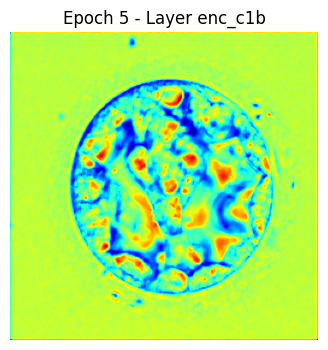

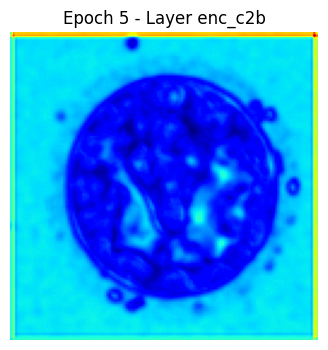

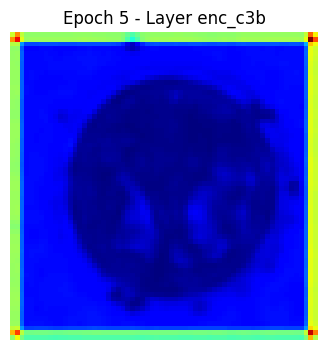

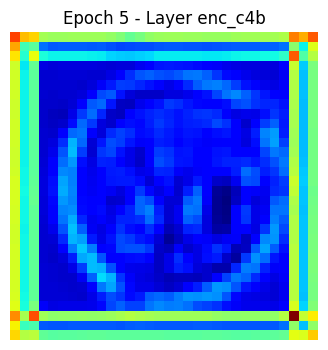

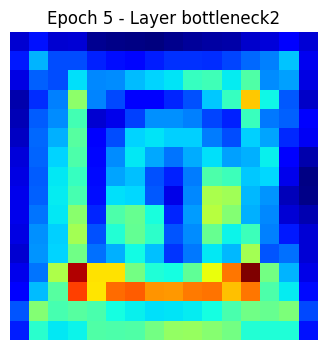

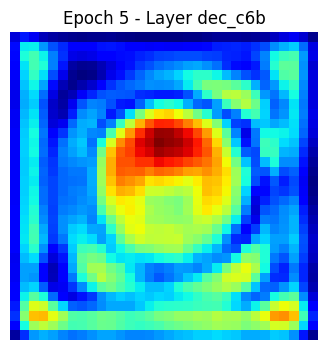

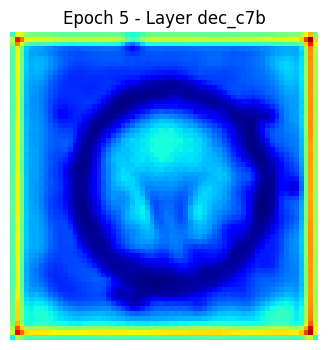

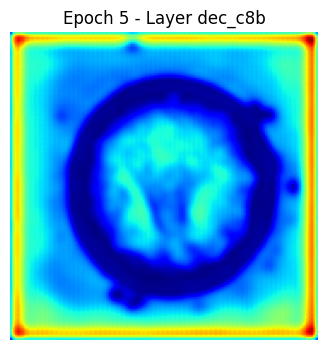

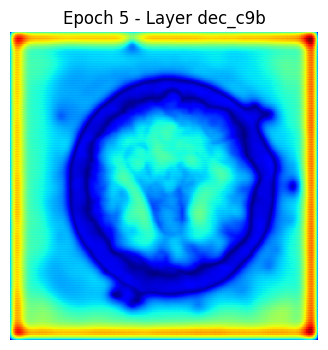

100/100 ━━━━━━━━━━━━━━━━━━━━ 26s 257ms/step - accuracy: 0.8425 - dice_coefficient: 0.7249 - iou_metric: 0.5695 - loss: 0.4342 - val_accuracy: 0.8592 - val_dice_coefficient: 0.7006 - val_iou_metric: 0.5415 - val_loss: 0.4474
Epoch 6/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 24s 238ms/step - accuracy: 0.8481 - dice_coefficient: 0.7435 - iou_metric: 0.5928 - loss: 0.4036 - val_accuracy: 0.8475 - val_dice_coefficient: 0.7472 - val_iou_metric: 0.5989 - val_loss: 0.4122
Epoch 7/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 224ms/step - accuracy: 0.8489 - dice_coefficient: 0.7709 - iou_metric: 0.6281 - loss: 0.3635 - val_accuracy: 0.8490 - val_dice_coefficient: 0.6700 - val_iou_metric: 0.5055 - val_loss: 0.4789
Epoch 8/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 24s 238ms/step - accuracy: 0.8496 - dice_coefficient: 0.7584 - iou_metric: 0.6122 - loss: 0.3818 - val_accuracy: 0.8587 - val_dice_coefficient: 0.7550 - val_iou_metric: 0.6091 - val_loss: 0.3831
Epoch 9/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 24s 238ms/step - accuracy: 

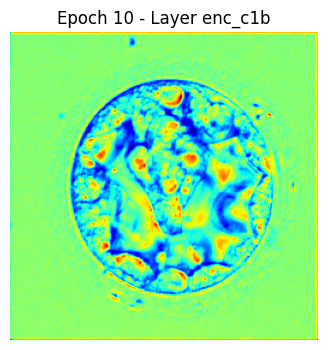

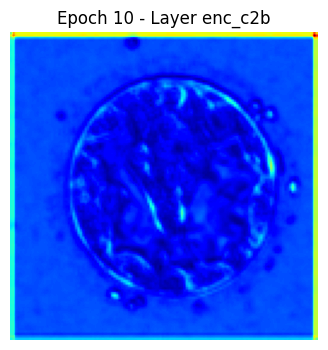

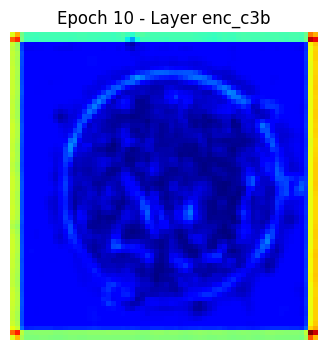

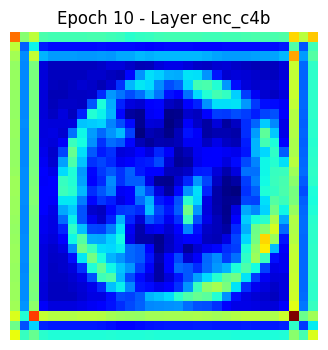

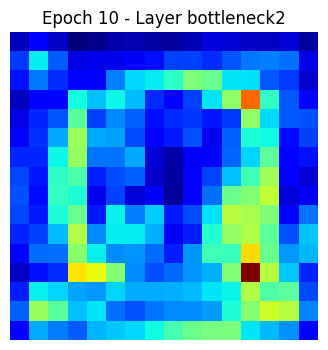

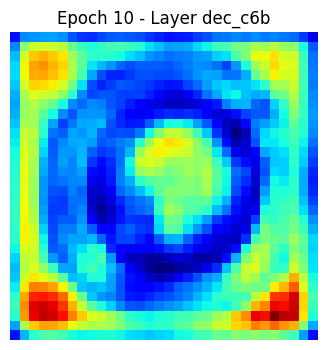

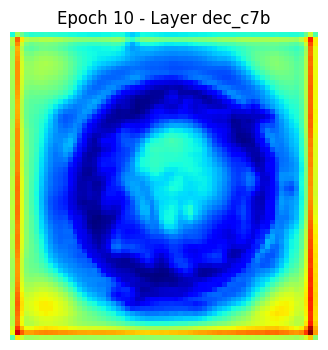

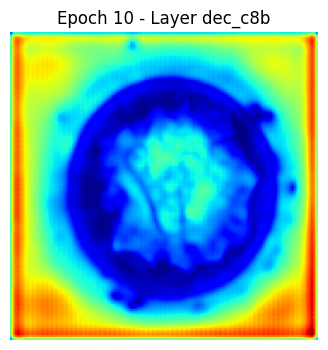

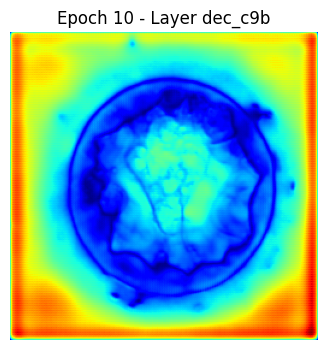

100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 233ms/step - accuracy: 0.8522 - dice_coefficient: 0.7937 - iou_metric: 0.6589 - loss: 0.3312 - val_accuracy: 0.8597 - val_dice_coefficient: 0.7422 - val_iou_metric: 0.5927 - val_loss: 0.3853
Epoch 11/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 224ms/step - accuracy: 0.8534 - dice_coefficient: 0.7971 - iou_metric: 0.6635 - loss: 0.3233 - val_accuracy: 0.8635 - val_dice_coefficient: 0.7343 - val_iou_metric: 0.5826 - val_loss: 0.3851
Epoch 12/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 24s 238ms/step - accuracy: 0.8545 - dice_coefficient: 0.8016 - iou_metric: 0.6699 - loss: 0.3159 - val_accuracy: 0.8576 - val_dice_coefficient: 0.7754 - val_iou_metric: 0.6365 - val_loss: 0.3639
Epoch 13/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 224ms/step - accuracy: 0.8562 - dice_coefficient: 0.8145 - iou_metric: 0.6879 - loss: 0.2945 - val_accuracy: 0.8633 - val_dice_coefficient: 0.7663 - val_iou_metric: 0.6240 - val_loss: 0.3551
Epoch 14/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 24s 238ms/step - accura

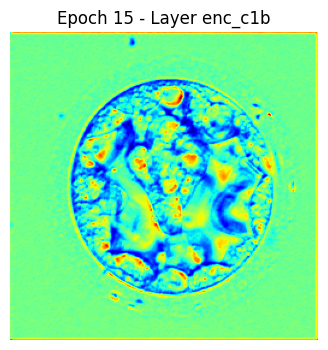

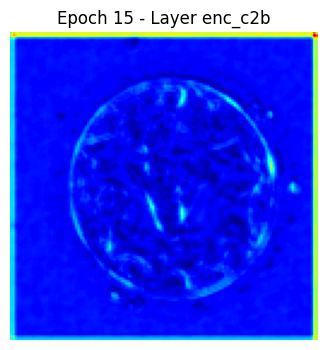

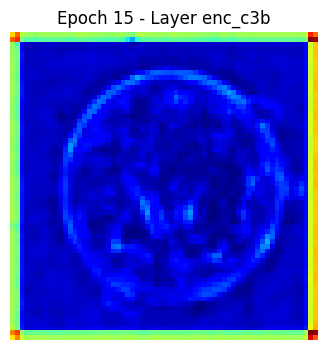

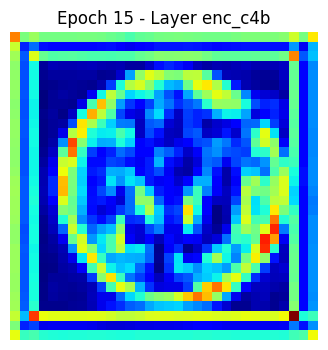

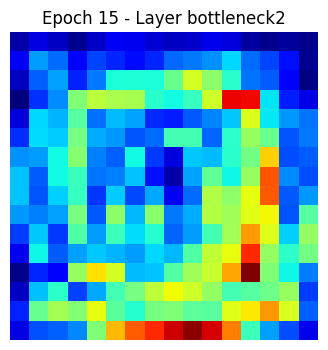

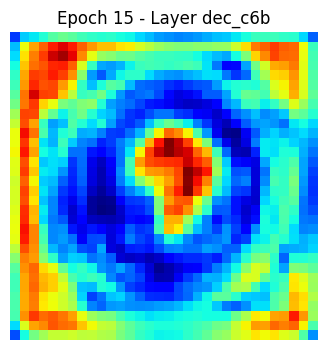

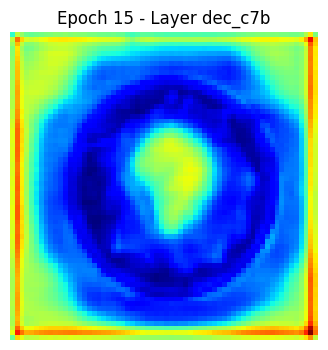

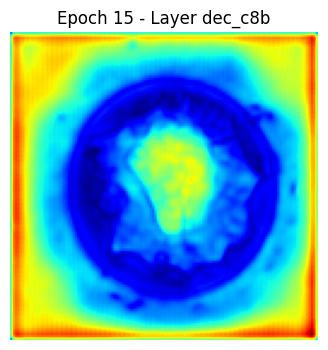

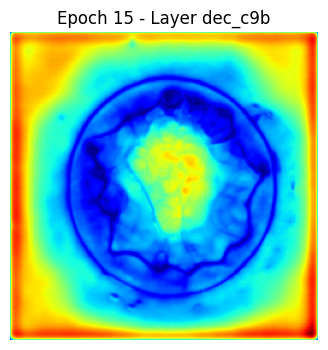

100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 233ms/step - accuracy: 0.8574 - dice_coefficient: 0.8266 - iou_metric: 0.7052 - loss: 0.2767 - val_accuracy: 0.8559 - val_dice_coefficient: 0.7807 - val_iou_metric: 0.6434 - val_loss: 0.3463
Epoch 16/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 24s 237ms/step - accuracy: 0.8573 - dice_coefficient: 0.8332 - iou_metric: 0.7152 - loss: 0.2665 - val_accuracy: 0.8639 - val_dice_coefficient: 0.7885 - val_iou_metric: 0.6544 - val_loss: 0.3357
Epoch 17/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 24s 238ms/step - accuracy: 0.8587 - dice_coefficient: 0.8393 - iou_metric: 0.7241 - loss: 0.2592 - val_accuracy: 0.8655 - val_dice_coefficient: 0.7938 - val_iou_metric: 0.6620 - val_loss: 0.3341
Epoch 18/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 224ms/step - accuracy: 0.8595 - dice_coefficient: 0.8433 - iou_metric: 0.7298 - loss: 0.2523 - val_accuracy: 0.8627 - val_dice_coefficient: 0.7923 - val_iou_metric: 0.6593 - val_loss: 0.3224
Epoch 19/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 24s 238ms/step - accura

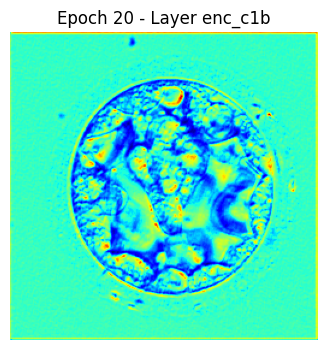

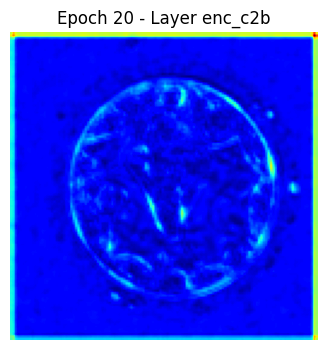

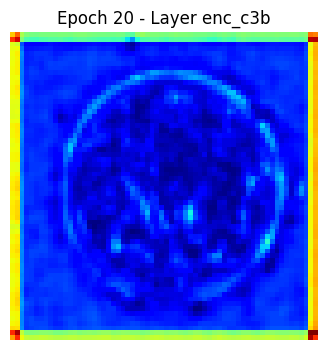

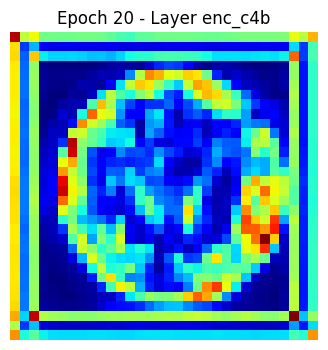

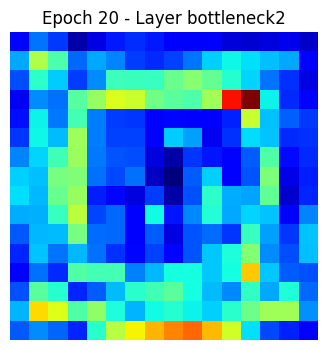

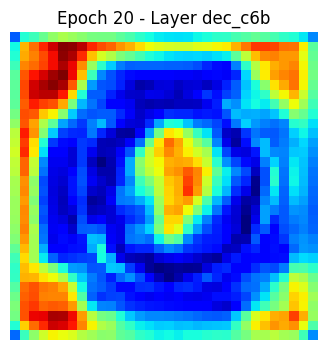

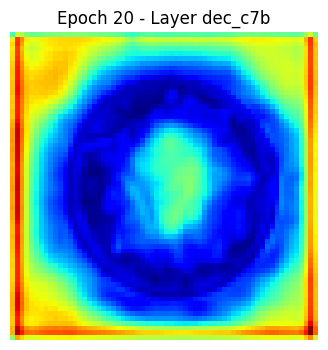

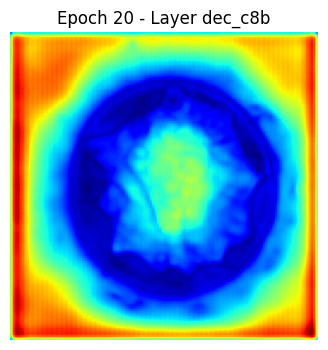

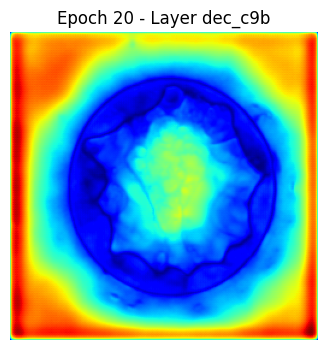

100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 233ms/step - accuracy: 0.8602 - dice_coefficient: 0.8564 - iou_metric: 0.7494 - loss: 0.2357 - val_accuracy: 0.8684 - val_dice_coefficient: 0.7827 - val_iou_metric: 0.6465 - val_loss: 0.3327
Epoch 21/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 224ms/step - accuracy: 0.8616 - dice_coefficient: 0.8567 - iou_metric: 0.7501 - loss: 0.2287 - val_accuracy: 0.8652 - val_dice_coefficient: 0.7849 - val_iou_metric: 0.6490 - val_loss: 0.3320
Epoch 22/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 224ms/step - accuracy: 0.8619 - dice_coefficient: 0.8582 - iou_metric: 0.7524 - loss: 0.2260 - val_accuracy: 0.8682 - val_dice_coefficient: 0.7953 - val_iou_metric: 0.6639 - val_loss: 0.3285
Epoch 23/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 24s 238ms/step - accuracy: 0.8622 - dice_coefficient: 0.8675 - iou_metric: 0.7668 - loss: 0.2136 - val_accuracy: 0.8632 - val_dice_coefficient: 0.8148 - val_iou_metric: 0.6911 - val_loss: 0.3128
Epoch 24/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 224ms/step - accura

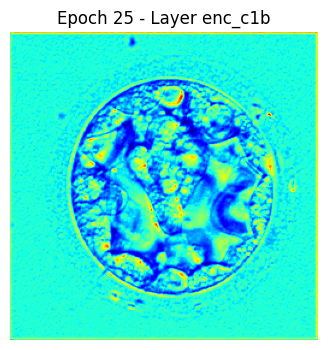

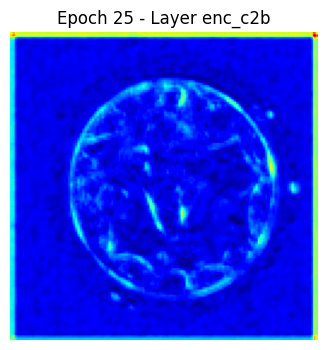

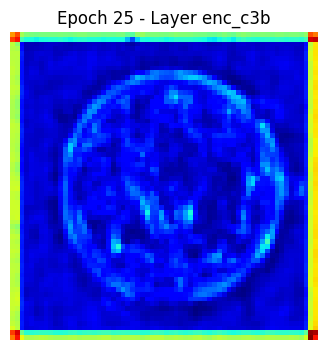

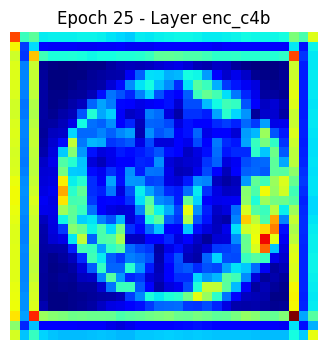

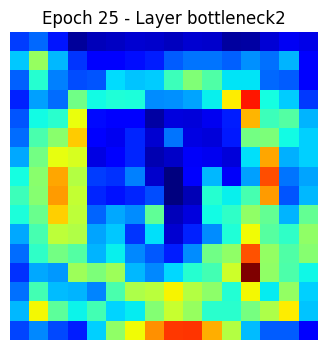

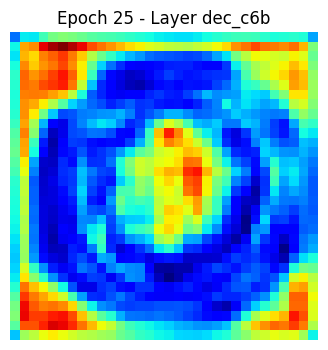

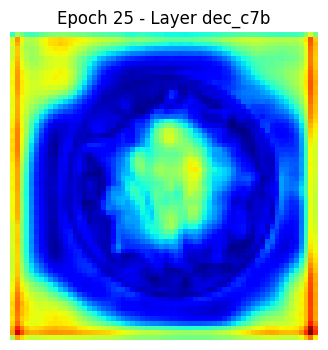

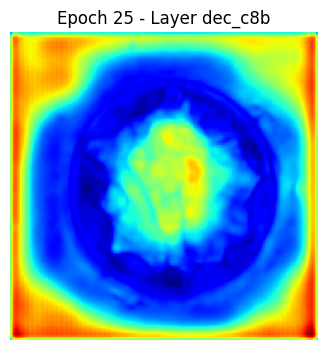

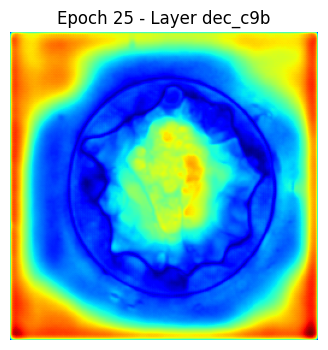

100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 233ms/step - accuracy: 0.8639 - dice_coefficient: 0.8784 - iou_metric: 0.7841 - loss: 0.1983 - val_accuracy: 0.8635 - val_dice_coefficient: 0.7861 - val_iou_metric: 0.6507 - val_loss: 0.3300
Epoch 26/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 224ms/step - accuracy: 0.8645 - dice_coefficient: 0.8761 - iou_metric: 0.7803 - loss: 0.1966 - val_accuracy: 0.8640 - val_dice_coefficient: 0.7993 - val_iou_metric: 0.6695 - val_loss: 0.3304
Epoch 27/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 224ms/step - accuracy: 0.8648 - dice_coefficient: 0.8831 - iou_metric: 0.7913 - loss: 0.1902 - val_accuracy: 0.8647 - val_dice_coefficient: 0.7932 - val_iou_metric: 0.6605 - val_loss: 0.3236
Epoch 28/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 224ms/step - accuracy: 0.8662 - dice_coefficient: 0.8886 - iou_metric: 0.8001 - loss: 0.1797 - val_accuracy: 0.8618 - val_dice_coefficient: 0.8011 - val_iou_metric: 0.6716 - val_loss: 0.3360
Epoch 29/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 224ms/step - accura

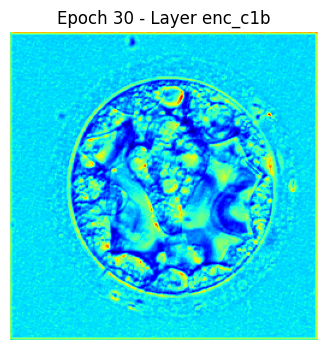

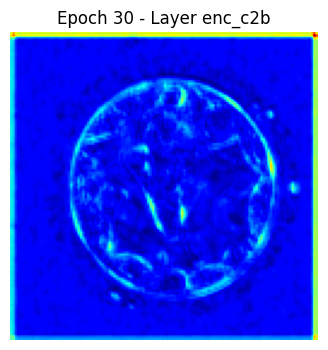

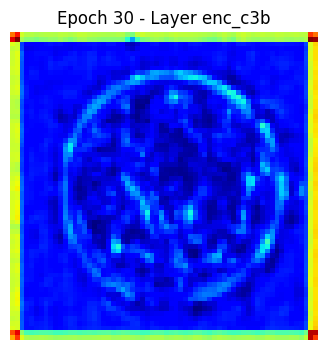

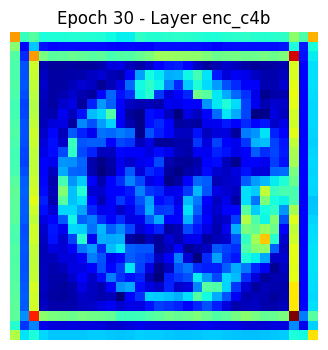

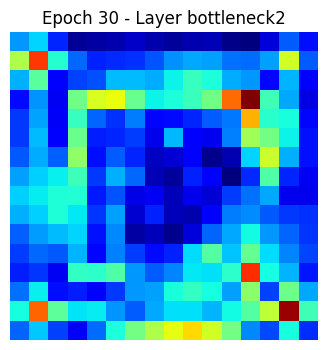

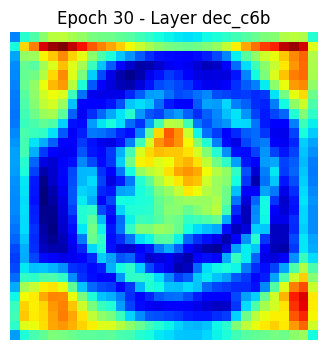

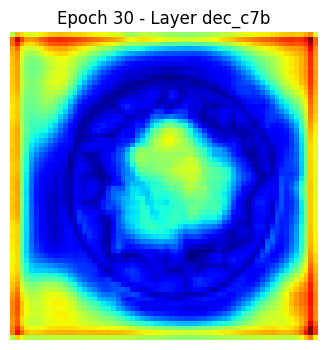

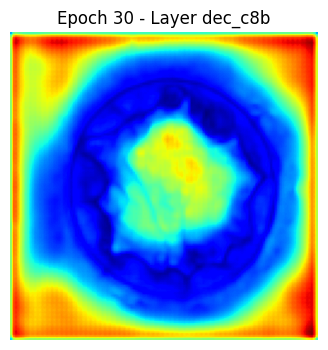

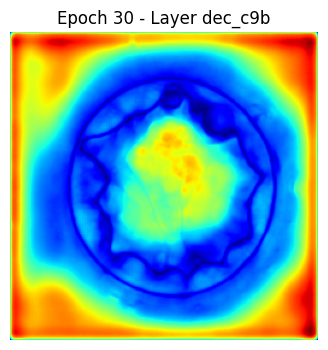

100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 232ms/step - accuracy: 0.8661 - dice_coefficient: 0.8937 - iou_metric: 0.8084 - loss: 0.1720 - val_accuracy: 0.8641 - val_dice_coefficient: 0.8078 - val_iou_metric: 0.6812 - val_loss: 0.3247
Epoch 31/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 223ms/step - accuracy: 0.8672 - dice_coefficient: 0.8979 - iou_metric: 0.8155 - loss: 0.1636 - val_accuracy: 0.8643 - val_dice_coefficient: 0.7999 - val_iou_metric: 0.6701 - val_loss: 0.3383
Epoch 32/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 223ms/step - accuracy: 0.8679 - dice_coefficient: 0.9014 - iou_metric: 0.8211 - loss: 0.1577 - val_accuracy: 0.8636 - val_dice_coefficient: 0.7831 - val_iou_metric: 0.6463 - val_loss: 0.3680
Epoch 33/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 223ms/step - accuracy: 0.8675 - dice_coefficient: 0.9039 - iou_metric: 0.8252 - loss: 0.1532 - val_accuracy: 0.8660 - val_dice_coefficient: 0.8014 - val_iou_metric: 0.6725 - val_loss: 0.3539


Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer         │ (None, 256, 256,  │          0 │ -                 │
│ (InputLayer)        │ 1)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c1a (Conv2D)    │ (None, 256, 256,  │        640 │ input_layer[0][0] │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c1b (Conv2D)    │ (None, 256, 256,  │     36,928 │ enc_c1a[0][0]     │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool1               │ (None, 128, 128,  │          0 │ enc_c1b[0][0]     │
│ (MaxPooling2D)      │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c2a (Conv2D)    │ (None, 128, 128,  │     73,856 │ pool1[0][0]       │
│                     │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c2b (Conv2D)    │ (None, 128, 128,  │    147,584 │ enc_c2a[0][0]     │
│                     │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool2               │ (None, 64, 64,    │          0 │ enc_c2b[0][0]     │
│ (MaxPooling2D)      │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c3a (Conv2D)    │ (None, 64, 64,    │    295,168 │ pool2[0][0]       │
│                     │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c3b (Conv2D)    │ (None, 64, 64,    │    590,080 │ enc_c3a[0][0]     │
│                     │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool3               │ (None, 32, 32,    │          0 │ enc_c3b[0][0]     │
│ (MaxPooling2D)      │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c4a (Conv2D)    │ (None, 32, 32,    │  1,180,160 │ pool3[0][0]       │
│                     │ 512)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c4b (Conv2D)    │ (None, 32, 32,    │  2,359,808 │ enc_c4a[0][0]     │
│                     │ 512)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool4               │ (None, 16, 16,    │          0 │ enc_c4b[0][0]     │
│ (MaxPooling2D)      │ 512)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ bottleneck1         │ (None, 16, 16,    │  4,719,616 │ pool4[0][0]       │
│ (Conv2D)            │ 1024)             │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ bottleneck2         │ (None, 16, 16,    │  9,438,208 │ bottleneck1[0][0] │
│ (Conv2D)            │ 1024)             │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dec6_up             │ (None, 32, 32,    │  2,097,664 │ bottleneck2[0][0] │
│ (Conv2DTranspose)   │ 512)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dec6_att            │ (None, 32, 32,    │         99 │ enc_c4b[0][0]   

 Total params: 93,092,969 (355.12 MB)

 Trainable params: 31,030,989 (118.37 MB)

 Non-trainable params: 0 (0.00 B)

 Optimizer params: 62,061,980 (236.75 MB)

GFLOPs calculation not available, use tensorflow profiler for exact computation.
Training time for fold 1: 840.12s

--- Fold 2 ---
Epoch 1/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 49s 310ms/step - accuracy: 0.8017 - dice_coefficient: 0.1863 - iou_metric: 0.1037 - loss: 1.3094 - val_accuracy: 0.8406 - val_dice_coefficient: 0.5112 - val_iou_metric: 0.3440 - val_loss: 0.6750
Epoch 2/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 224ms/step - accuracy: 0.8258 - dice_coefficient: 0.6014 - iou_metric: 0.4325 - loss: 0.6106 - val_accuracy: 0.8491 - val_dice_coefficient: 0.6682 - val_iou_metric: 0.5038 - val_loss: 0.5126
Epoch 3/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 225ms/step - accuracy: 0.8392 - dice_coefficient: 0.6851 - iou_metric: 0.5220 - loss: 0.4960 - val_accuracy: 0.8405 - val_dice_coefficient: 0.6936 - val_iou_metric: 0.5329 - val_loss: 0.4712
Epoch 4/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 224ms/step - accuracy: 0.8435 - dice_coefficient: 0.7246 - iou_metric: 0.5690 - loss: 0.4326 - val_accuracy: 0.8516 

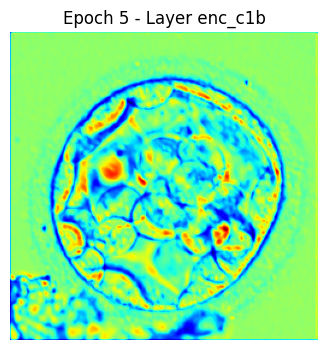

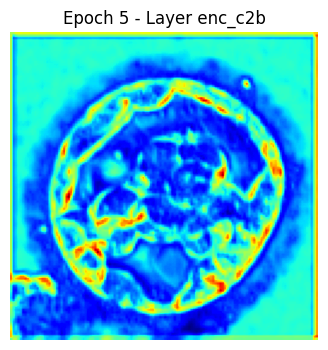

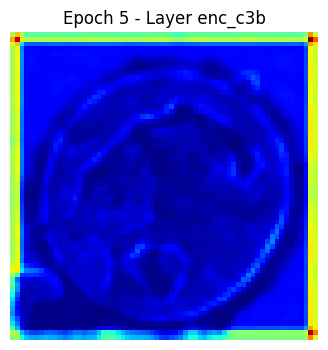

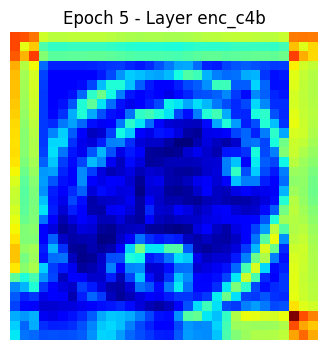

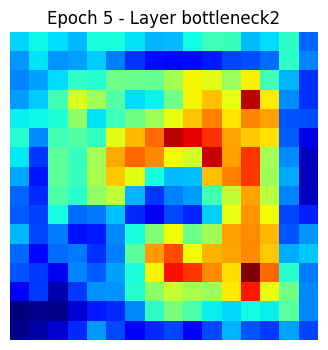

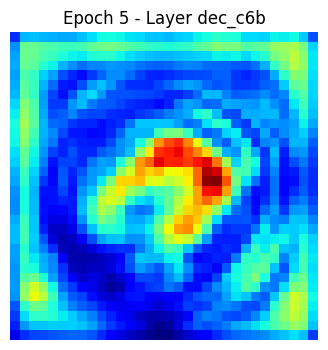

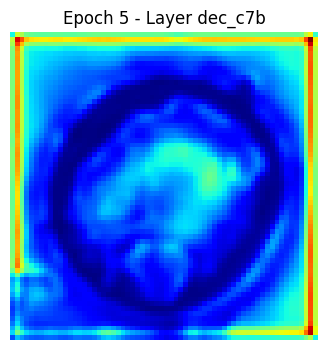

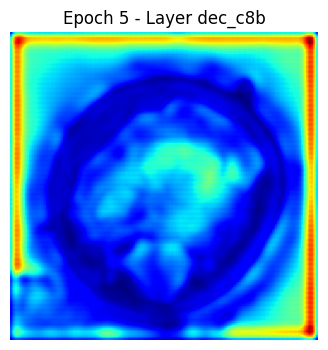

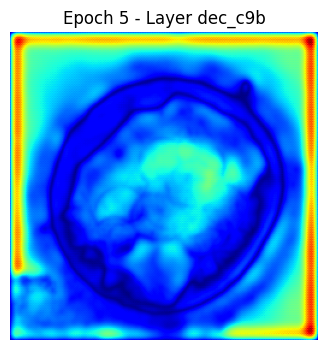

100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 231ms/step - accuracy: 0.8487 - dice_coefficient: 0.7513 - iou_metric: 0.6027 - loss: 0.3925 - val_accuracy: 0.8567 - val_dice_coefficient: 0.7086 - val_iou_metric: 0.5511 - val_loss: 0.4176
Epoch 6/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 224ms/step - accuracy: 0.8499 - dice_coefficient: 0.7619 - iou_metric: 0.6163 - loss: 0.3754 - val_accuracy: 0.8584 - val_dice_coefficient: 0.7356 - val_iou_metric: 0.5847 - val_loss: 0.3892
Epoch 7/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 224ms/step - accuracy: 0.8526 - dice_coefficient: 0.7748 - iou_metric: 0.6333 - loss: 0.3552 - val_accuracy: 0.8619 - val_dice_coefficient: 0.7742 - val_iou_metric: 0.6355 - val_loss: 0.3540
Epoch 8/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 224ms/step - accuracy: 0.8537 - dice_coefficient: 0.7883 - iou_metric: 0.6513 - loss: 0.3341 - val_accuracy: 0.8602 - val_dice_coefficient: 0.7774 - val_iou_metric: 0.6396 - val_loss: 0.3387
Epoch 9/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 224ms/step - accuracy: 

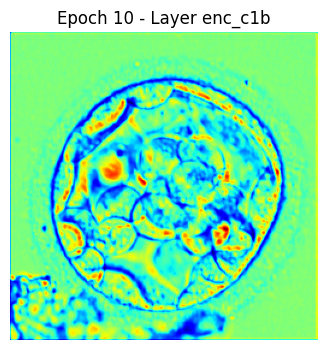

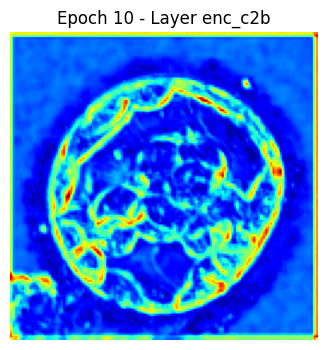

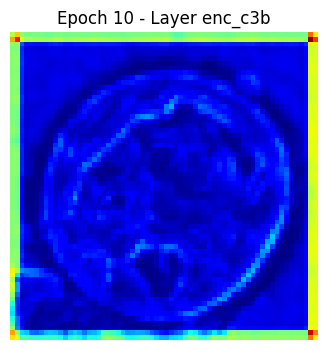

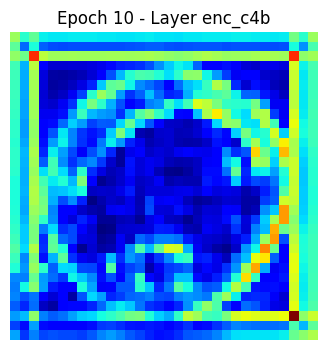

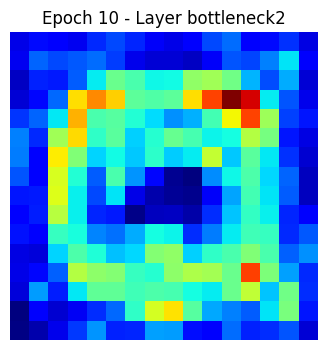

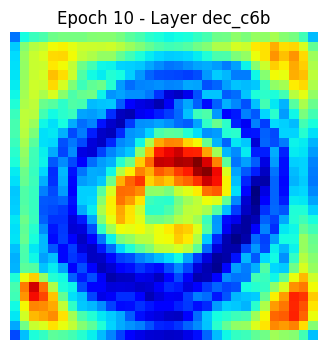

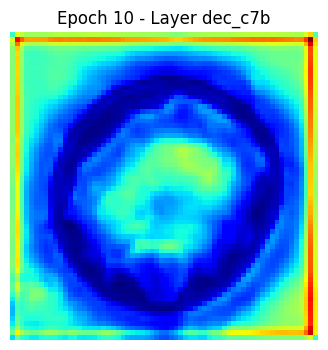

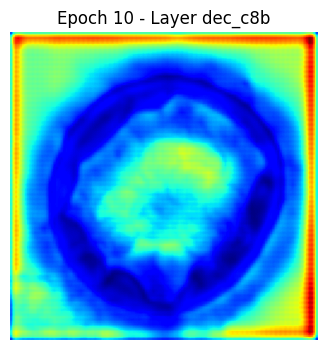

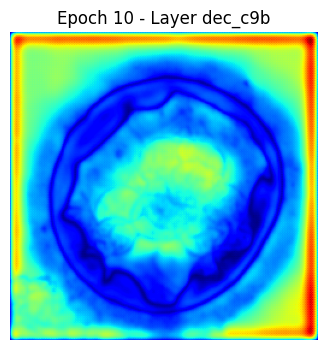

100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 232ms/step - accuracy: 0.8556 - dice_coefficient: 0.7999 - iou_metric: 0.6676 - loss: 0.3142 - val_accuracy: 0.8611 - val_dice_coefficient: 0.7908 - val_iou_metric: 0.6579 - val_loss: 0.3265
Epoch 11/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 223ms/step - accuracy: 0.8576 - dice_coefficient: 0.8185 - iou_metric: 0.6936 - loss: 0.2905 - val_accuracy: 0.8608 - val_dice_coefficient: 0.7896 - val_iou_metric: 0.6566 - val_loss: 0.3188
Epoch 12/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 224ms/step - accuracy: 0.8576 - dice_coefficient: 0.8227 - iou_metric: 0.6997 - loss: 0.2806 - val_accuracy: 0.8610 - val_dice_coefficient: 0.8025 - val_iou_metric: 0.6744 - val_loss: 0.3129
Epoch 13/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 224ms/step - accuracy: 0.8581 - dice_coefficient: 0.8244 - iou_metric: 0.7020 - loss: 0.2784 - val_accuracy: 0.8634 - val_dice_coefficient: 0.8061 - val_iou_metric: 0.6796 - val_loss: 0.3044
Epoch 14/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 223ms/step - accura

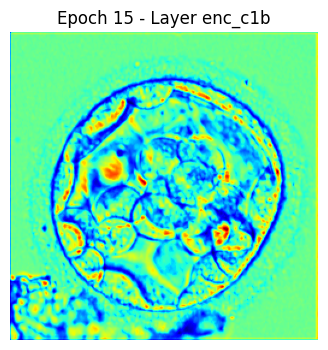

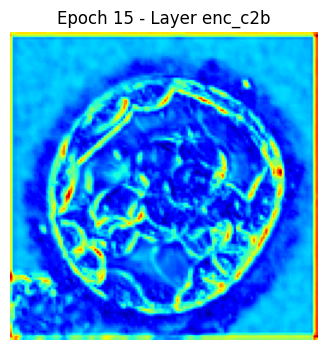

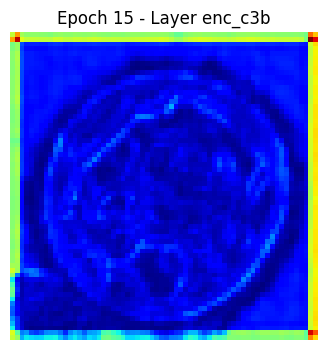

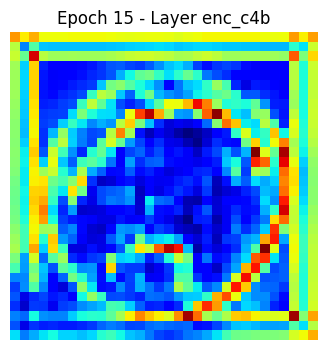

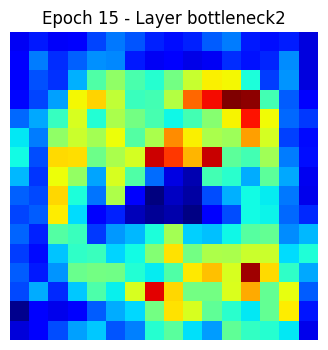

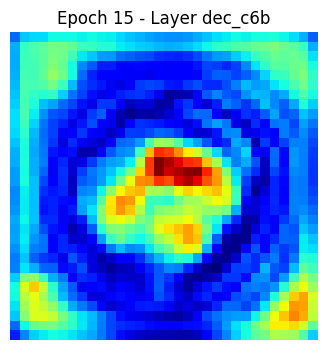

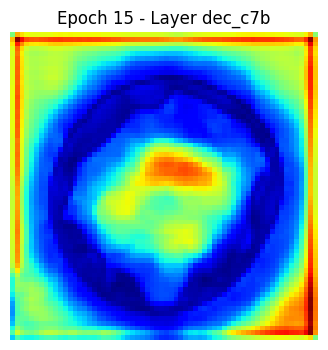

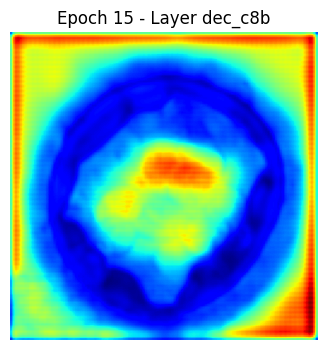

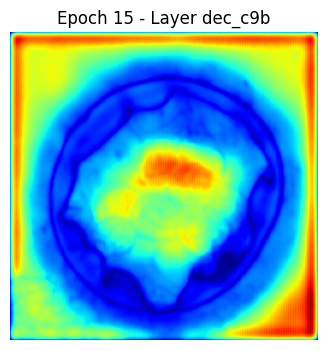

100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 232ms/step - accuracy: 0.8604 - dice_coefficient: 0.8414 - iou_metric: 0.7272 - loss: 0.2529 - val_accuracy: 0.8648 - val_dice_coefficient: 0.8110 - val_iou_metric: 0.6867 - val_loss: 0.2980
Epoch 16/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 223ms/step - accuracy: 0.8614 - dice_coefficient: 0.8516 - iou_metric: 0.7424 - loss: 0.2383 - val_accuracy: 0.8649 - val_dice_coefficient: 0.7918 - val_iou_metric: 0.6594 - val_loss: 0.3145
Epoch 17/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 224ms/step - accuracy: 0.8620 - dice_coefficient: 0.8508 - iou_metric: 0.7414 - loss: 0.2373 - val_accuracy: 0.8654 - val_dice_coefficient: 0.8142 - val_iou_metric: 0.6913 - val_loss: 0.2957
Epoch 18/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 223ms/step - accuracy: 0.8633 - dice_coefficient: 0.8627 - iou_metric: 0.7593 - loss: 0.2212 - val_accuracy: 0.8651 - val_dice_coefficient: 0.8039 - val_iou_metric: 0.6766 - val_loss: 0.3026
Epoch 19/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 223ms/step - accura

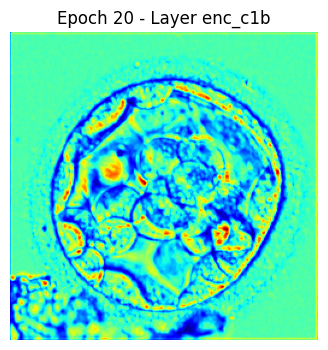

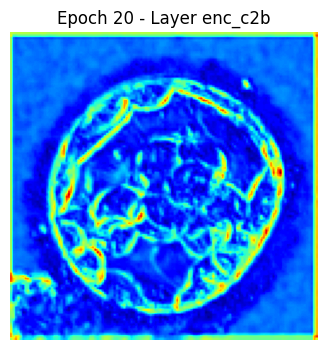

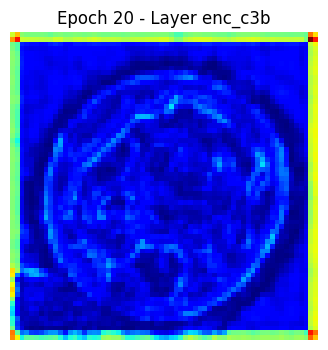

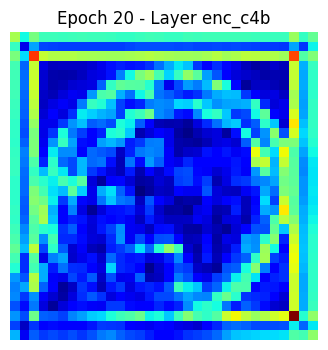

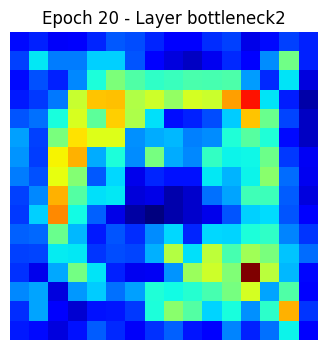

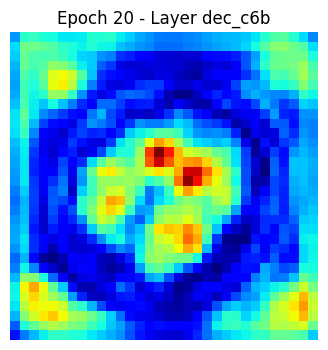

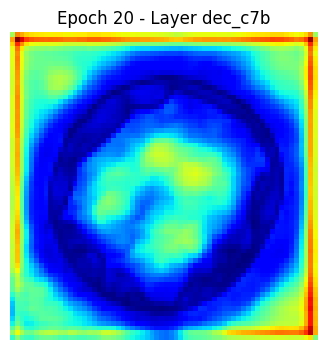

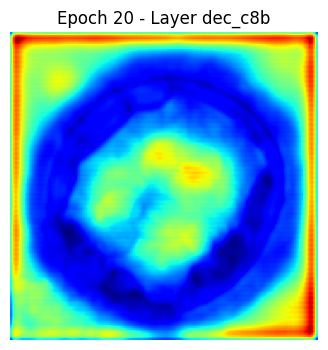

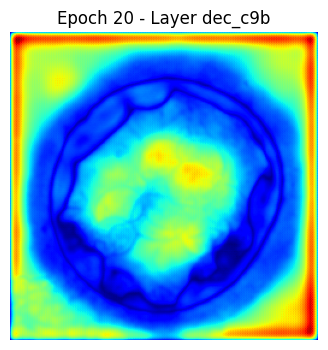

100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 232ms/step - accuracy: 0.8644 - dice_coefficient: 0.8699 - iou_metric: 0.7705 - loss: 0.2084 - val_accuracy: 0.8661 - val_dice_coefficient: 0.8144 - val_iou_metric: 0.6916 - val_loss: 0.2996
Epoch 21/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 223ms/step - accuracy: 0.8648 - dice_coefficient: 0.8724 - iou_metric: 0.7744 - loss: 0.2037 - val_accuracy: 0.8672 - val_dice_coefficient: 0.7807 - val_iou_metric: 0.6442 - val_loss: 0.3373
Epoch 22/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 24s 235ms/step - accuracy: 0.8652 - dice_coefficient: 0.8771 - iou_metric: 0.7819 - loss: 0.1964 - val_accuracy: 0.8681 - val_dice_coefficient: 0.8193 - val_iou_metric: 0.6990 - val_loss: 0.3255
Epoch 23/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 223ms/step - accuracy: 0.8670 - dice_coefficient: 0.8865 - iou_metric: 0.7967 - loss: 0.1848 - val_accuracy: 0.8595 - val_dice_coefficient: 0.7932 - val_iou_metric: 0.6611 - val_loss: 0.3312
Epoch 24/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 223ms/step - accura

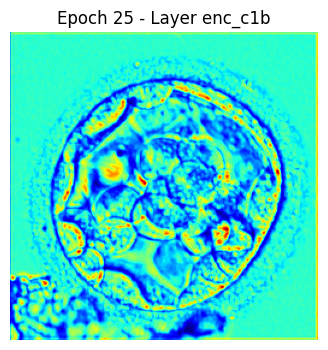

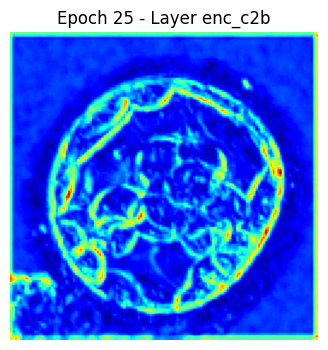

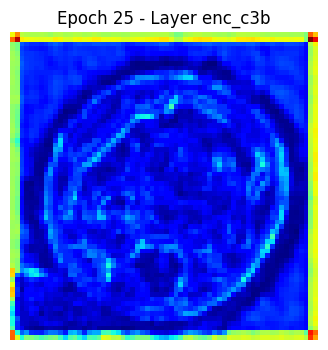

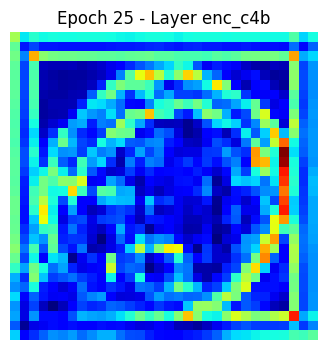

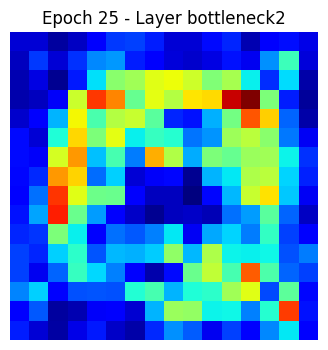

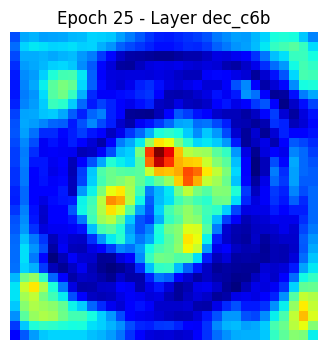

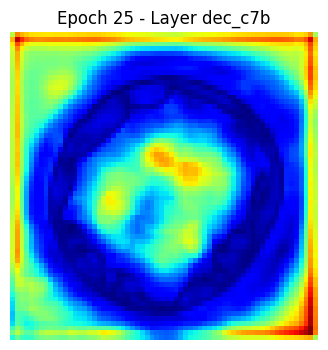

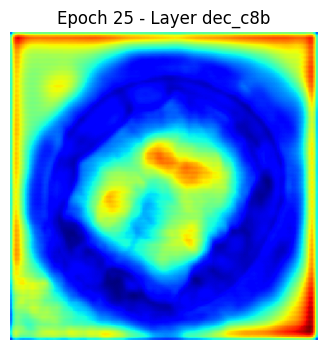

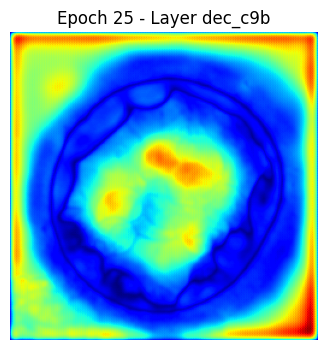

100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 231ms/step - accuracy: 0.8674 - dice_coefficient: 0.8948 - iou_metric: 0.8101 - loss: 0.1694 - val_accuracy: 0.8663 - val_dice_coefficient: 0.8076 - val_iou_metric: 0.6820 - val_loss: 0.3174
Epoch 26/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 223ms/step - accuracy: 0.8675 - dice_coefficient: 0.8958 - iou_metric: 0.8118 - loss: 0.1665 - val_accuracy: 0.8666 - val_dice_coefficient: 0.8081 - val_iou_metric: 0.6825 - val_loss: 0.3149
Epoch 27/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 223ms/step - accuracy: 0.8682 - dice_coefficient: 0.9006 - iou_metric: 0.8198 - loss: 0.1583 - val_accuracy: 0.8685 - val_dice_coefficient: 0.8110 - val_iou_metric: 0.6869 - val_loss: 0.3140
Epoch 28/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 223ms/step - accuracy: 0.8691 - dice_coefficient: 0.9072 - iou_metric: 0.8306 - loss: 0.1478 - val_accuracy: 0.8660 - val_dice_coefficient: 0.8088 - val_iou_metric: 0.6834 - val_loss: 0.3158
Epoch 29/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 223ms/step - accura

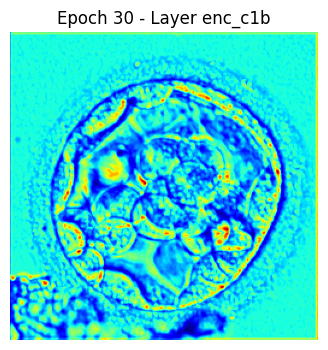

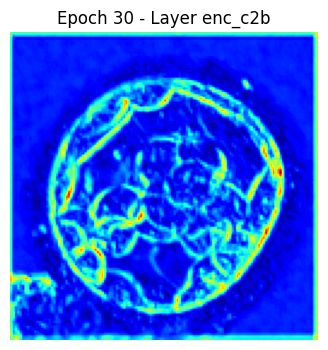

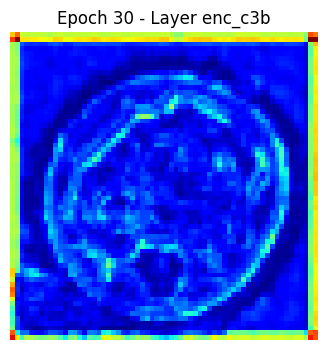

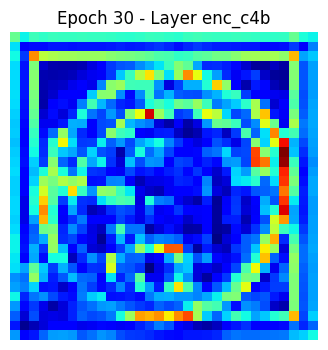

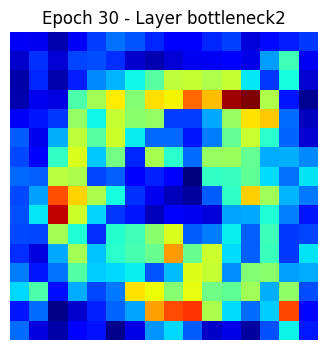

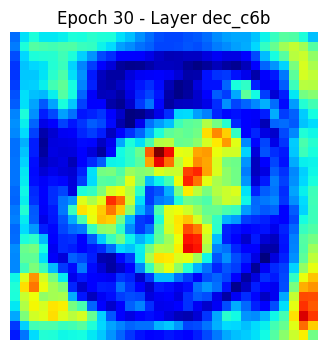

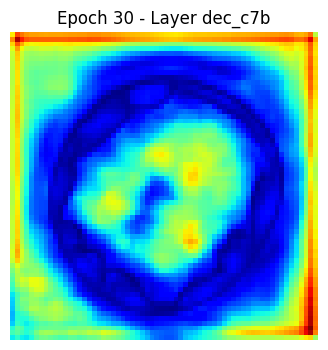

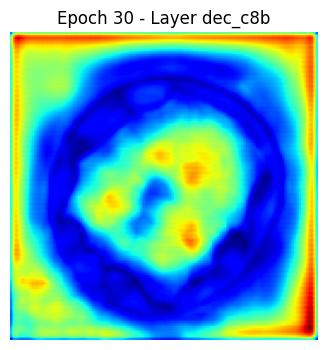

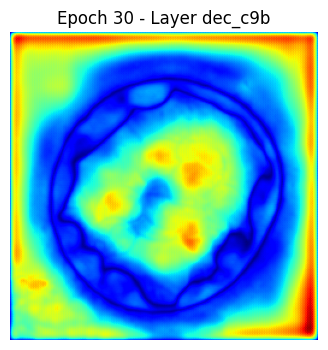

100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 230ms/step - accuracy: 0.8703 - dice_coefficient: 0.9104 - iou_metric: 0.8360 - loss: 0.1421 - val_accuracy: 0.8683 - val_dice_coefficient: 0.8110 - val_iou_metric: 0.6870 - val_loss: 0.3353
Epoch 31/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 24s 235ms/step - accuracy: 0.8701 - dice_coefficient: 0.9126 - iou_metric: 0.8397 - loss: 0.1385 - val_accuracy: 0.8663 - val_dice_coefficient: 0.8240 - val_iou_metric: 0.7053 - val_loss: 0.3220
Epoch 32/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 223ms/step - accuracy: 0.8694 - dice_coefficient: 0.9115 - iou_metric: 0.8377 - loss: 0.1407 - val_accuracy: 0.8679 - val_dice_coefficient: 0.8139 - val_iou_metric: 0.6909 - val_loss: 0.3301
Epoch 33/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 24s 236ms/step - accuracy: 0.8705 - dice_coefficient: 0.9175 - iou_metric: 0.8480 - loss: 0.1312 - val_accuracy: 0.8662 - val_dice_coefficient: 0.8306 - val_iou_metric: 0.7154 - val_loss: 0.3178
Epoch 34/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 223ms/step - accura

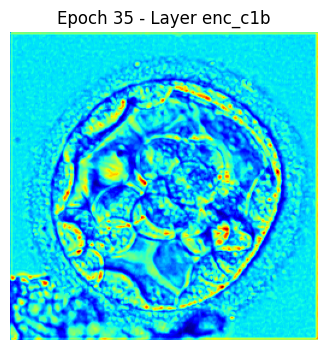

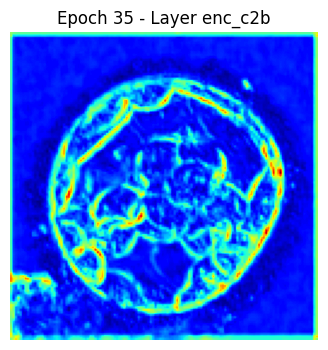

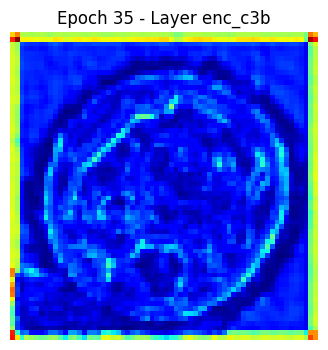

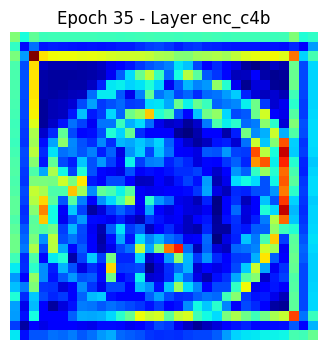

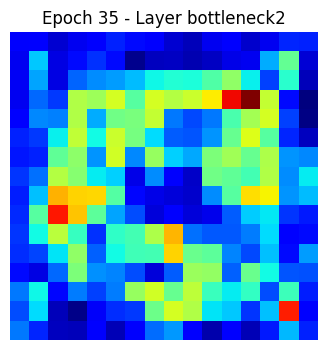

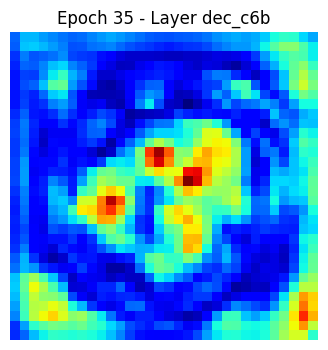

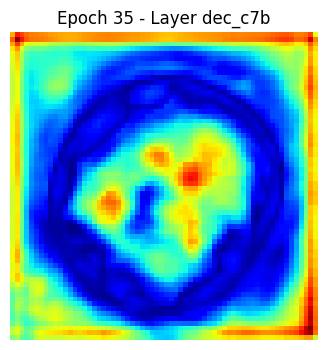

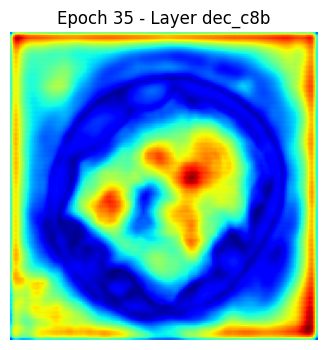

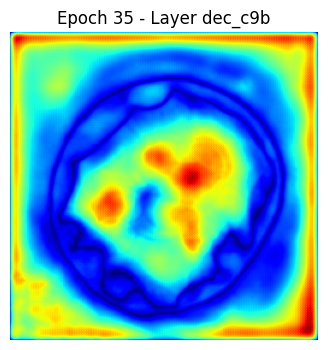

100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 230ms/step - accuracy: 0.8719 - dice_coefficient: 0.9249 - iou_metric: 0.8606 - loss: 0.1188 - val_accuracy: 0.8638 - val_dice_coefficient: 0.8218 - val_iou_metric: 0.7020 - val_loss: 0.3360
Epoch 36/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 223ms/step - accuracy: 0.8711 - dice_coefficient: 0.9282 - iou_metric: 0.8661 - loss: 0.1134 - val_accuracy: 0.8658 - val_dice_coefficient: 0.8262 - val_iou_metric: 0.7089 - val_loss: 0.3377
Epoch 37/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 223ms/step - accuracy: 0.8723 - dice_coefficient: 0.9286 - iou_metric: 0.8670 - loss: 0.1124 - val_accuracy: 0.8670 - val_dice_coefficient: 0.8149 - val_iou_metric: 0.6929 - val_loss: 0.3493
Epoch 38/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 24s 235ms/step - accuracy: 0.8711 - dice_coefficient: 0.9272 - iou_metric: 0.8645 - loss: 0.1167 - val_accuracy: 0.8656 - val_dice_coefficient: 0.8319 - val_iou_metric: 0.7172 - val_loss: 0.3210
Epoch 39/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 24s 236ms/step - accura

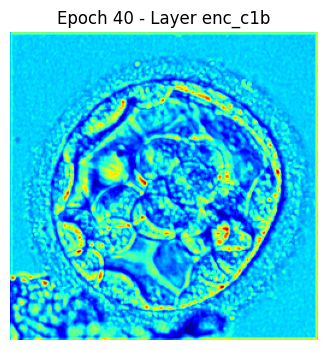

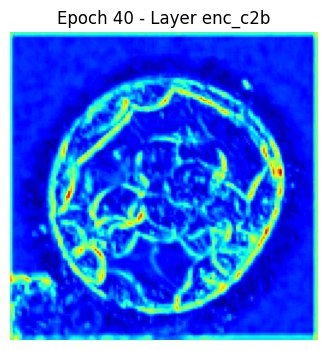

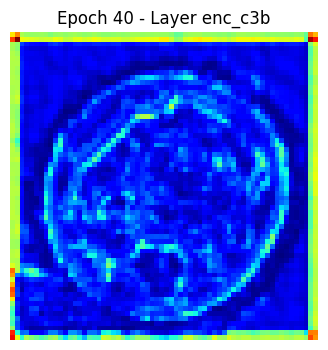

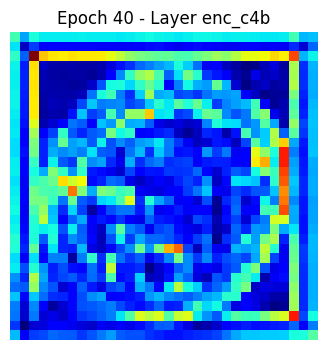

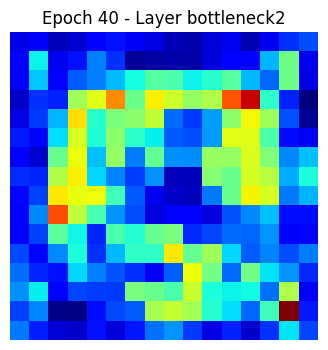

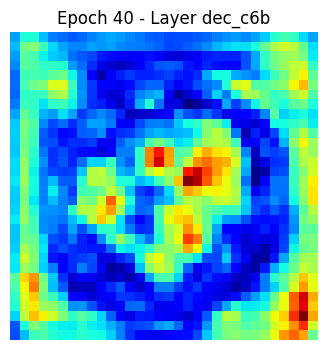

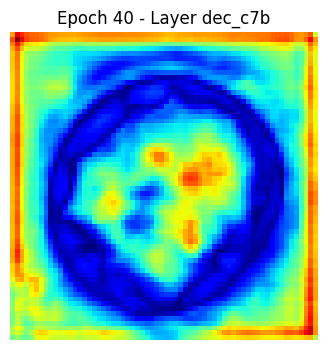

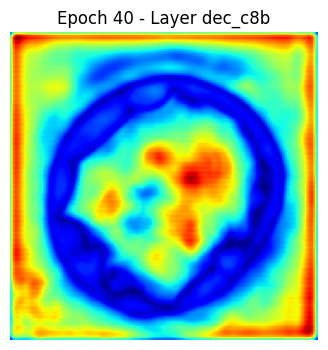

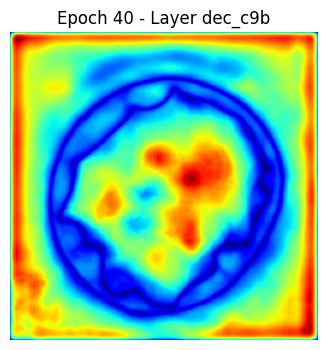

100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 231ms/step - accuracy: 0.8716 - dice_coefficient: 0.9389 - iou_metric: 0.8849 - loss: 0.0973 - val_accuracy: 0.8648 - val_dice_coefficient: 0.8367 - val_iou_metric: 0.7246 - val_loss: 0.3521
Epoch 41/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 223ms/step - accuracy: 0.8736 - dice_coefficient: 0.9420 - iou_metric: 0.8905 - loss: 0.0913 - val_accuracy: 0.8673 - val_dice_coefficient: 0.8313 - val_iou_metric: 0.7168 - val_loss: 0.3533
Epoch 42/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 24s 235ms/step - accuracy: 0.8737 - dice_coefficient: 0.9439 - iou_metric: 0.8938 - loss: 0.0882 - val_accuracy: 0.8679 - val_dice_coefficient: 0.8399 - val_iou_metric: 0.7296 - val_loss: 0.3548
Epoch 43/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 223ms/step - accuracy: 0.8742 - dice_coefficient: 0.9478 - iou_metric: 0.9009 - loss: 0.0820 - val_accuracy: 0.8652 - val_dice_coefficient: 0.8368 - val_iou_metric: 0.7247 - val_loss: 0.3441
Epoch 44/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 24s 235ms/step - accura

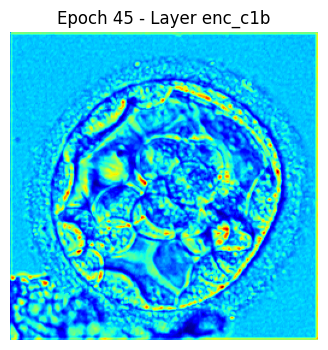

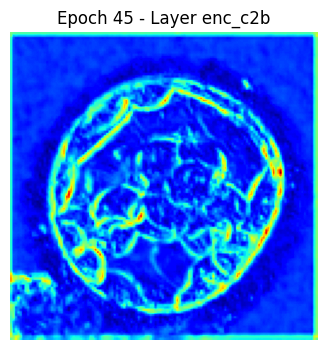

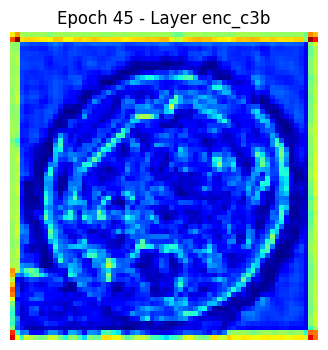

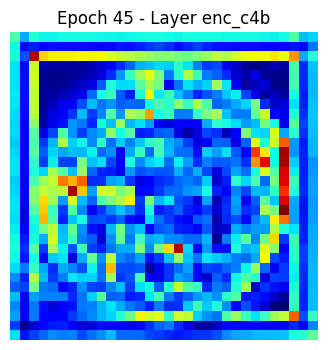

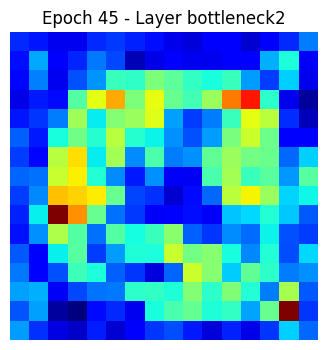

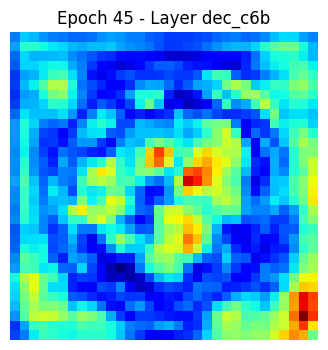

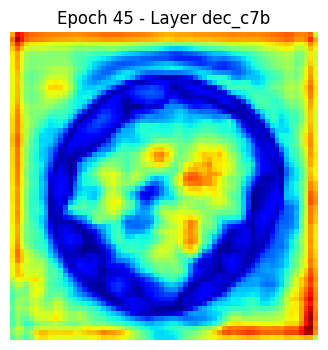

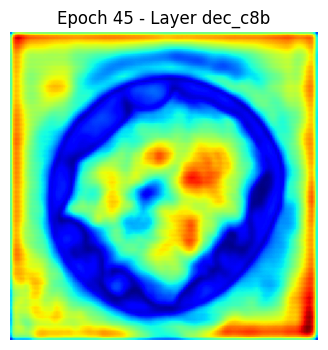

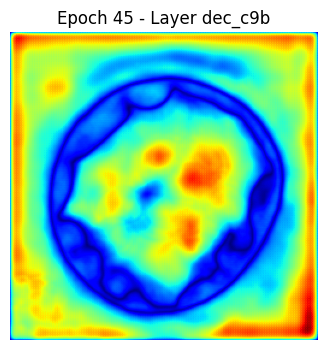

100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 231ms/step - accuracy: 0.8739 - dice_coefficient: 0.9525 - iou_metric: 0.9093 - loss: 0.0749 - val_accuracy: 0.8674 - val_dice_coefficient: 0.8435 - val_iou_metric: 0.7350 - val_loss: 0.3619
Epoch 46/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 223ms/step - accuracy: 0.8741 - dice_coefficient: 0.9548 - iou_metric: 0.9136 - loss: 0.0710 - val_accuracy: 0.8661 - val_dice_coefficient: 0.8424 - val_iou_metric: 0.7332 - val_loss: 0.3722
Epoch 47/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 223ms/step - accuracy: 0.8745 - dice_coefficient: 0.9562 - iou_metric: 0.9162 - loss: 0.0686 - val_accuracy: 0.8651 - val_dice_coefficient: 0.8435 - val_iou_metric: 0.7348 - val_loss: 0.3619
Epoch 48/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 24s 235ms/step - accuracy: 0.8751 - dice_coefficient: 0.9577 - iou_metric: 0.9188 - loss: 0.0661 - val_accuracy: 0.8669 - val_dice_coefficient: 0.8456 - val_iou_metric: 0.7382 - val_loss: 0.3769
Epoch 49/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 222ms/step - accura

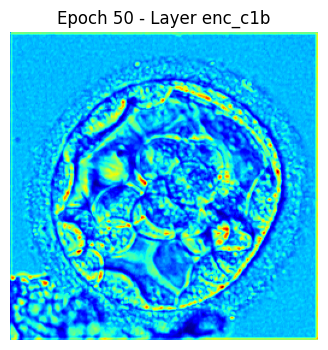

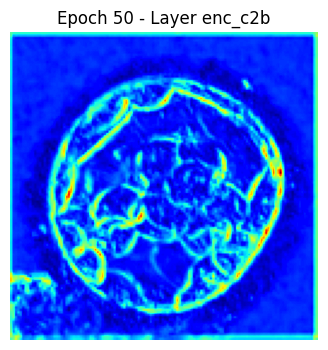

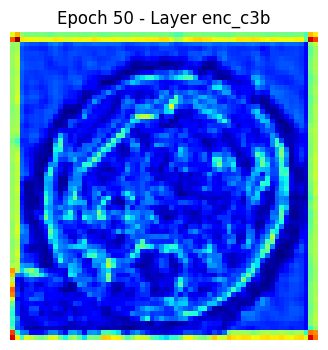

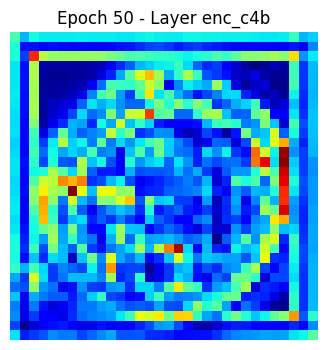

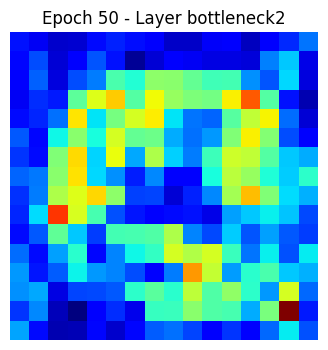

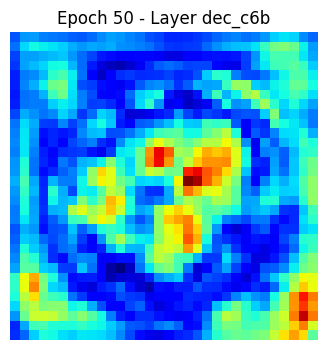

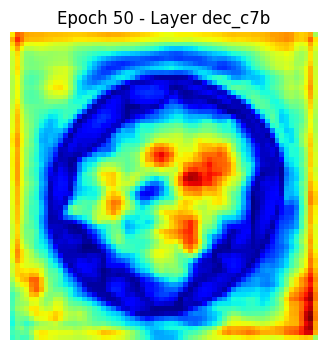

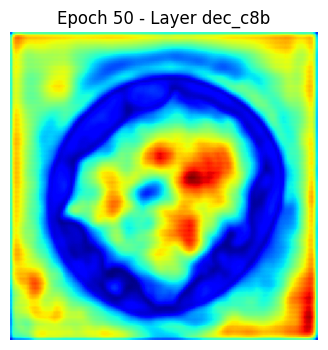

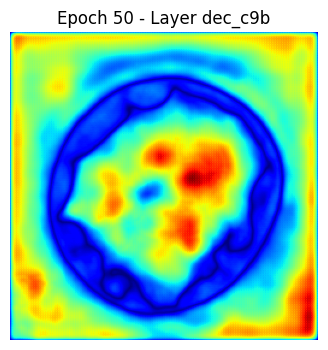

100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 230ms/step - accuracy: 0.8750 - dice_coefficient: 0.9605 - iou_metric: 0.9240 - loss: 0.0619 - val_accuracy: 0.8675 - val_dice_coefficient: 0.8435 - val_iou_metric: 0.7351 - val_loss: 0.3933
Epoch 51/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 222ms/step - accuracy: 0.8753 - dice_coefficient: 0.9628 - iou_metric: 0.9283 - loss: 0.0583 - val_accuracy: 0.8662 - val_dice_coefficient: 0.8455 - val_iou_metric: 0.7379 - val_loss: 0.3754
Epoch 52/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 24s 235ms/step - accuracy: 0.8743 - dice_coefficient: 0.9637 - iou_metric: 0.9300 - loss: 0.0567 - val_accuracy: 0.8672 - val_dice_coefficient: 0.8465 - val_iou_metric: 0.7397 - val_loss: 0.3956
Epoch 53/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 24s 235ms/step - accuracy: 0.8751 - dice_coefficient: 0.9656 - iou_metric: 0.9335 - loss: 0.0540 - val_accuracy: 0.8663 - val_dice_coefficient: 0.8493 - val_iou_metric: 0.7438 - val_loss: 0.3963
Epoch 54/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 223ms/step - accura

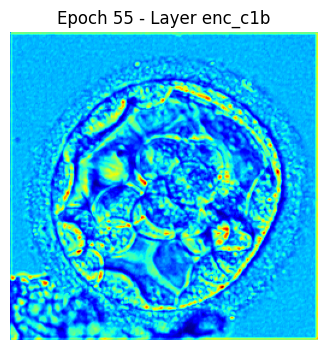

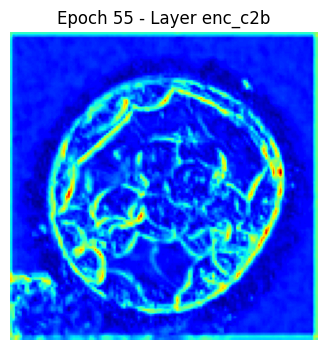

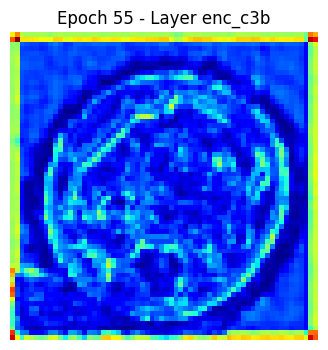

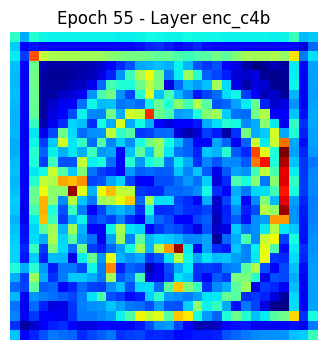

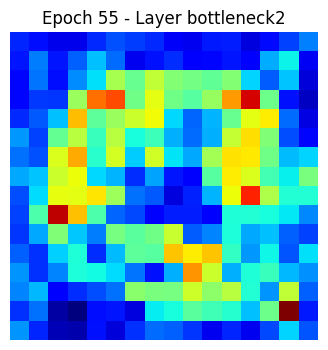

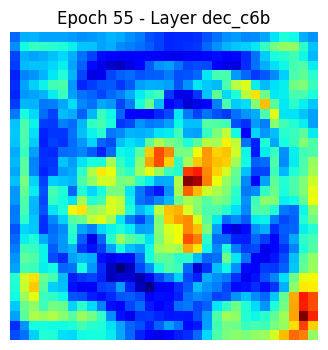

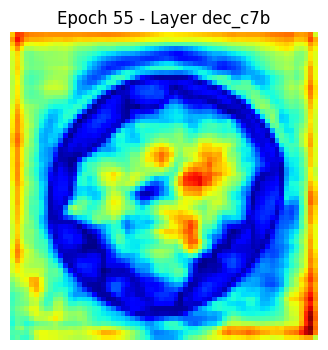

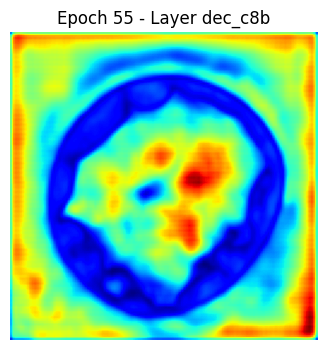

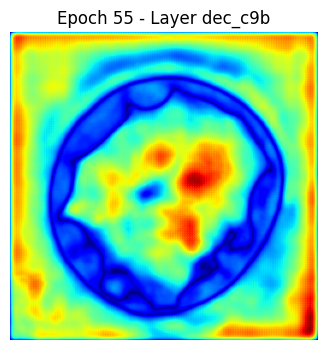

100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 230ms/step - accuracy: 0.8750 - dice_coefficient: 0.9673 - iou_metric: 0.9367 - loss: 0.0513 - val_accuracy: 0.8654 - val_dice_coefficient: 0.8482 - val_iou_metric: 0.7420 - val_loss: 0.3977
Epoch 56/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 223ms/step - accuracy: 0.8749 - dice_coefficient: 0.9678 - iou_metric: 0.9377 - loss: 0.0504 - val_accuracy: 0.8666 - val_dice_coefficient: 0.8462 - val_iou_metric: 0.7392 - val_loss: 0.4043
Epoch 57/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 223ms/step - accuracy: 0.8749 - dice_coefficient: 0.9686 - iou_metric: 0.9391 - loss: 0.0492 - val_accuracy: 0.8660 - val_dice_coefficient: 0.8467 - val_iou_metric: 0.7398 - val_loss: 0.4160
Epoch 58/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 223ms/step - accuracy: 0.8751 - dice_coefficient: 0.9688 - iou_metric: 0.9395 - loss: 0.0489 - val_accuracy: 0.8664 - val_dice_coefficient: 0.8484 - val_iou_metric: 0.7427 - val_loss: 0.4065
Epoch 59/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 223ms/step - accura

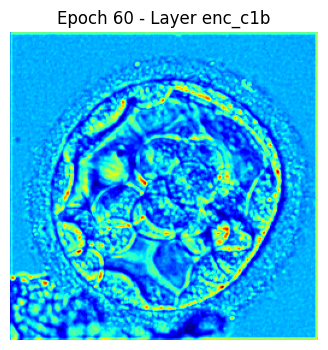

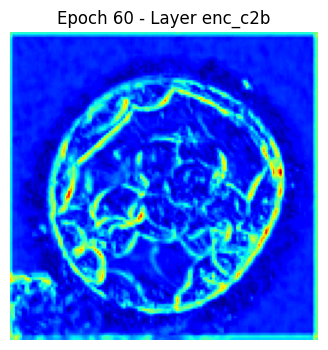

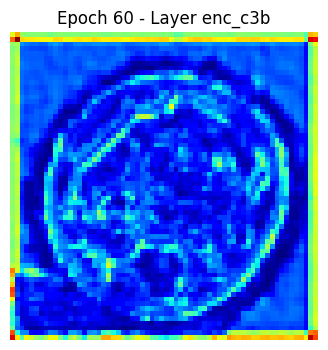

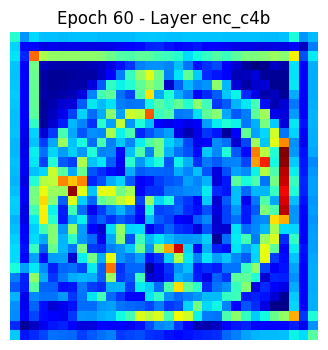

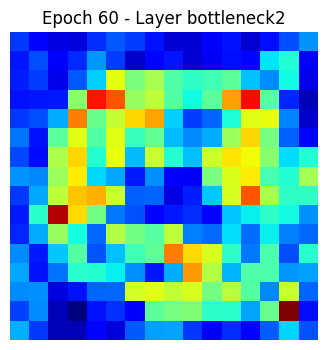

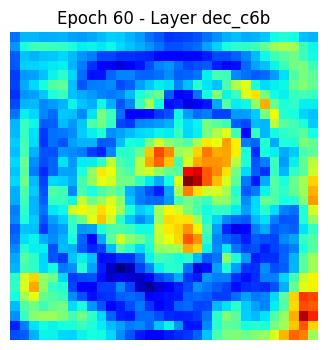

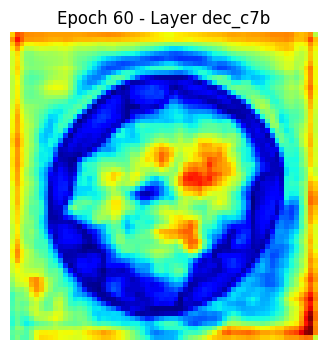

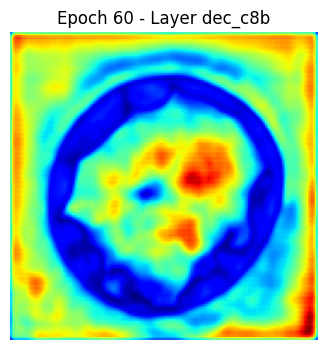

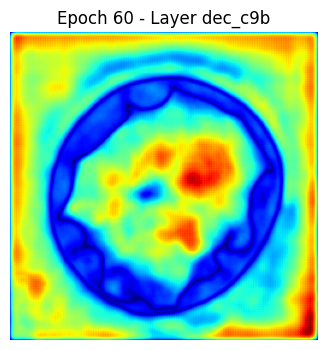

100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 231ms/step - accuracy: 0.8756 - dice_coefficient: 0.9692 - iou_metric: 0.9403 - loss: 0.0481 - val_accuracy: 0.8669 - val_dice_coefficient: 0.8479 - val_iou_metric: 0.7419 - val_loss: 0.4077
Epoch 61/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 222ms/step - accuracy: 0.8753 - dice_coefficient: 0.9696 - iou_metric: 0.9410 - loss: 0.0476 - val_accuracy: 0.8669 - val_dice_coefficient: 0.8475 - val_iou_metric: 0.7411 - val_loss: 0.4156
Epoch 62/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 222ms/step - accuracy: 0.8752 - dice_coefficient: 0.9700 - iou_metric: 0.9418 - loss: 0.0469 - val_accuracy: 0.8657 - val_dice_coefficient: 0.8485 - val_iou_metric: 0.7425 - val_loss: 0.4125
Epoch 63/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 222ms/step - accuracy: 0.8753 - dice_coefficient: 0.9702 - iou_metric: 0.9422 - loss: 0.0466 - val_accuracy: 0.8678 - val_dice_coefficient: 0.8452 - val_iou_metric: 0.7378 - val_loss: 0.4208


Model: "functional_2"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer_1       │ (None, 256, 256,  │          0 │ -                 │
│ (InputLayer)        │ 1)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c1a (Conv2D)    │ (None, 256, 256,  │        640 │ input_layer_1[0]… │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c1b (Conv2D)    │ (None, 256, 256,  │     36,928 │ enc_c1a[0][0]     │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool1               │ (None, 128, 128,  │          0 │ enc_c1b[0][0]     │
│ (MaxPooling2D)      │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c2a (Conv2D)    │ (None, 128, 128,  │     73,856 │ pool1[0][0]       │
│                     │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c2b (Conv2D)    │ (None, 128, 128,  │    147,584 │ enc_c2a[0][0]     │
│                     │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool2               │ (None, 64, 64,    │          0 │ enc_c2b[0][0]     │
│ (MaxPooling2D)      │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c3a (Conv2D)    │ (None, 64, 64,    │    295,168 │ pool2[0][0]       │
│                     │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c3b (Conv2D)    │ (None, 64, 64,    │    590,080 │ enc_c3a[0][0]     │
│                     │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool3               │ (None, 32, 32,    │          0 │ enc_c3b[0][0]     │
│ (MaxPooling2D)      │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c4a (Conv2D)    │ (None, 32, 32,    │  1,180,160 │ pool3[0][0]       │
│                     │ 512)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c4b (Conv2D)    │ (None, 32, 32,    │  2,359,808 │ enc_c4a[0][0]     │
│                     │ 512)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool4               │ (None, 16, 16,    │          0 │ enc_c4b[0][0]     │
│ (MaxPooling2D)      │ 512)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ bottleneck1         │ (None, 16, 16,    │  4,719,616 │ pool4[0][0]       │
│ (Conv2D)            │ 1024)             │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ bottleneck2         │ (None, 16, 16,    │  9,438,208 │ bottleneck1[0][0] │
│ (Conv2D)            │ 1024)             │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dec6_up             │ (None, 32, 32,    │  2,097,664 │ bottleneck2[0][0] │
│ (Conv2DTranspose)   │ 512)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dec6_att            │ (None, 32, 32,    │         99 │ enc_c4b[0][0]   

 Total params: 93,092,969 (355.12 MB)

 Trainable params: 31,030,989 (118.37 MB)

 Non-trainable params: 0 (0.00 B)

 Optimizer params: 62,061,980 (236.75 MB)

GFLOPs calculation not available, use tensorflow profiler for exact computation.
Training time for fold 2: 1461.29s

--- Fold 3 ---
Epoch 1/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 46s 305ms/step - accuracy: 0.8752 - dice_coefficient: 0.1732 - iou_metric: 0.0951 - loss: 1.2917 - val_accuracy: 0.7966 - val_dice_coefficient: 0.4302 - val_iou_metric: 0.2747 - val_loss: 0.7893
Epoch 2/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 224ms/step - accuracy: 0.7942 - dice_coefficient: 0.4878 - iou_metric: 0.3252 - loss: 0.7680 - val_accuracy: 0.8368 - val_dice_coefficient: 0.6070 - val_iou_metric: 0.4372 - val_loss: 0.5684
Epoch 3/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 224ms/step - accuracy: 0.8279 - dice_coefficient: 0.6432 - iou_metric: 0.4752 - loss: 0.5514 - val_accuracy: 0.8386 - val_dice_coefficient: 0.6326 - val_iou_metric: 0.4642 - val_loss: 0.5557
Epoch 4/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 224ms/step - accuracy: 0.8395 - dice_coefficient: 0.6878 - iou_metric: 0.5251 - loss: 0.4856 - val_accuracy: 0.8549

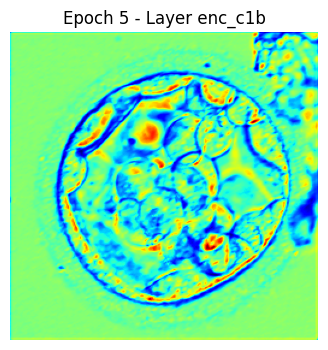

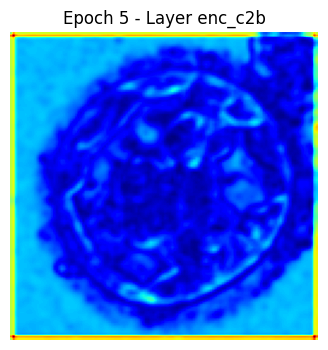

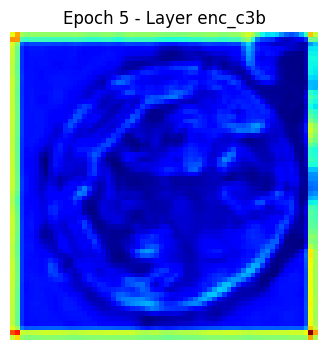

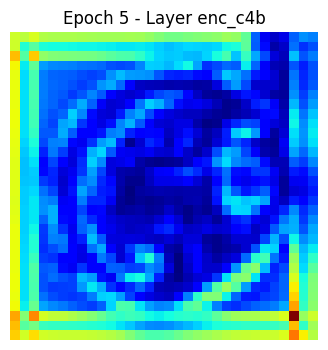

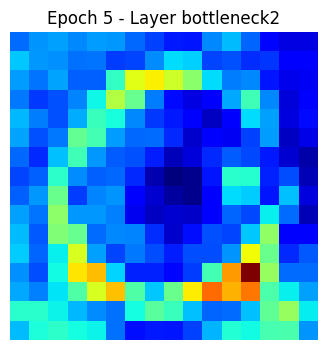

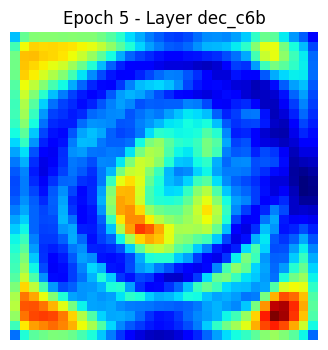

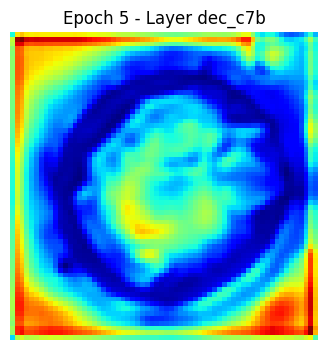

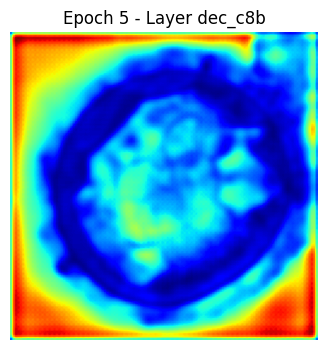

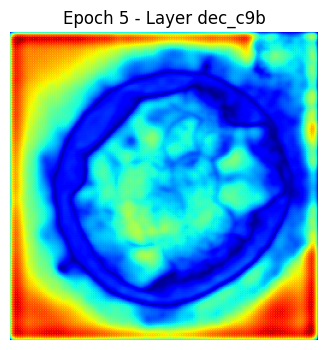

100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 231ms/step - accuracy: 0.8434 - dice_coefficient: 0.7233 - iou_metric: 0.5674 - loss: 0.4356 - val_accuracy: 0.8573 - val_dice_coefficient: 0.7349 - val_iou_metric: 0.5842 - val_loss: 0.4020
Epoch 6/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 223ms/step - accuracy: 0.8469 - dice_coefficient: 0.7544 - iou_metric: 0.6063 - loss: 0.3894 - val_accuracy: 0.8581 - val_dice_coefficient: 0.7278 - val_iou_metric: 0.5752 - val_loss: 0.3964
Epoch 7/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 224ms/step - accuracy: 0.8490 - dice_coefficient: 0.7664 - iou_metric: 0.6220 - loss: 0.3701 - val_accuracy: 0.8603 - val_dice_coefficient: 0.7549 - val_iou_metric: 0.6097 - val_loss: 0.3723
Epoch 8/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 223ms/step - accuracy: 0.8525 - dice_coefficient: 0.7824 - iou_metric: 0.6433 - loss: 0.3450 - val_accuracy: 0.8576 - val_dice_coefficient: 0.7218 - val_iou_metric: 0.5675 - val_loss: 0.3988
Epoch 9/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 224ms/step - accuracy: 

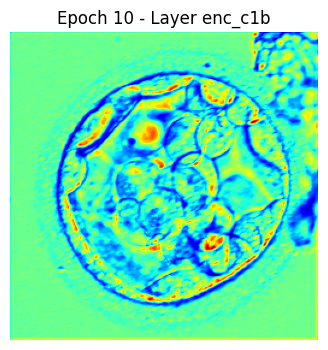

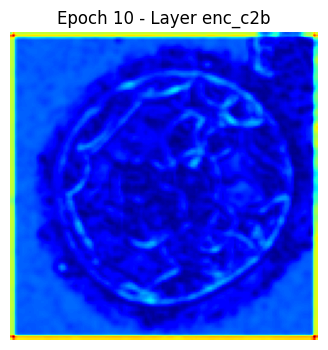

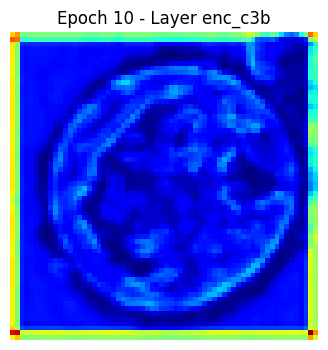

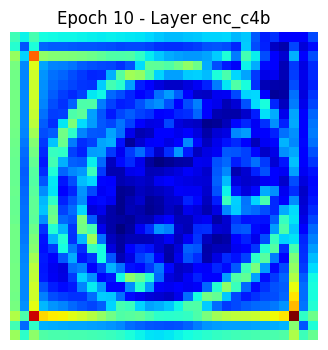

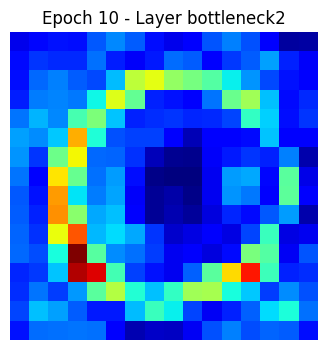

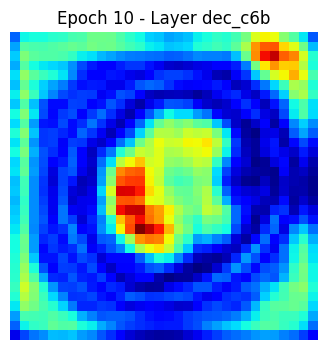

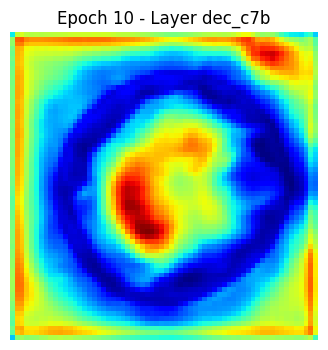

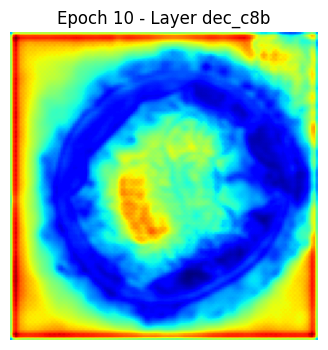

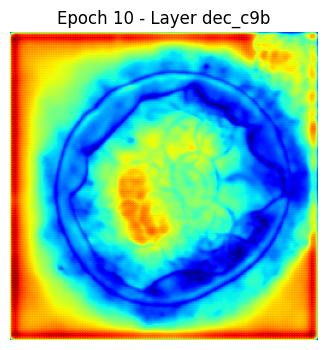

100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 230ms/step - accuracy: 0.8543 - dice_coefficient: 0.8028 - iou_metric: 0.6712 - loss: 0.3133 - val_accuracy: 0.8646 - val_dice_coefficient: 0.7484 - val_iou_metric: 0.6013 - val_loss: 0.3661
Epoch 11/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 223ms/step - accuracy: 0.8551 - dice_coefficient: 0.8040 - iou_metric: 0.6731 - loss: 0.3099 - val_accuracy: 0.8648 - val_dice_coefficient: 0.7825 - val_iou_metric: 0.6467 - val_loss: 0.3350
Epoch 12/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 224ms/step - accuracy: 0.8556 - dice_coefficient: 0.8156 - iou_metric: 0.6895 - loss: 0.2945 - val_accuracy: 0.8663 - val_dice_coefficient: 0.7856 - val_iou_metric: 0.6510 - val_loss: 0.3357
Epoch 13/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 223ms/step - accuracy: 0.8565 - dice_coefficient: 0.8261 - iou_metric: 0.7045 - loss: 0.2791 - val_accuracy: 0.8609 - val_dice_coefficient: 0.7779 - val_iou_metric: 0.6403 - val_loss: 0.3358
Epoch 14/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 224ms/step - accura

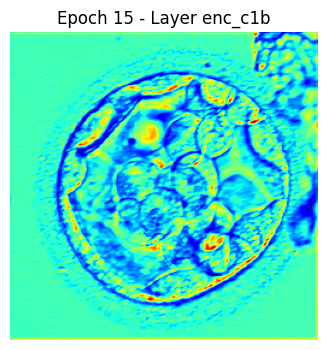

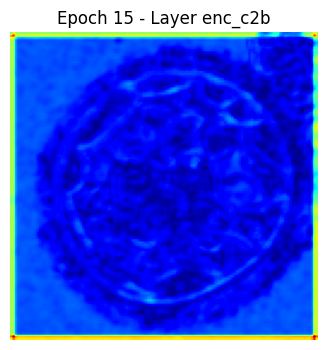

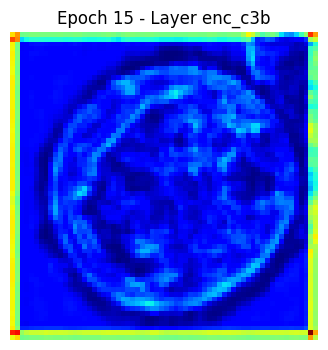

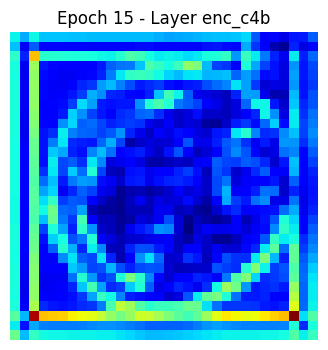

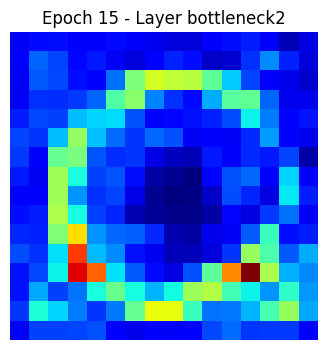

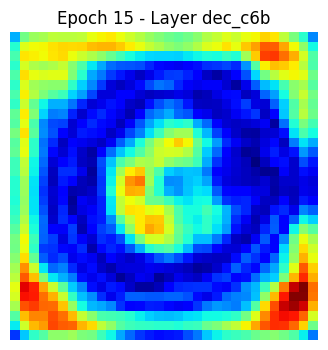

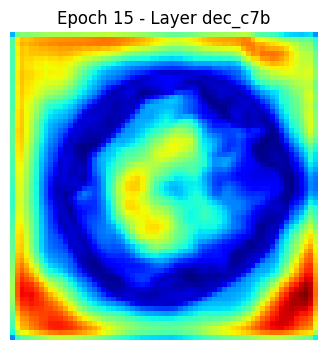

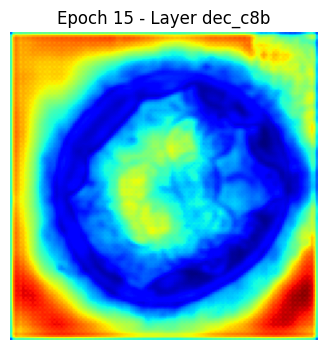

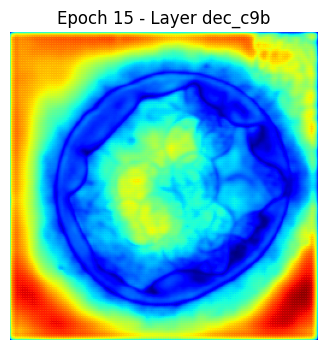

100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 230ms/step - accuracy: 0.8589 - dice_coefficient: 0.8389 - iou_metric: 0.7234 - loss: 0.2609 - val_accuracy: 0.8689 - val_dice_coefficient: 0.7996 - val_iou_metric: 0.6704 - val_loss: 0.3203
Epoch 16/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 223ms/step - accuracy: 0.8597 - dice_coefficient: 0.8436 - iou_metric: 0.7304 - loss: 0.2508 - val_accuracy: 0.8675 - val_dice_coefficient: 0.7677 - val_iou_metric: 0.6265 - val_loss: 0.3478
Epoch 17/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 223ms/step - accuracy: 0.8597 - dice_coefficient: 0.8421 - iou_metric: 0.7283 - loss: 0.2506 - val_accuracy: 0.8668 - val_dice_coefficient: 0.7875 - val_iou_metric: 0.6531 - val_loss: 0.3221
Epoch 18/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 223ms/step - accuracy: 0.8611 - dice_coefficient: 0.8578 - iou_metric: 0.7519 - loss: 0.2280 - val_accuracy: 0.8623 - val_dice_coefficient: 0.8073 - val_iou_metric: 0.6806 - val_loss: 0.3105
Epoch 19/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 224ms/step - accura

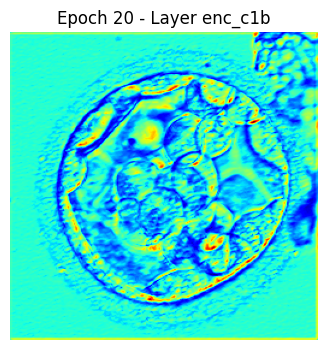

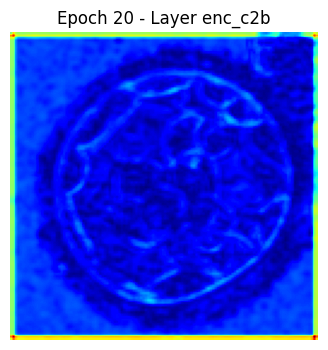

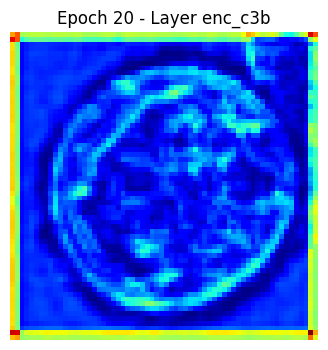

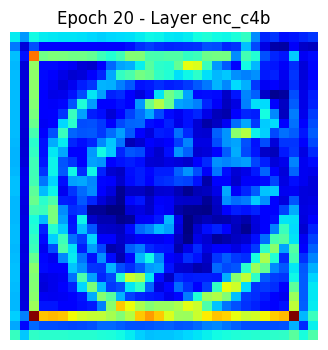

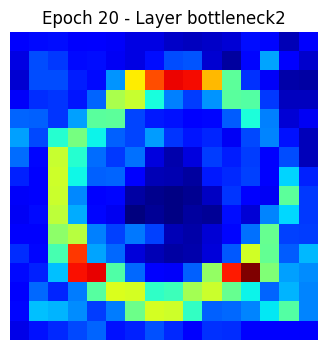

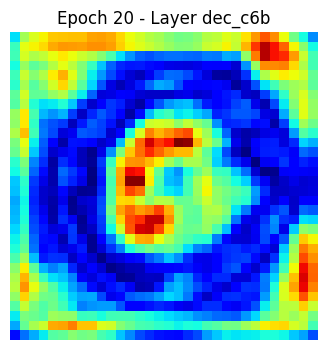

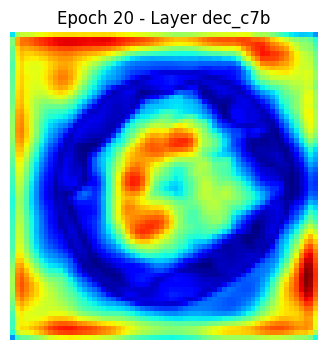

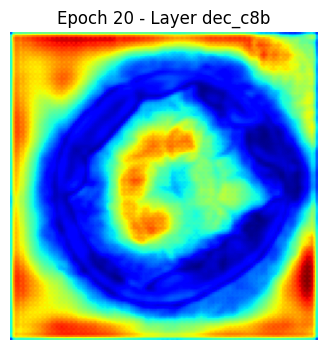

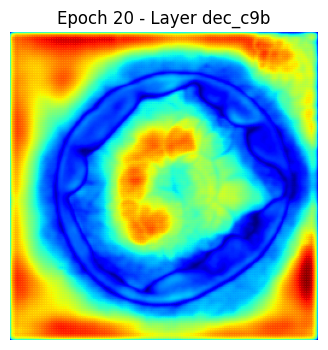

100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 232ms/step - accuracy: 0.8631 - dice_coefficient: 0.8695 - iou_metric: 0.7700 - loss: 0.2103 - val_accuracy: 0.8645 - val_dice_coefficient: 0.8131 - val_iou_metric: 0.6893 - val_loss: 0.3140
Epoch 21/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 223ms/step - accuracy: 0.8633 - dice_coefficient: 0.8744 - iou_metric: 0.7775 - loss: 0.2016 - val_accuracy: 0.8712 - val_dice_coefficient: 0.7712 - val_iou_metric: 0.6314 - val_loss: 0.3479
Epoch 22/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 223ms/step - accuracy: 0.8646 - dice_coefficient: 0.8758 - iou_metric: 0.7798 - loss: 0.1988 - val_accuracy: 0.8687 - val_dice_coefficient: 0.8062 - val_iou_metric: 0.6795 - val_loss: 0.3150
Epoch 23/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 223ms/step - accuracy: 0.8651 - dice_coefficient: 0.8812 - iou_metric: 0.7883 - loss: 0.1909 - val_accuracy: 0.8684 - val_dice_coefficient: 0.7893 - val_iou_metric: 0.6561 - val_loss: 0.3356
Epoch 24/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 224ms/step - accura

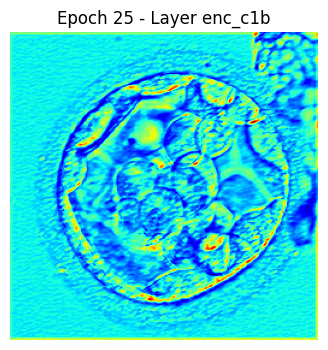

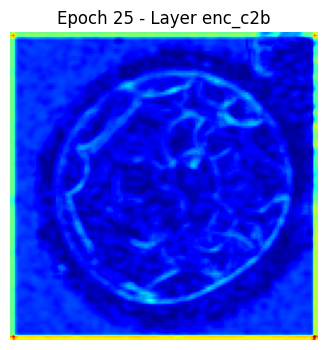

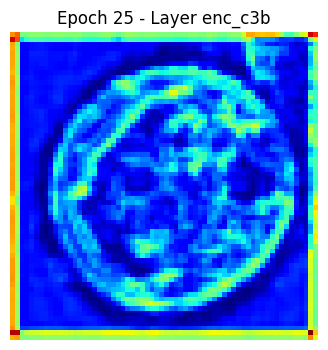

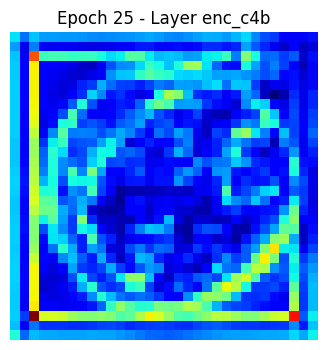

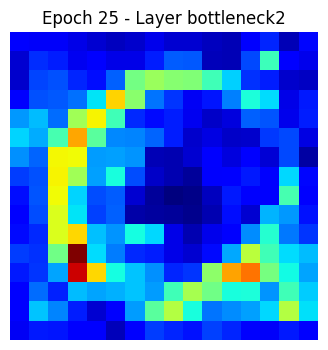

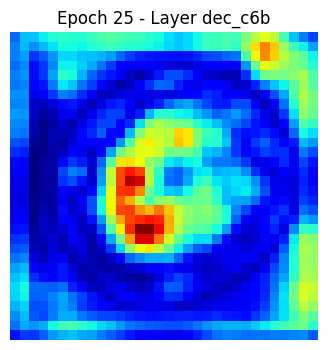

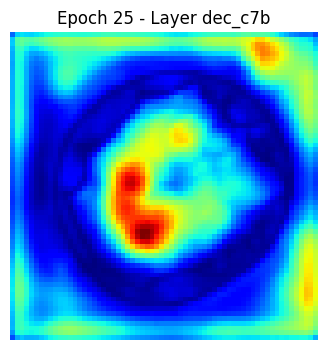

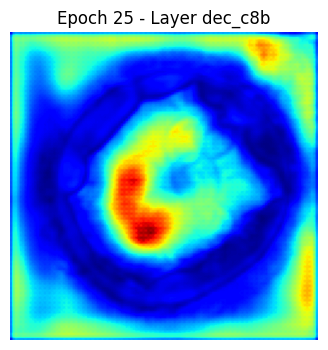

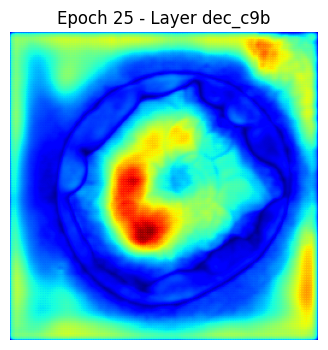

100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 230ms/step - accuracy: 0.8664 - dice_coefficient: 0.8911 - iou_metric: 0.8041 - loss: 0.1749 - val_accuracy: 0.8600 - val_dice_coefficient: 0.7976 - val_iou_metric: 0.6671 - val_loss: 0.3292
Epoch 26/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 223ms/step - accuracy: 0.8666 - dice_coefficient: 0.8927 - iou_metric: 0.8068 - loss: 0.1708 - val_accuracy: 0.8667 - val_dice_coefficient: 0.8022 - val_iou_metric: 0.6734 - val_loss: 0.3318
Epoch 27/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 223ms/step - accuracy: 0.8664 - dice_coefficient: 0.8968 - iou_metric: 0.8135 - loss: 0.1653 - val_accuracy: 0.8680 - val_dice_coefficient: 0.7738 - val_iou_metric: 0.6346 - val_loss: 0.3626
Epoch 28/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 223ms/step - accuracy: 0.8669 - dice_coefficient: 0.8957 - iou_metric: 0.8119 - loss: 0.1656 - val_accuracy: 0.8660 - val_dice_coefficient: 0.8029 - val_iou_metric: 0.6745 - val_loss: 0.3369
Epoch 29/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 223ms/step - accura

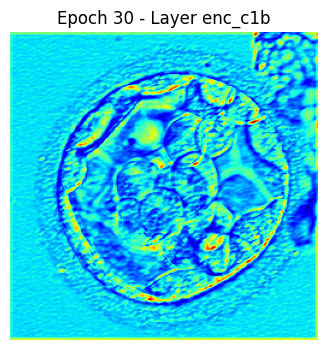

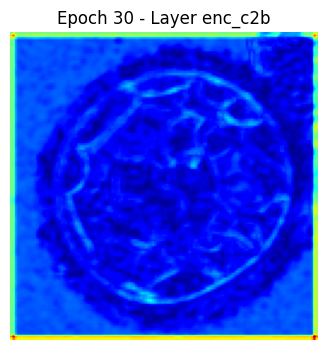

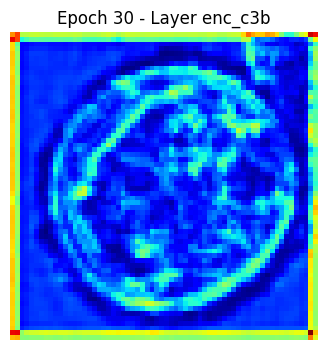

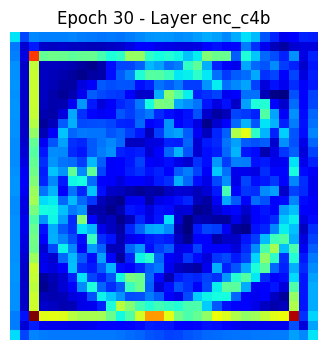

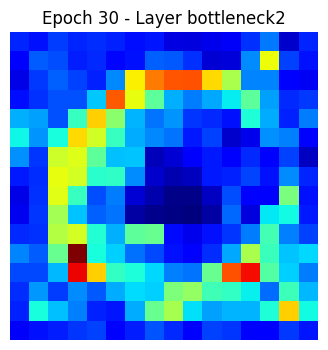

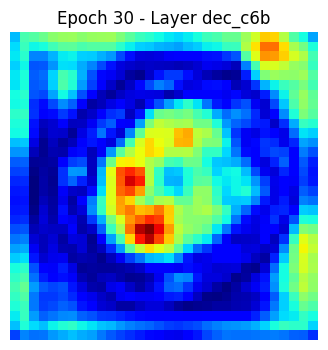

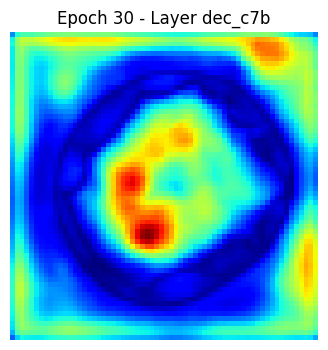

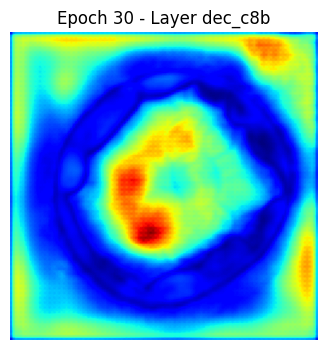

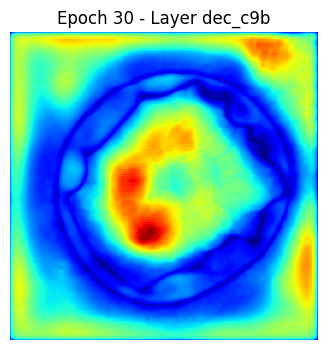

100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 231ms/step - accuracy: 0.8688 - dice_coefficient: 0.9091 - iou_metric: 0.8338 - loss: 0.1450 - val_accuracy: 0.8680 - val_dice_coefficient: 0.8204 - val_iou_metric: 0.6999 - val_loss: 0.3276
Epoch 31/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 224ms/step - accuracy: 0.8682 - dice_coefficient: 0.9123 - iou_metric: 0.8392 - loss: 0.1408 - val_accuracy: 0.8669 - val_dice_coefficient: 0.8260 - val_iou_metric: 0.7079 - val_loss: 0.3178
Epoch 32/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 223ms/step - accuracy: 0.8694 - dice_coefficient: 0.9164 - iou_metric: 0.8462 - loss: 0.1338 - val_accuracy: 0.8689 - val_dice_coefficient: 0.8008 - val_iou_metric: 0.6721 - val_loss: 0.3358
Epoch 33/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 223ms/step - accuracy: 0.8697 - dice_coefficient: 0.9154 - iou_metric: 0.8445 - loss: 0.1334 - val_accuracy: 0.8647 - val_dice_coefficient: 0.8233 - val_iou_metric: 0.7038 - val_loss: 0.3263
Epoch 34/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 222ms/step - accura

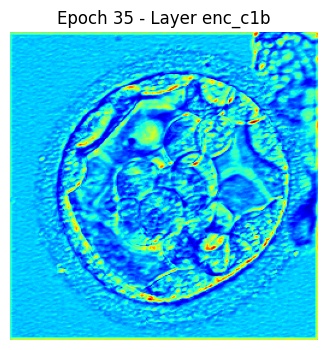

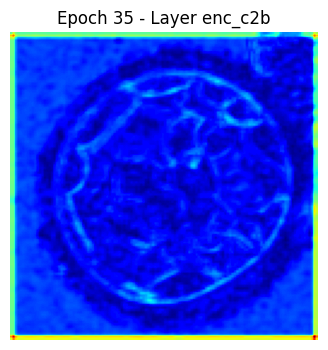

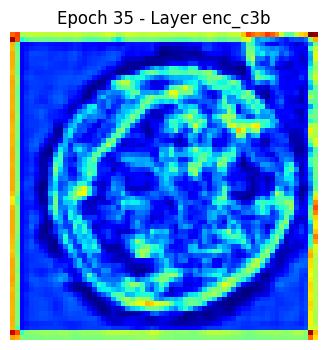

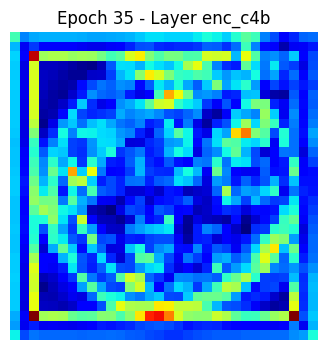

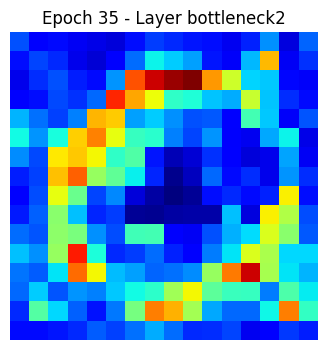

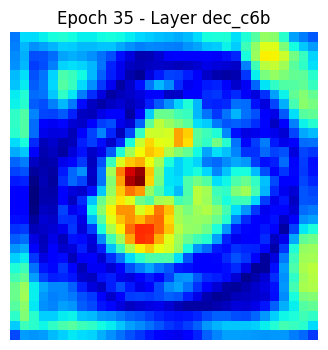

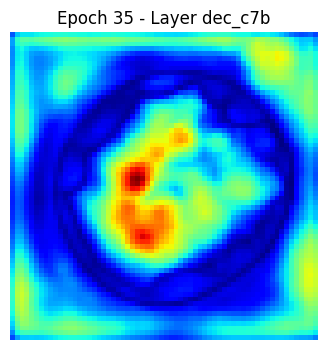

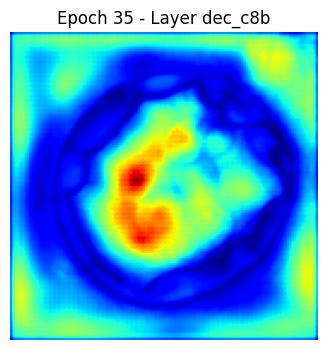

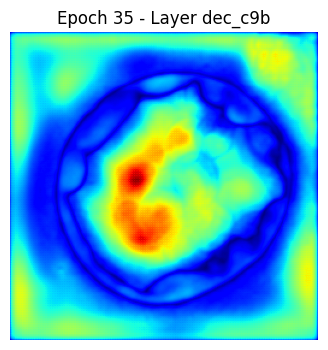

100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 230ms/step - accuracy: 0.8694 - dice_coefficient: 0.9175 - iou_metric: 0.8481 - loss: 0.1306 - val_accuracy: 0.8692 - val_dice_coefficient: 0.8147 - val_iou_metric: 0.6914 - val_loss: 0.3410
Epoch 36/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 223ms/step - accuracy: 0.8694 - dice_coefficient: 0.9259 - iou_metric: 0.8622 - loss: 0.1181 - val_accuracy: 0.8693 - val_dice_coefficient: 0.8215 - val_iou_metric: 0.7014 - val_loss: 0.3285
Epoch 37/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 223ms/step - accuracy: 0.8710 - dice_coefficient: 0.9305 - iou_metric: 0.8702 - loss: 0.1101 - val_accuracy: 0.8662 - val_dice_coefficient: 0.8228 - val_iou_metric: 0.7031 - val_loss: 0.3330
Epoch 38/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 224ms/step - accuracy: 0.8712 - dice_coefficient: 0.9332 - iou_metric: 0.8749 - loss: 0.1057 - val_accuracy: 0.8668 - val_dice_coefficient: 0.8262 - val_iou_metric: 0.7082 - val_loss: 0.3450
Epoch 39/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 222ms/step - accura

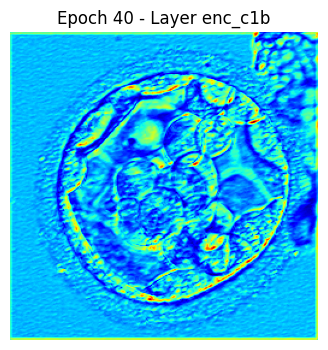

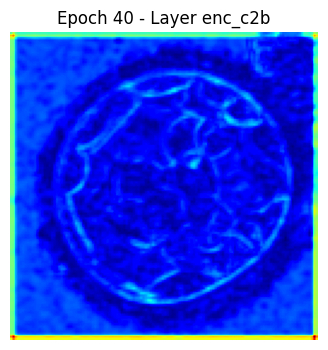

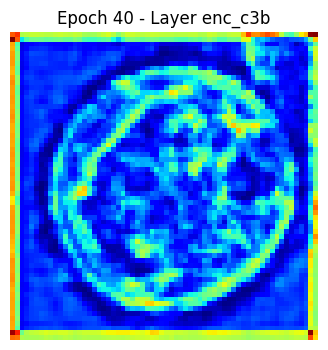

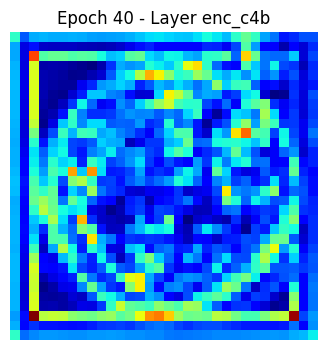

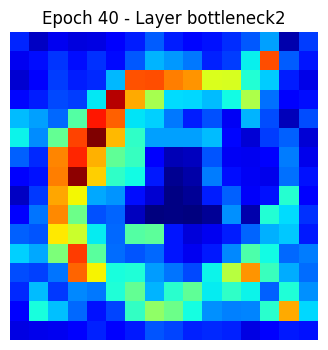

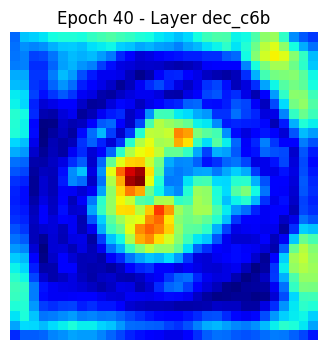

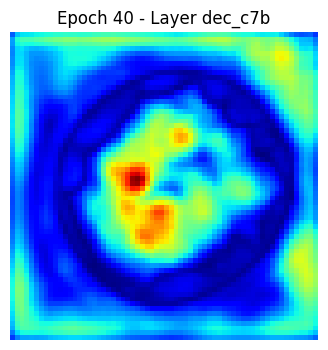

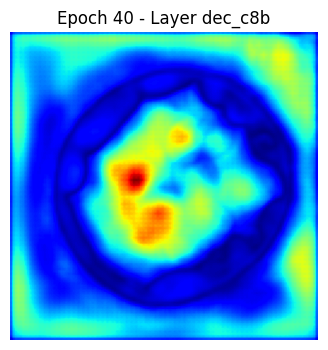

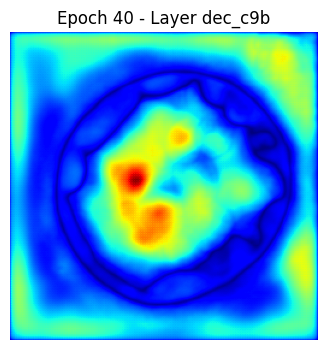

100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 231ms/step - accuracy: 0.8711 - dice_coefficient: 0.9382 - iou_metric: 0.8838 - loss: 0.0970 - val_accuracy: 0.8678 - val_dice_coefficient: 0.8263 - val_iou_metric: 0.7083 - val_loss: 0.3509
Epoch 41/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 223ms/step - accuracy: 0.8711 - dice_coefficient: 0.9409 - iou_metric: 0.8885 - loss: 0.0932 - val_accuracy: 0.8690 - val_dice_coefficient: 0.8239 - val_iou_metric: 0.7046 - val_loss: 0.3685
Epoch 42/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 224ms/step - accuracy: 0.8724 - dice_coefficient: 0.9423 - iou_metric: 0.8910 - loss: 0.0905 - val_accuracy: 0.8670 - val_dice_coefficient: 0.8345 - val_iou_metric: 0.7202 - val_loss: 0.3571
Epoch 43/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 223ms/step - accuracy: 0.8725 - dice_coefficient: 0.9473 - iou_metric: 0.9000 - loss: 0.0831 - val_accuracy: 0.8676 - val_dice_coefficient: 0.8268 - val_iou_metric: 0.7087 - val_loss: 0.3691
Epoch 44/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 223ms/step - accura

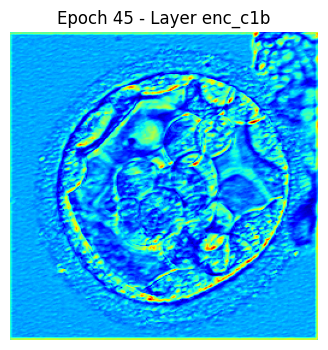

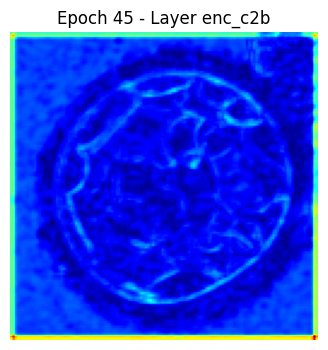

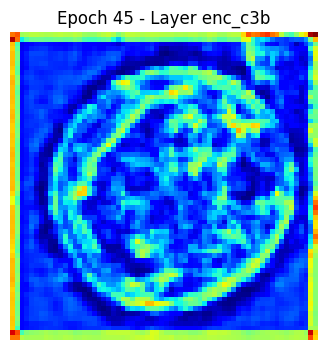

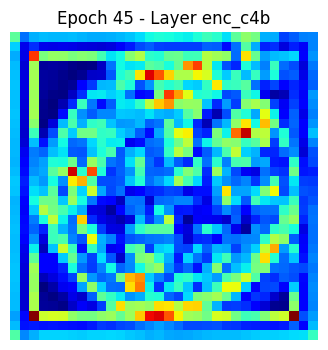

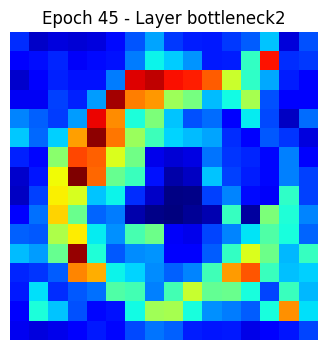

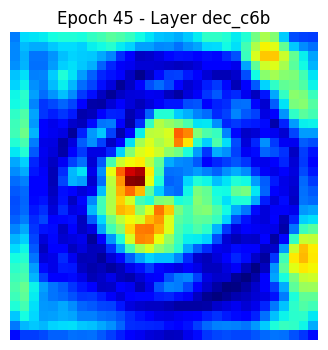

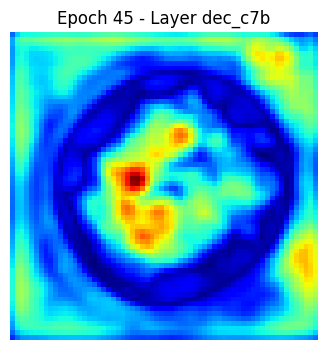

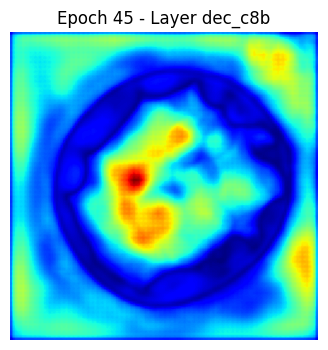

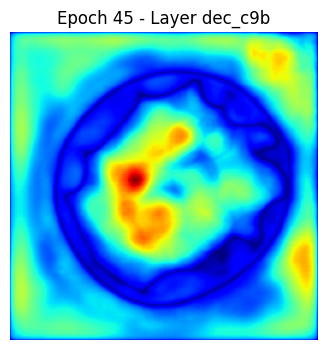

100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 230ms/step - accuracy: 0.8718 - dice_coefficient: 0.9516 - iou_metric: 0.9076 - loss: 0.0763 - val_accuracy: 0.8691 - val_dice_coefficient: 0.8306 - val_iou_metric: 0.7148 - val_loss: 0.3836
Epoch 46/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 224ms/step - accuracy: 0.8738 - dice_coefficient: 0.9538 - iou_metric: 0.9118 - loss: 0.0723 - val_accuracy: 0.8684 - val_dice_coefficient: 0.8383 - val_iou_metric: 0.7263 - val_loss: 0.3726
Epoch 47/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 223ms/step - accuracy: 0.8729 - dice_coefficient: 0.9567 - iou_metric: 0.9171 - loss: 0.0682 - val_accuracy: 0.8669 - val_dice_coefficient: 0.8376 - val_iou_metric: 0.7250 - val_loss: 0.3812
Epoch 48/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 223ms/step - accuracy: 0.8732 - dice_coefficient: 0.9580 - iou_metric: 0.9193 - loss: 0.0660 - val_accuracy: 0.8691 - val_dice_coefficient: 0.8333 - val_iou_metric: 0.7187 - val_loss: 0.3742
Epoch 49/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 223ms/step - accura

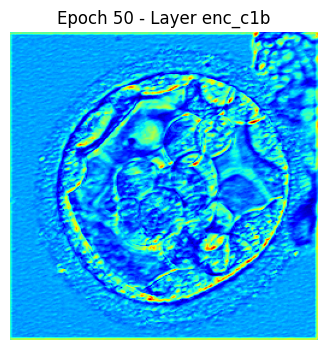

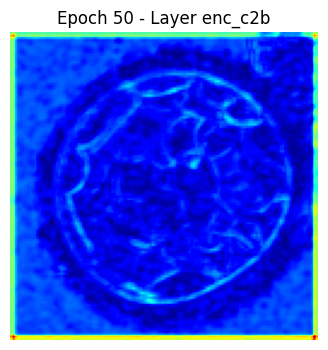

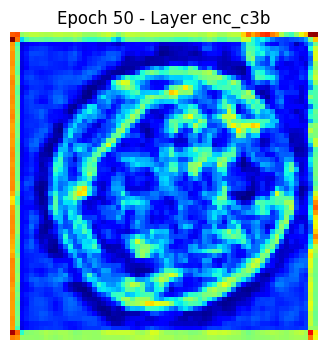

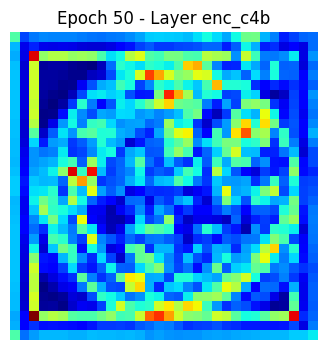

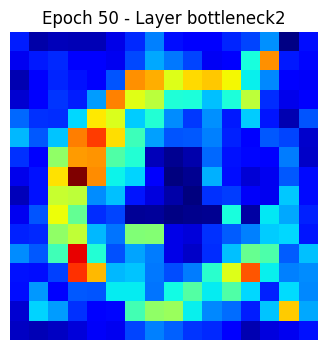

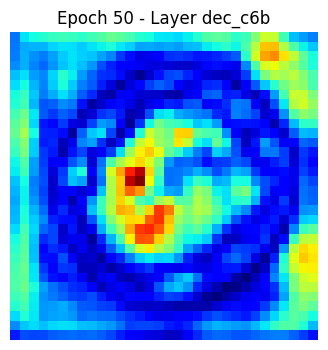

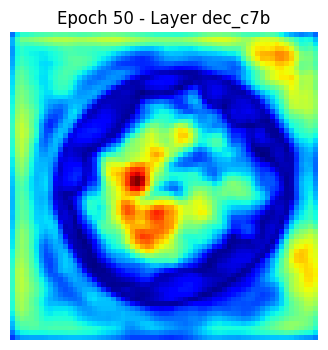

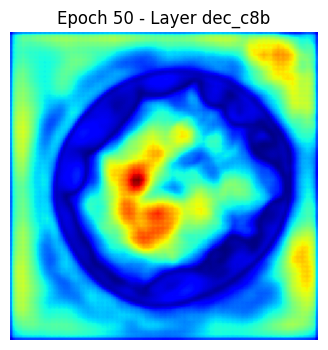

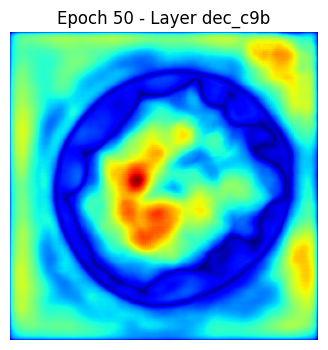

100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 231ms/step - accuracy: 0.8735 - dice_coefficient: 0.9613 - iou_metric: 0.9254 - loss: 0.0609 - val_accuracy: 0.8683 - val_dice_coefficient: 0.8365 - val_iou_metric: 0.7233 - val_loss: 0.4040
Epoch 51/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 223ms/step - accuracy: 0.8741 - dice_coefficient: 0.9617 - iou_metric: 0.9262 - loss: 0.0602 - val_accuracy: 0.8684 - val_dice_coefficient: 0.8365 - val_iou_metric: 0.7236 - val_loss: 0.3879
Epoch 52/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 223ms/step - accuracy: 0.8737 - dice_coefficient: 0.9628 - iou_metric: 0.9284 - loss: 0.0582 - val_accuracy: 0.8697 - val_dice_coefficient: 0.8321 - val_iou_metric: 0.7171 - val_loss: 0.4226
Epoch 53/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 223ms/step - accuracy: 0.8743 - dice_coefficient: 0.9636 - iou_metric: 0.9297 - loss: 0.0570 - val_accuracy: 0.8674 - val_dice_coefficient: 0.8400 - val_iou_metric: 0.7286 - val_loss: 0.3979
Epoch 54/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 223ms/step - accura

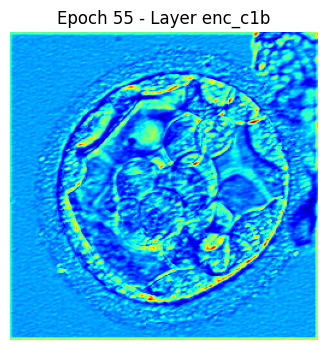

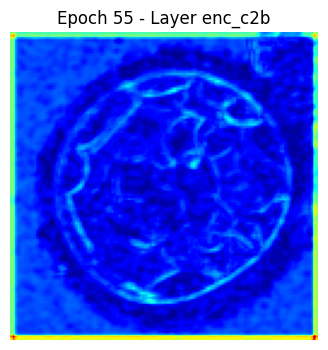

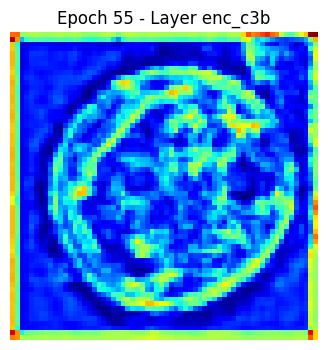

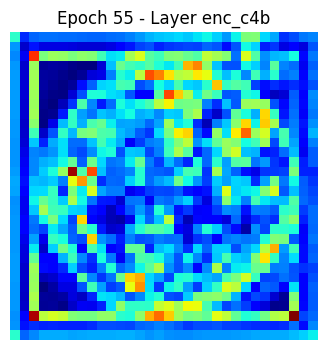

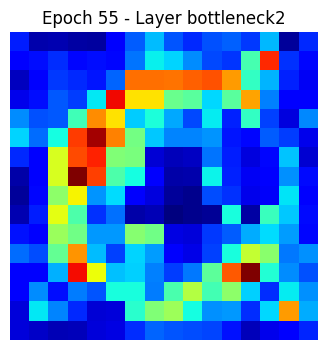

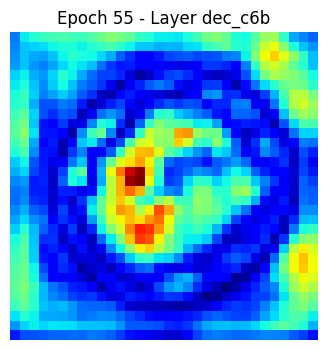

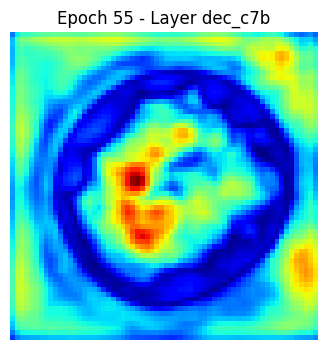

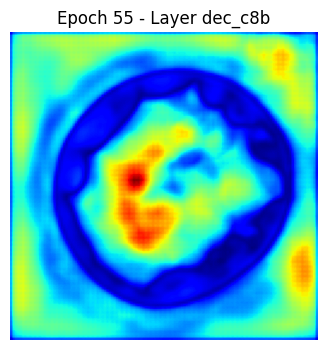

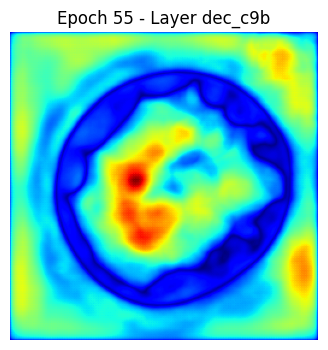

100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 230ms/step - accuracy: 0.8745 - dice_coefficient: 0.9656 - iou_metric: 0.9336 - loss: 0.0537 - val_accuracy: 0.8692 - val_dice_coefficient: 0.8395 - val_iou_metric: 0.7281 - val_loss: 0.4112
Epoch 56/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 223ms/step - accuracy: 0.8744 - dice_coefficient: 0.9671 - iou_metric: 0.9363 - loss: 0.0515 - val_accuracy: 0.8688 - val_dice_coefficient: 0.8406 - val_iou_metric: 0.7297 - val_loss: 0.4136
Epoch 57/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 223ms/step - accuracy: 0.8732 - dice_coefficient: 0.9677 - iou_metric: 0.9374 - loss: 0.0507 - val_accuracy: 0.8692 - val_dice_coefficient: 0.8386 - val_iou_metric: 0.7266 - val_loss: 0.4288
Epoch 58/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 223ms/step - accuracy: 0.8739 - dice_coefficient: 0.9681 - iou_metric: 0.9381 - loss: 0.0501 - val_accuracy: 0.8676 - val_dice_coefficient: 0.8391 - val_iou_metric: 0.7274 - val_loss: 0.3974
Epoch 59/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 223ms/step - accura

Model: "functional_4"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer_2       │ (None, 256, 256,  │          0 │ -                 │
│ (InputLayer)        │ 1)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c1a (Conv2D)    │ (None, 256, 256,  │        640 │ input_layer_2[0]… │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c1b (Conv2D)    │ (None, 256, 256,  │     36,928 │ enc_c1a[0][0]     │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool1               │ (None, 128, 128,  │          0 │ enc_c1b[0][0]     │
│ (MaxPooling2D)      │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c2a (Conv2D)    │ (None, 128, 128,  │     73,856 │ pool1[0][0]       │
│                     │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c2b (Conv2D)    │ (None, 128, 128,  │    147,584 │ enc_c2a[0][0]     │
│                     │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool2               │ (None, 64, 64,    │          0 │ enc_c2b[0][0]     │
│ (MaxPooling2D)      │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c3a (Conv2D)    │ (None, 64, 64,    │    295,168 │ pool2[0][0]       │
│                     │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c3b (Conv2D)    │ (None, 64, 64,    │    590,080 │ enc_c3a[0][0]     │
│                     │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool3               │ (None, 32, 32,    │          0 │ enc_c3b[0][0]     │
│ (MaxPooling2D)      │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c4a (Conv2D)    │ (None, 32, 32,    │  1,180,160 │ pool3[0][0]       │
│                     │ 512)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c4b (Conv2D)    │ (None, 32, 32,    │  2,359,808 │ enc_c4a[0][0]     │
│                     │ 512)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool4               │ (None, 16, 16,    │          0 │ enc_c4b[0][0]     │
│ (MaxPooling2D)      │ 512)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ bottleneck1         │ (None, 16, 16,    │  4,719,616 │ pool4[0][0]       │
│ (Conv2D)            │ 1024)             │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ bottleneck2         │ (None, 16, 16,    │  9,438,208 │ bottleneck1[0][0] │
│ (Conv2D)            │ 1024)             │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dec6_up             │ (None, 32, 32,    │  2,097,664 │ bottleneck2[0][0] │
│ (Conv2DTranspose)   │ 512)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dec6_att            │ (None, 32, 32,    │         99 │ enc_c4b[0][0]   

 Total params: 93,092,969 (355.12 MB)

 Trainable params: 31,030,989 (118.37 MB)

 Non-trainable params: 0 (0.00 B)

 Optimizer params: 62,061,980 (236.75 MB)

GFLOPs calculation not available, use tensorflow profiler for exact computation.
Training time for fold 3: 1355.04s

--- Fold 4 ---
Epoch 1/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 45s 297ms/step - accuracy: 0.8723 - dice_coefficient: 0.1855 - iou_metric: 0.1031 - loss: 1.2796 - val_accuracy: 0.8149 - val_dice_coefficient: 0.4825 - val_iou_metric: 0.3197 - val_loss: 0.7264
Epoch 2/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 224ms/step - accuracy: 0.8026 - dice_coefficient: 0.5624 - iou_metric: 0.3935 - loss: 0.6834 - val_accuracy: 0.8387 - val_dice_coefficient: 0.6489 - val_iou_metric: 0.4836 - val_loss: 0.5557
Epoch 3/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 223ms/step - accuracy: 0.8269 - dice_coefficient: 0.6335 - iou_metric: 0.4651 - loss: 0.5765 - val_accuracy: 0.8474 - val_dice_coefficient: 0.6642 - val_iou_metric: 0.5009 - val_loss: 0.5050
Epoch 4/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 224ms/step - accuracy: 0.8413 - dice_coefficient: 0.7079 - iou_metric: 0.5488 - loss: 0.4608 - val_accuracy: 0.8490

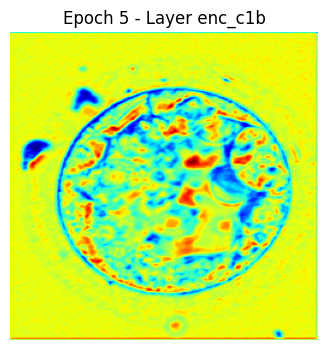

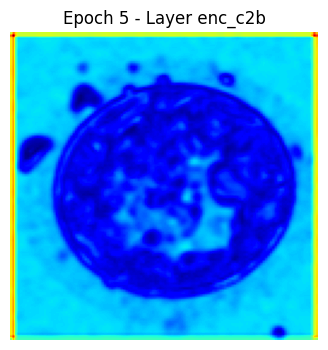

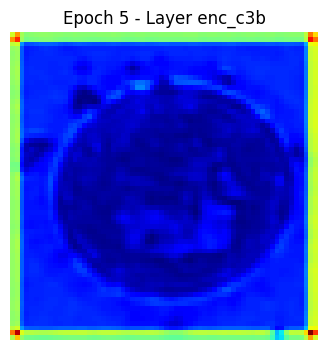

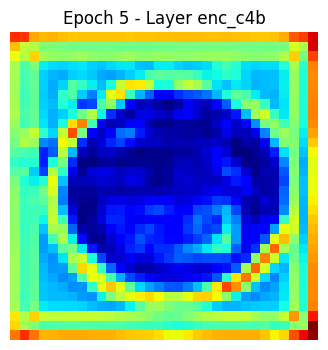

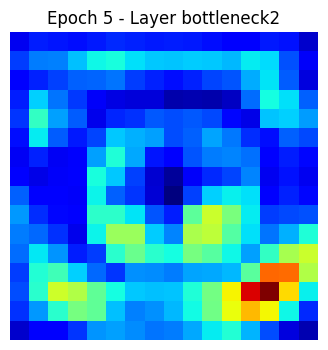

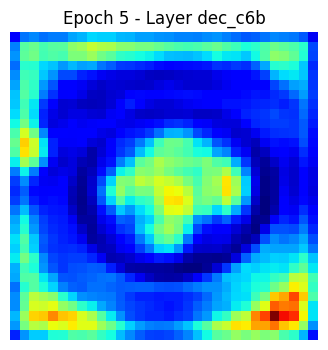

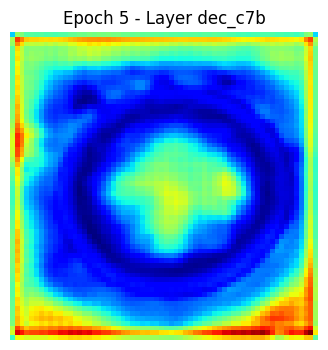

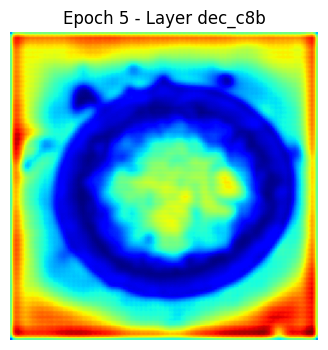

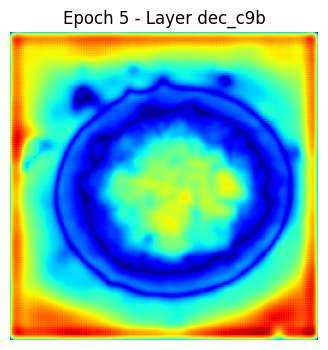

100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 232ms/step - accuracy: 0.8460 - dice_coefficient: 0.7500 - iou_metric: 0.6007 - loss: 0.4009 - val_accuracy: 0.8558 - val_dice_coefficient: 0.7335 - val_iou_metric: 0.5847 - val_loss: 0.4059
Epoch 6/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 223ms/step - accuracy: 0.8493 - dice_coefficient: 0.7663 - iou_metric: 0.6221 - loss: 0.3745 - val_accuracy: 0.8584 - val_dice_coefficient: 0.7245 - val_iou_metric: 0.5737 - val_loss: 0.4015
Epoch 7/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 224ms/step - accuracy: 0.8512 - dice_coefficient: 0.7753 - iou_metric: 0.6340 - loss: 0.3533 - val_accuracy: 0.8593 - val_dice_coefficient: 0.7670 - val_iou_metric: 0.6283 - val_loss: 0.3734
Epoch 8/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 223ms/step - accuracy: 0.8519 - dice_coefficient: 0.7931 - iou_metric: 0.6582 - loss: 0.3309 - val_accuracy: 0.8678 - val_dice_coefficient: 0.7367 - val_iou_metric: 0.5900 - val_loss: 0.3878
Epoch 9/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 224ms/step - accuracy: 

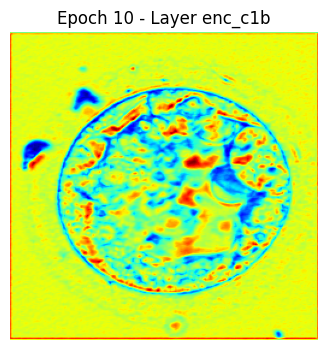

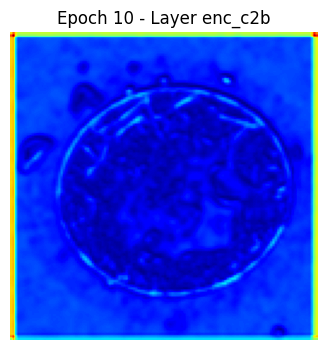

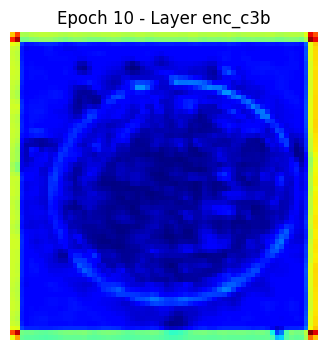

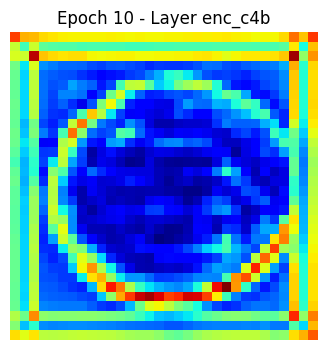

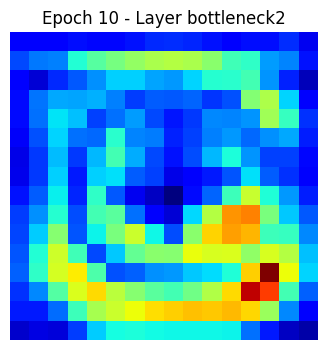

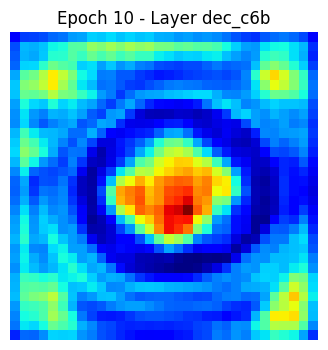

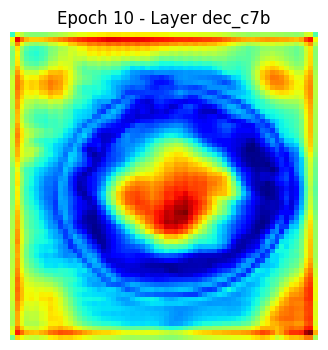

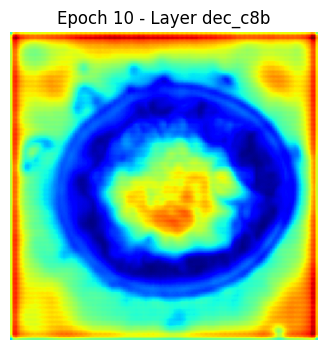

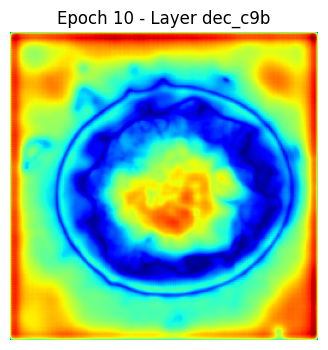

100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 230ms/step - accuracy: 0.8534 - dice_coefficient: 0.8020 - iou_metric: 0.6701 - loss: 0.3152 - val_accuracy: 0.8583 - val_dice_coefficient: 0.7597 - val_iou_metric: 0.6186 - val_loss: 0.3606
Epoch 11/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 222ms/step - accuracy: 0.8555 - dice_coefficient: 0.8099 - iou_metric: 0.6813 - loss: 0.3028 - val_accuracy: 0.8644 - val_dice_coefficient: 0.7683 - val_iou_metric: 0.6313 - val_loss: 0.3501
Epoch 12/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 224ms/step - accuracy: 0.8562 - dice_coefficient: 0.8220 - iou_metric: 0.6985 - loss: 0.2854 - val_accuracy: 0.8629 - val_dice_coefficient: 0.7730 - val_iou_metric: 0.6368 - val_loss: 0.3380
Epoch 13/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 224ms/step - accuracy: 0.8578 - dice_coefficient: 0.8274 - iou_metric: 0.7063 - loss: 0.2738 - val_accuracy: 0.8604 - val_dice_coefficient: 0.7819 - val_iou_metric: 0.6492 - val_loss: 0.3322
Epoch 14/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 224ms/step - accura

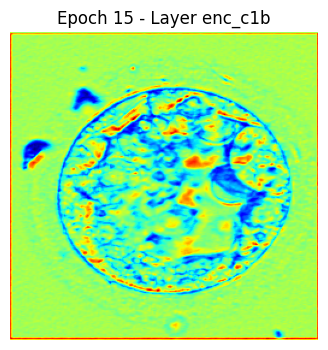

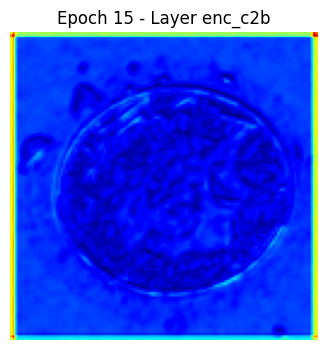

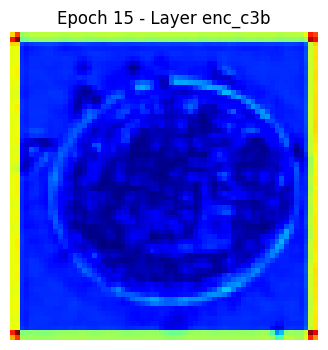

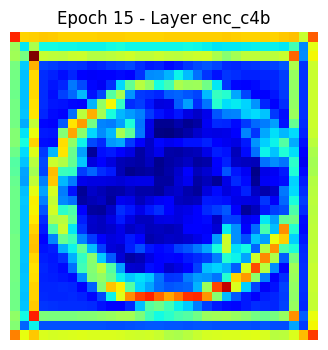

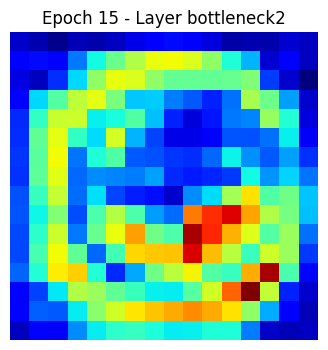

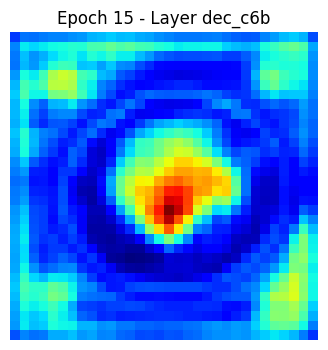

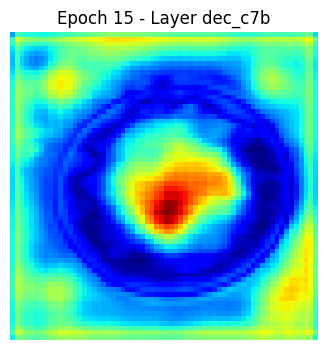

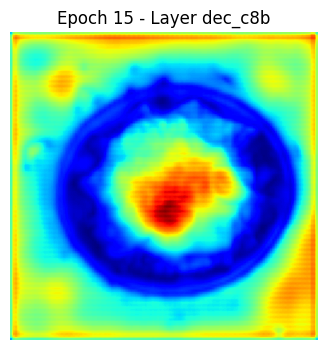

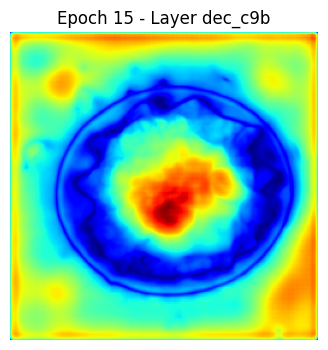

100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 231ms/step - accuracy: 0.8595 - dice_coefficient: 0.8408 - iou_metric: 0.7261 - loss: 0.2552 - val_accuracy: 0.8689 - val_dice_coefficient: 0.7971 - val_iou_metric: 0.6704 - val_loss: 0.3233
Epoch 16/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 223ms/step - accuracy: 0.8607 - dice_coefficient: 0.8416 - iou_metric: 0.7273 - loss: 0.2518 - val_accuracy: 0.8674 - val_dice_coefficient: 0.8097 - val_iou_metric: 0.6890 - val_loss: 0.3091
Epoch 17/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 223ms/step - accuracy: 0.8616 - dice_coefficient: 0.8573 - iou_metric: 0.7512 - loss: 0.2296 - val_accuracy: 0.8690 - val_dice_coefficient: 0.7916 - val_iou_metric: 0.6643 - val_loss: 0.3336
Epoch 18/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 223ms/step - accuracy: 0.8618 - dice_coefficient: 0.8558 - iou_metric: 0.7489 - loss: 0.2329 - val_accuracy: 0.8674 - val_dice_coefficient: 0.8014 - val_iou_metric: 0.6774 - val_loss: 0.3248
Epoch 19/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 223ms/step - accura

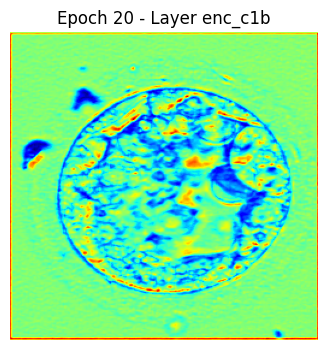

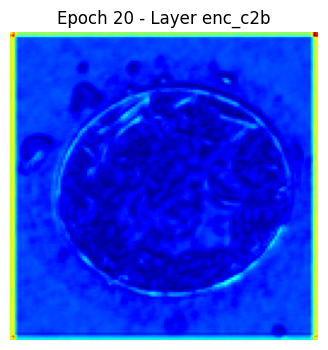

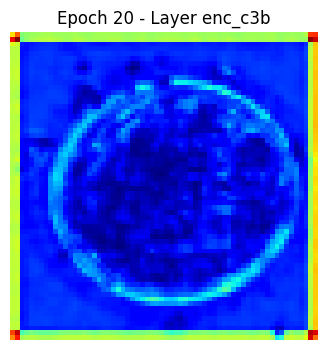

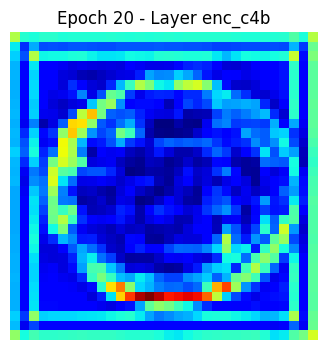

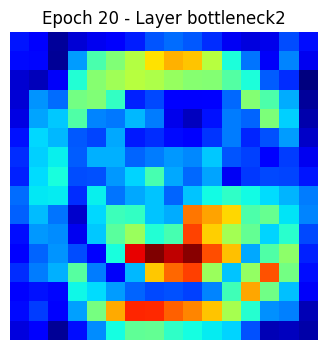

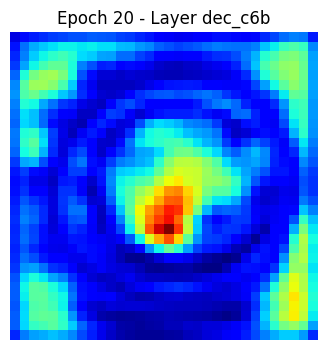

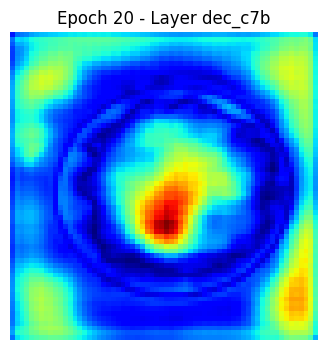

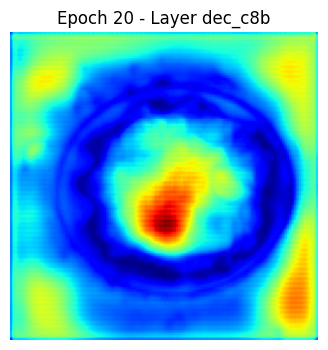

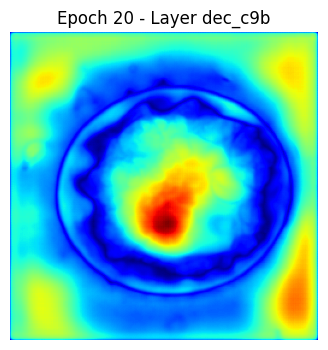

100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 230ms/step - accuracy: 0.8646 - dice_coefficient: 0.8678 - iou_metric: 0.7676 - loss: 0.2105 - val_accuracy: 0.8633 - val_dice_coefficient: 0.8031 - val_iou_metric: 0.6793 - val_loss: 0.3317
Epoch 21/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 223ms/step - accuracy: 0.8646 - dice_coefficient: 0.8769 - iou_metric: 0.7815 - loss: 0.1982 - val_accuracy: 0.8674 - val_dice_coefficient: 0.7864 - val_iou_metric: 0.6551 - val_loss: 0.3313
Epoch 22/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 223ms/step - accuracy: 0.8649 - dice_coefficient: 0.8767 - iou_metric: 0.7814 - loss: 0.1958 - val_accuracy: 0.8677 - val_dice_coefficient: 0.8033 - val_iou_metric: 0.6787 - val_loss: 0.3080
Epoch 23/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 222ms/step - accuracy: 0.8658 - dice_coefficient: 0.8839 - iou_metric: 0.7926 - loss: 0.1845 - val_accuracy: 0.8684 - val_dice_coefficient: 0.7845 - val_iou_metric: 0.6528 - val_loss: 0.3521
Epoch 24/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 222ms/step - accura

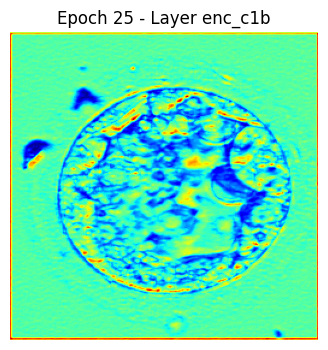

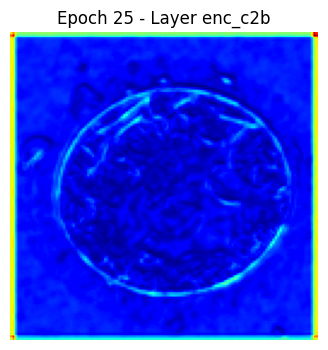

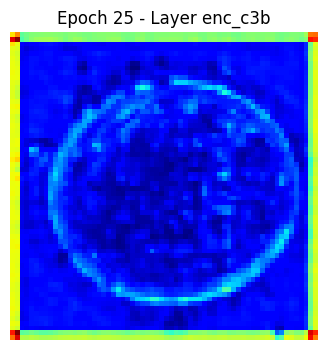

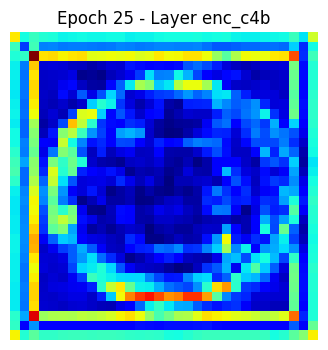

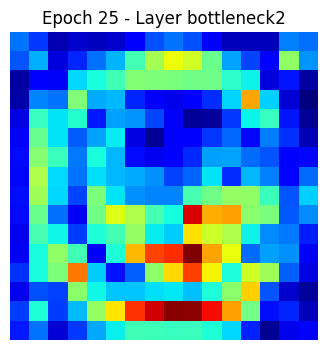

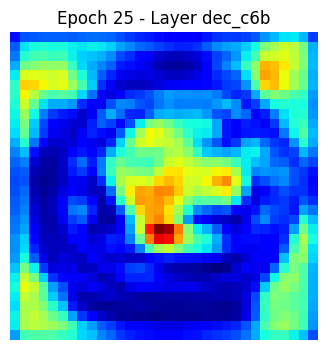

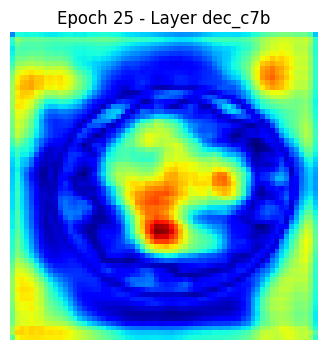

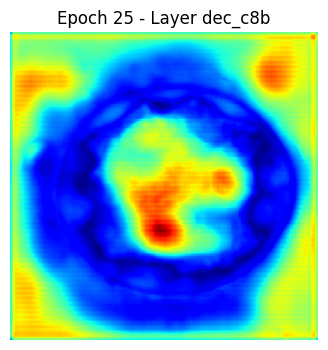

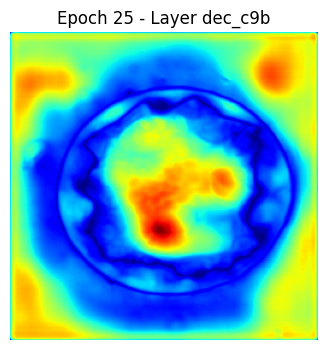

100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 230ms/step - accuracy: 0.8649 - dice_coefficient: 0.8837 - iou_metric: 0.7925 - loss: 0.1849 - val_accuracy: 0.8657 - val_dice_coefficient: 0.7947 - val_iou_metric: 0.6672 - val_loss: 0.3266
Epoch 26/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 222ms/step - accuracy: 0.8668 - dice_coefficient: 0.8955 - iou_metric: 0.8113 - loss: 0.1664 - val_accuracy: 0.8649 - val_dice_coefficient: 0.8041 - val_iou_metric: 0.6803 - val_loss: 0.3351


Model: "functional_6"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer_3       │ (None, 256, 256,  │          0 │ -                 │
│ (InputLayer)        │ 1)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c1a (Conv2D)    │ (None, 256, 256,  │        640 │ input_layer_3[0]… │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c1b (Conv2D)    │ (None, 256, 256,  │     36,928 │ enc_c1a[0][0]     │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool1               │ (None, 128, 128,  │          0 │ enc_c1b[0][0]     │
│ (MaxPooling2D)      │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c2a (Conv2D)    │ (None, 128, 128,  │     73,856 │ pool1[0][0]       │
│                     │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c2b (Conv2D)    │ (None, 128, 128,  │    147,584 │ enc_c2a[0][0]     │
│                     │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool2               │ (None, 64, 64,    │          0 │ enc_c2b[0][0]     │
│ (MaxPooling2D)      │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c3a (Conv2D)    │ (None, 64, 64,    │    295,168 │ pool2[0][0]       │
│                     │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c3b (Conv2D)    │ (None, 64, 64,    │    590,080 │ enc_c3a[0][0]     │
│                     │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool3               │ (None, 32, 32,    │          0 │ enc_c3b[0][0]     │
│ (MaxPooling2D)      │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c4a (Conv2D)    │ (None, 32, 32,    │  1,180,160 │ pool3[0][0]       │
│                     │ 512)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c4b (Conv2D)    │ (None, 32, 32,    │  2,359,808 │ enc_c4a[0][0]     │
│                     │ 512)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool4               │ (None, 16, 16,    │          0 │ enc_c4b[0][0]     │
│ (MaxPooling2D)      │ 512)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ bottleneck1         │ (None, 16, 16,    │  4,719,616 │ pool4[0][0]       │
│ (Conv2D)            │ 1024)             │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ bottleneck2         │ (None, 16, 16,    │  9,438,208 │ bottleneck1[0][0] │
│ (Conv2D)            │ 1024)             │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dec6_up             │ (None, 32, 32,    │  2,097,664 │ bottleneck2[0][0] │
│ (Conv2DTranspose)   │ 512)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dec6_att            │ (None, 32, 32,    │         99 │ enc_c4b[0][0]   

 Total params: 93,092,969 (355.12 MB)

 Trainable params: 31,030,989 (118.37 MB)

 Non-trainable params: 0 (0.00 B)

 Optimizer params: 62,061,980 (236.75 MB)

GFLOPs calculation not available, use tensorflow profiler for exact computation.
Training time for fold 4: 609.07s

--- Fold 5 ---
Epoch 1/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 45s 296ms/step - accuracy: 0.8724 - dice_coefficient: 0.1771 - iou_metric: 0.0975 - loss: 1.2848 - val_accuracy: 0.7590 - val_dice_coefficient: 0.4372 - val_iou_metric: 0.2807 - val_loss: 0.8581
Epoch 2/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 223ms/step - accuracy: 0.7803 - dice_coefficient: 0.4748 - iou_metric: 0.3123 - loss: 0.7981 - val_accuracy: 0.7818 - val_dice_coefficient: 0.4981 - val_iou_metric: 0.3326 - val_loss: 0.7417
Epoch 3/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 223ms/step - accuracy: 0.7938 - dice_coefficient: 0.5077 - iou_metric: 0.3416 - loss: 0.7529 - val_accuracy: 0.8419 - val_dice_coefficient: 0.6014 - val_iou_metric: 0.4314 - val_loss: 0.5984
Epoch 4/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 223ms/step - accuracy: 0.8271 - dice_coefficient: 0.6354 - iou_metric: 0.4667 - loss: 0.5702 - val_accuracy: 0.8582 

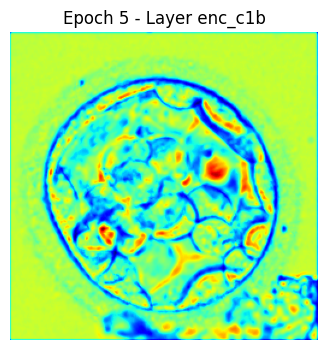

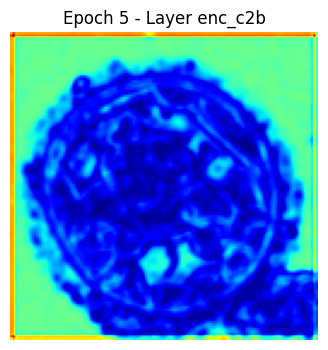

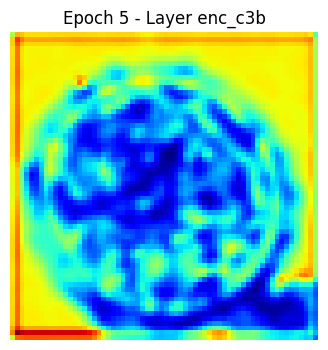

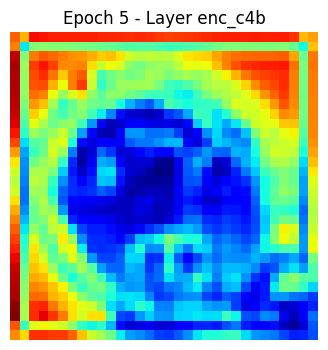

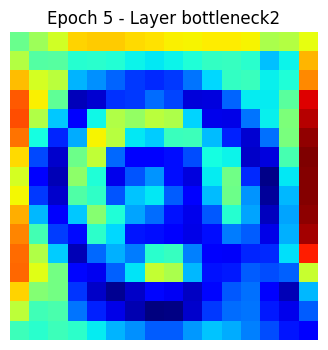

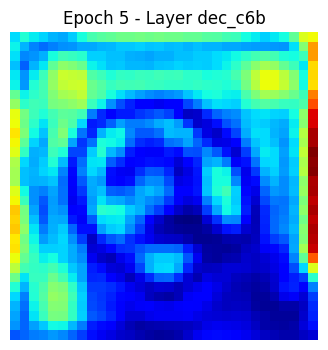

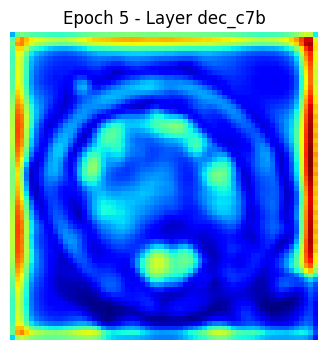

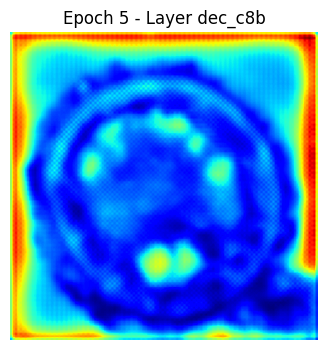

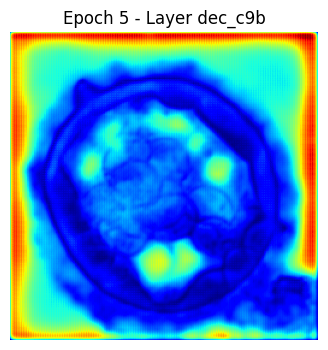

100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 231ms/step - accuracy: 0.8331 - dice_coefficient: 0.6712 - iou_metric: 0.5062 - loss: 0.5153 - val_accuracy: 0.8479 - val_dice_coefficient: 0.6725 - val_iou_metric: 0.5079 - val_loss: 0.4785
Epoch 6/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 223ms/step - accuracy: 0.8412 - dice_coefficient: 0.7051 - iou_metric: 0.5456 - loss: 0.4584 - val_accuracy: 0.8542 - val_dice_coefficient: 0.7294 - val_iou_metric: 0.5757 - val_loss: 0.4251
Epoch 7/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 224ms/step - accuracy: 0.8437 - dice_coefficient: 0.7343 - iou_metric: 0.5811 - loss: 0.4189 - val_accuracy: 0.8499 - val_dice_coefficient: 0.7366 - val_iou_metric: 0.5846 - val_loss: 0.4103
Epoch 8/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 223ms/step - accuracy: 0.8476 - dice_coefficient: 0.7584 - iou_metric: 0.6114 - loss: 0.3813 - val_accuracy: 0.8568 - val_dice_coefficient: 0.7349 - val_iou_metric: 0.5825 - val_loss: 0.3929
Epoch 9/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 223ms/step - accuracy: 

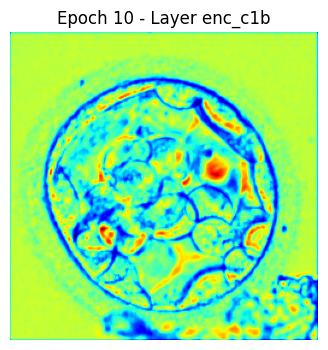

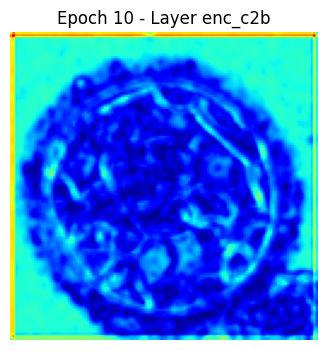

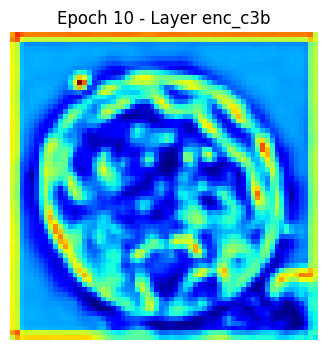

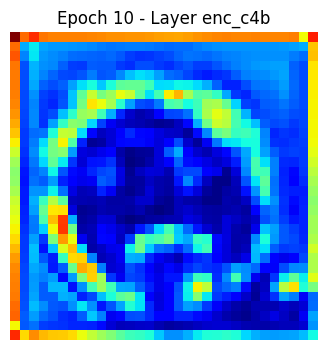

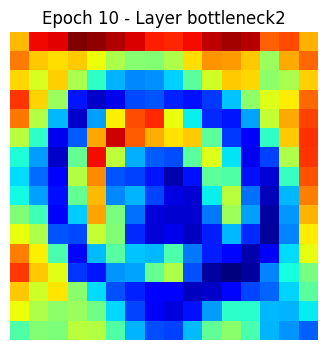

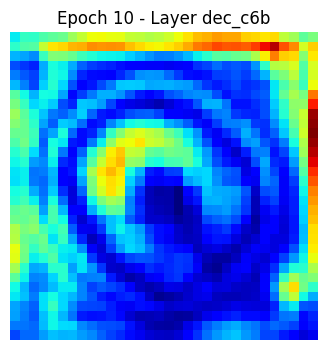

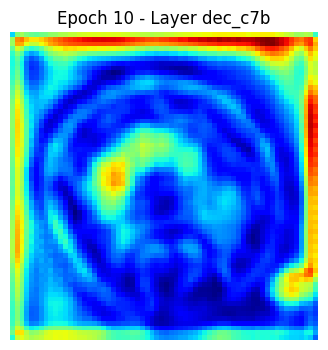

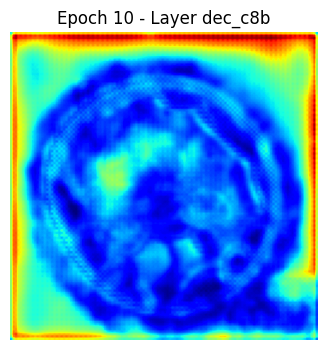

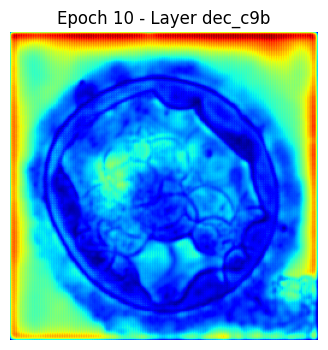

100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 230ms/step - accuracy: 0.8502 - dice_coefficient: 0.7733 - iou_metric: 0.6314 - loss: 0.3590 - val_accuracy: 0.8564 - val_dice_coefficient: 0.7243 - val_iou_metric: 0.5692 - val_loss: 0.4004
Epoch 11/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 224ms/step - accuracy: 0.8494 - dice_coefficient: 0.7717 - iou_metric: 0.6295 - loss: 0.3576 - val_accuracy: 0.8593 - val_dice_coefficient: 0.7685 - val_iou_metric: 0.6260 - val_loss: 0.3606
Epoch 12/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 223ms/step - accuracy: 0.8515 - dice_coefficient: 0.7937 - iou_metric: 0.6588 - loss: 0.3278 - val_accuracy: 0.8655 - val_dice_coefficient: 0.7709 - val_iou_metric: 0.6296 - val_loss: 0.3634
Epoch 13/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 224ms/step - accuracy: 0.8521 - dice_coefficient: 0.7956 - iou_metric: 0.6613 - loss: 0.3241 - val_accuracy: 0.8646 - val_dice_coefficient: 0.7723 - val_iou_metric: 0.6313 - val_loss: 0.3499
Epoch 14/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 223ms/step - accura

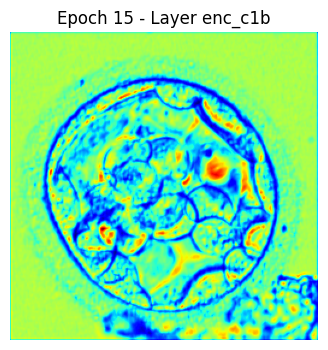

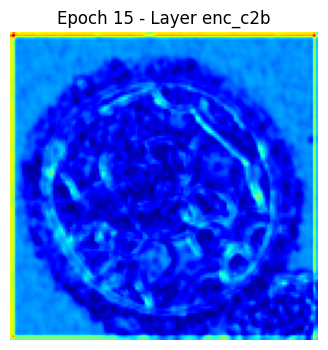

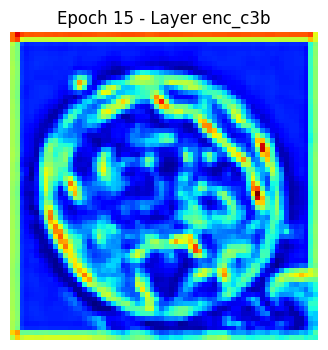

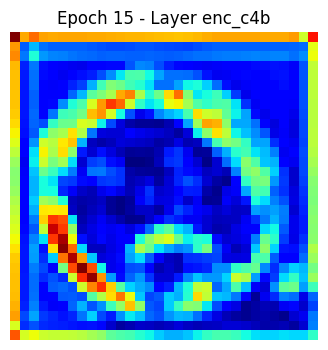

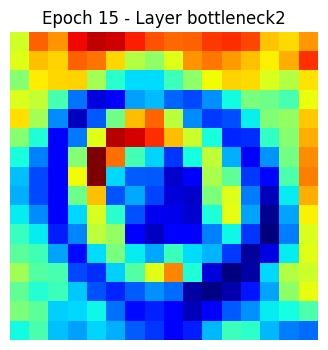

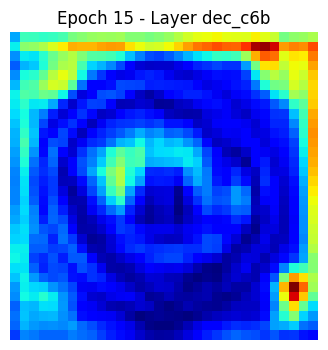

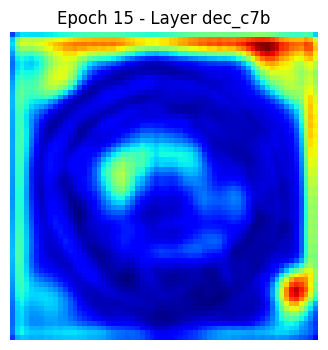

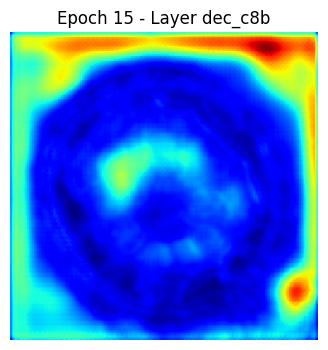

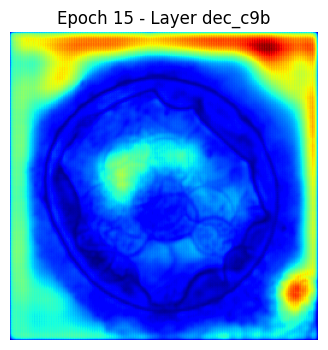

100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 230ms/step - accuracy: 0.8536 - dice_coefficient: 0.8161 - iou_metric: 0.6899 - loss: 0.2982 - val_accuracy: 0.8620 - val_dice_coefficient: 0.7754 - val_iou_metric: 0.6352 - val_loss: 0.3416
Epoch 16/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 222ms/step - accuracy: 0.8560 - dice_coefficient: 0.8153 - iou_metric: 0.6892 - loss: 0.2931 - val_accuracy: 0.8589 - val_dice_coefficient: 0.7811 - val_iou_metric: 0.6430 - val_loss: 0.3353
Epoch 17/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 224ms/step - accuracy: 0.8558 - dice_coefficient: 0.8250 - iou_metric: 0.7030 - loss: 0.2787 - val_accuracy: 0.8659 - val_dice_coefficient: 0.7938 - val_iou_metric: 0.6607 - val_loss: 0.3376
Epoch 18/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 223ms/step - accuracy: 0.8584 - dice_coefficient: 0.8357 - iou_metric: 0.7187 - loss: 0.2657 - val_accuracy: 0.8583 - val_dice_coefficient: 0.7921 - val_iou_metric: 0.6580 - val_loss: 0.3276
Epoch 19/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 222ms/step - accura

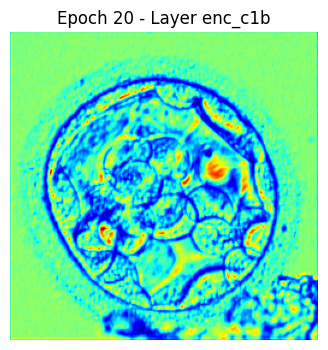

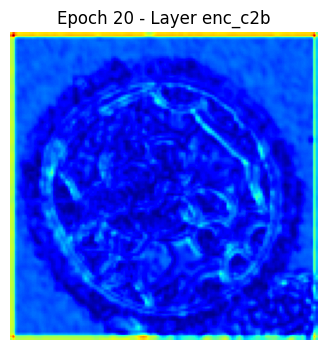

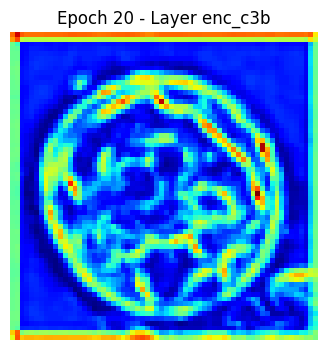

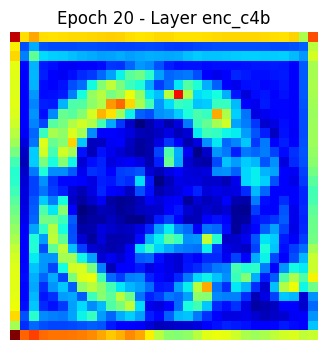

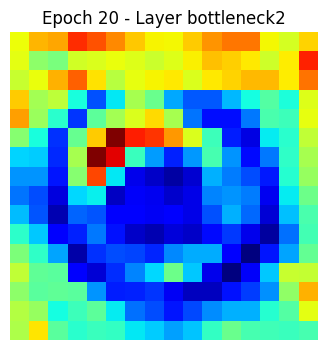

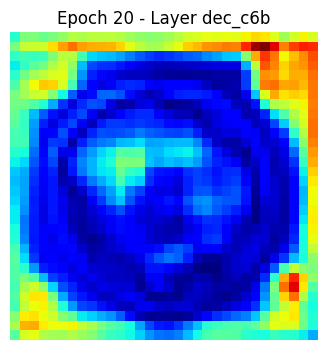

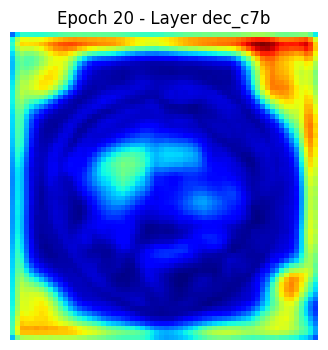

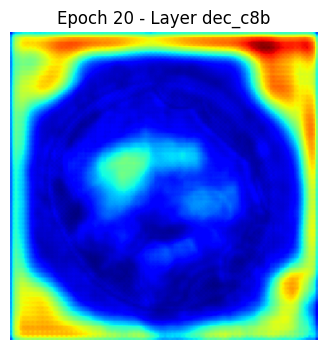

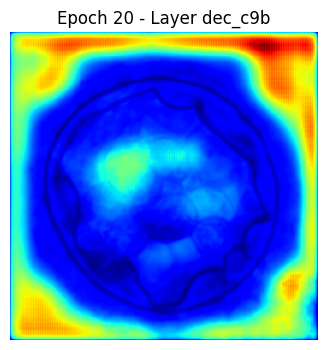

100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 230ms/step - accuracy: 0.8588 - dice_coefficient: 0.8330 - iou_metric: 0.7149 - loss: 0.2654 - val_accuracy: 0.8635 - val_dice_coefficient: 0.7933 - val_iou_metric: 0.6598 - val_loss: 0.3244
Epoch 21/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 223ms/step - accuracy: 0.8610 - dice_coefficient: 0.8437 - iou_metric: 0.7308 - loss: 0.2472 - val_accuracy: 0.8624 - val_dice_coefficient: 0.7975 - val_iou_metric: 0.6658 - val_loss: 0.3258
Epoch 22/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 222ms/step - accuracy: 0.8618 - dice_coefficient: 0.8513 - iou_metric: 0.7422 - loss: 0.2384 - val_accuracy: 0.8596 - val_dice_coefficient: 0.7903 - val_iou_metric: 0.6557 - val_loss: 0.3363
Epoch 23/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 223ms/step - accuracy: 0.8609 - dice_coefficient: 0.8536 - iou_metric: 0.7456 - loss: 0.2351 - val_accuracy: 0.8639 - val_dice_coefficient: 0.8057 - val_iou_metric: 0.6774 - val_loss: 0.3165
Epoch 24/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 223ms/step - accura

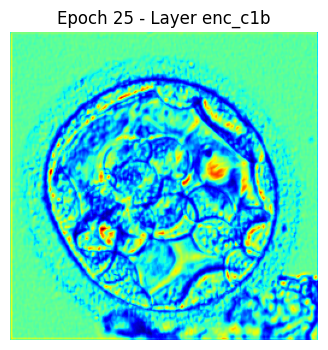

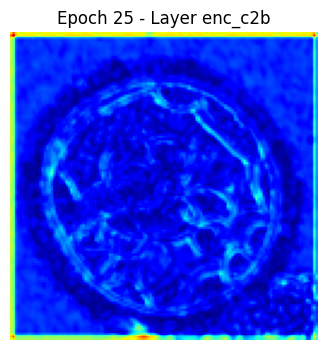

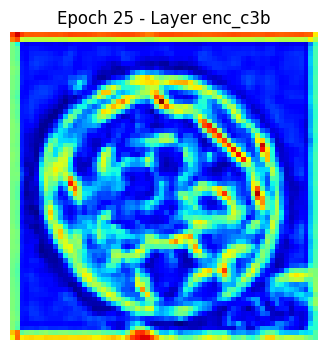

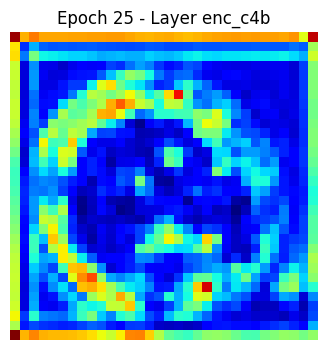

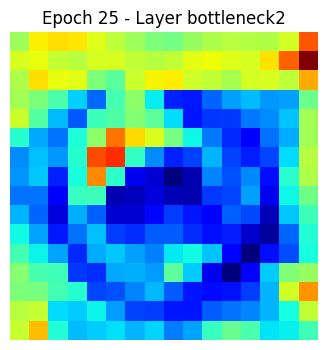

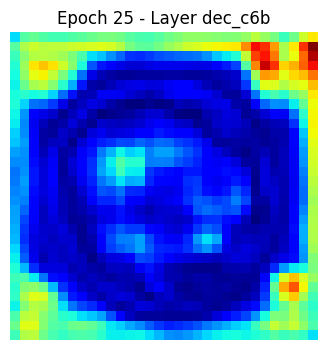

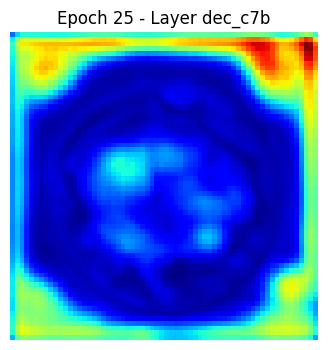

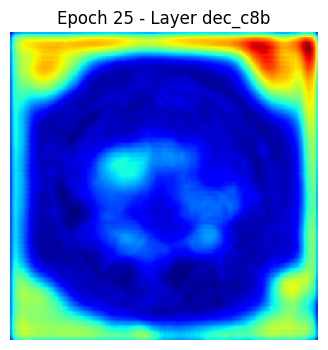

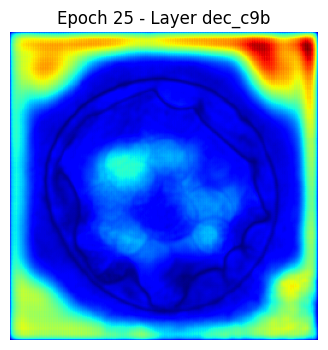

100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 231ms/step - accuracy: 0.8628 - dice_coefficient: 0.8640 - iou_metric: 0.7614 - loss: 0.2170 - val_accuracy: 0.8673 - val_dice_coefficient: 0.7797 - val_iou_metric: 0.6417 - val_loss: 0.3361
Epoch 26/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 222ms/step - accuracy: 0.8642 - dice_coefficient: 0.8717 - iou_metric: 0.7735 - loss: 0.2047 - val_accuracy: 0.8681 - val_dice_coefficient: 0.7877 - val_iou_metric: 0.6528 - val_loss: 0.3282
Epoch 27/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 224ms/step - accuracy: 0.8637 - dice_coefficient: 0.8702 - iou_metric: 0.7710 - loss: 0.2067 - val_accuracy: 0.8648 - val_dice_coefficient: 0.8158 - val_iou_metric: 0.6917 - val_loss: 0.3119
Epoch 28/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 222ms/step - accuracy: 0.8650 - dice_coefficient: 0.8847 - iou_metric: 0.7939 - loss: 0.1866 - val_accuracy: 0.8633 - val_dice_coefficient: 0.8022 - val_iou_metric: 0.6725 - val_loss: 0.3298
Epoch 29/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 222ms/step - accura

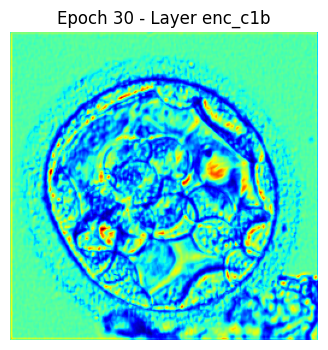

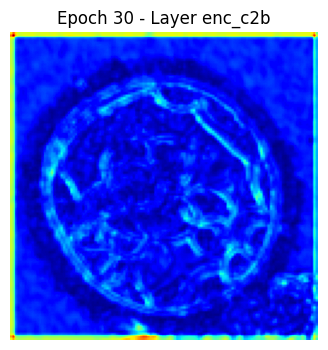

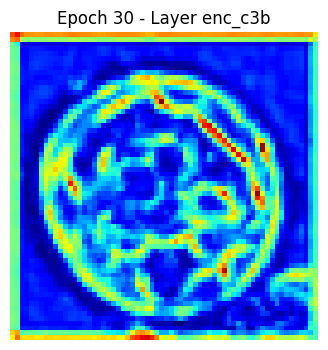

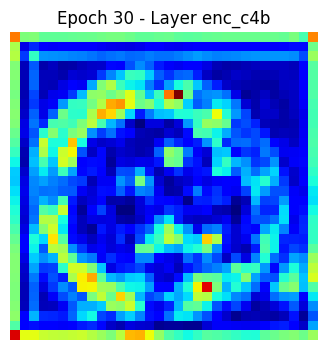

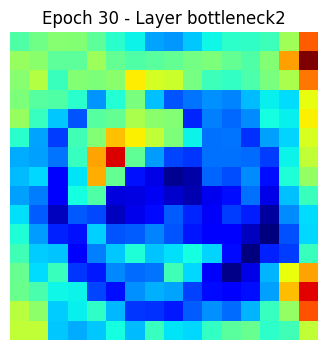

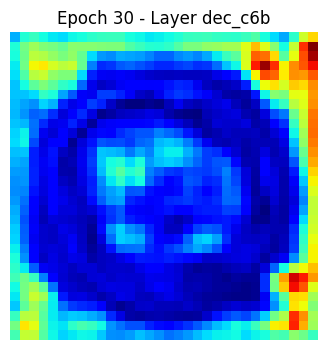

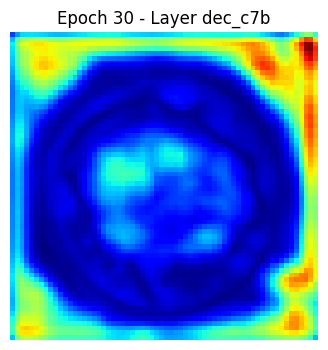

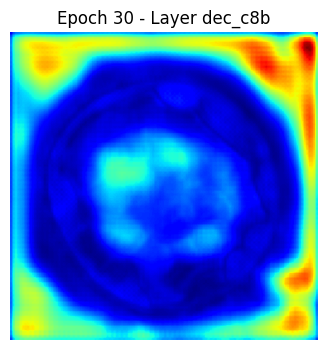

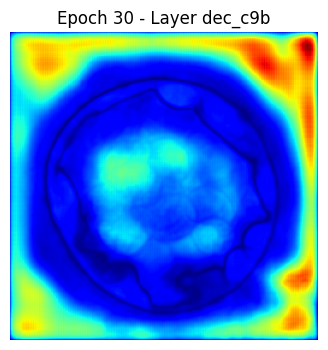

100/100 ━━━━━━━━━━━━━━━━━━━━ 24s 236ms/step - accuracy: 0.8653 - dice_coefficient: 0.8831 - iou_metric: 0.7915 - loss: 0.1862 - val_accuracy: 0.8628 - val_dice_coefficient: 0.8139 - val_iou_metric: 0.6890 - val_loss: 0.3246
Epoch 31/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 222ms/step - accuracy: 0.8663 - dice_coefficient: 0.8927 - iou_metric: 0.8069 - loss: 0.1740 - val_accuracy: 0.8619 - val_dice_coefficient: 0.7951 - val_iou_metric: 0.6627 - val_loss: 0.3353
Epoch 32/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 222ms/step - accuracy: 0.8674 - dice_coefficient: 0.8938 - iou_metric: 0.8086 - loss: 0.1688 - val_accuracy: 0.8615 - val_dice_coefficient: 0.8054 - val_iou_metric: 0.6771 - val_loss: 0.3299
Epoch 33/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 222ms/step - accuracy: 0.8676 - dice_coefficient: 0.8972 - iou_metric: 0.8141 - loss: 0.1641 - val_accuracy: 0.8672 - val_dice_coefficient: 0.8016 - val_iou_metric: 0.6718 - val_loss: 0.3334
Epoch 34/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 222ms/step - accura

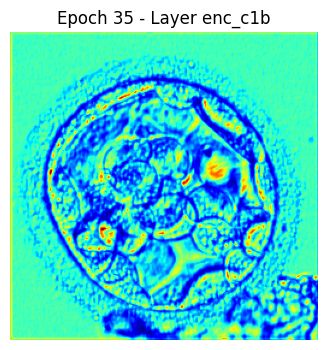

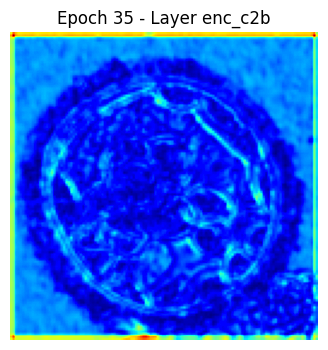

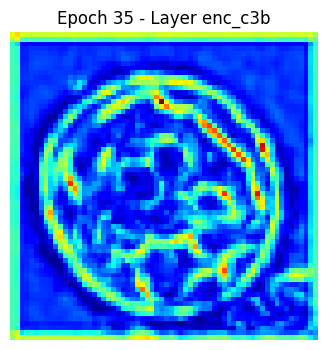

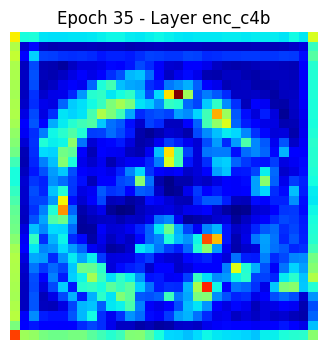

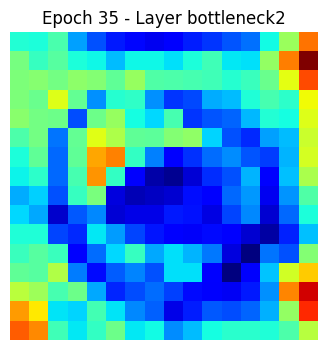

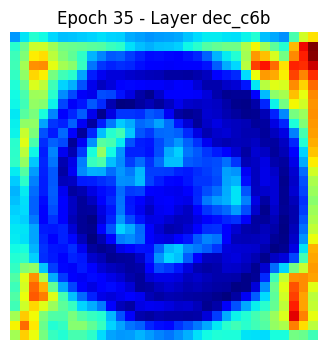

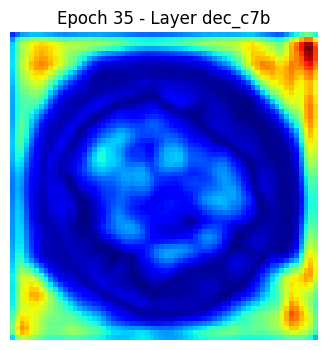

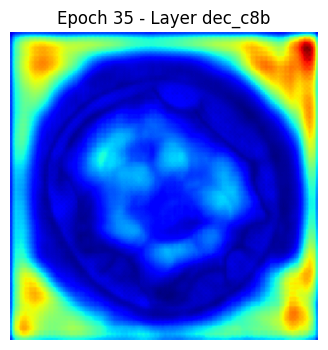

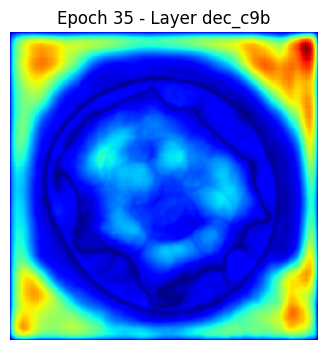

100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 231ms/step - accuracy: 0.8686 - dice_coefficient: 0.9025 - iou_metric: 0.8230 - loss: 0.1553 - val_accuracy: 0.8624 - val_dice_coefficient: 0.8241 - val_iou_metric: 0.7038 - val_loss: 0.3106
Epoch 36/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 223ms/step - accuracy: 0.8674 - dice_coefficient: 0.9050 - iou_metric: 0.8270 - loss: 0.1525 - val_accuracy: 0.8649 - val_dice_coefficient: 0.8049 - val_iou_metric: 0.6765 - val_loss: 0.3449
Epoch 37/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 223ms/step - accuracy: 0.8675 - dice_coefficient: 0.9058 - iou_metric: 0.8283 - loss: 0.1517 - val_accuracy: 0.8656 - val_dice_coefficient: 0.8105 - val_iou_metric: 0.6844 - val_loss: 0.3447
Epoch 38/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 222ms/step - accuracy: 0.8692 - dice_coefficient: 0.9119 - iou_metric: 0.8385 - loss: 0.1409 - val_accuracy: 0.8636 - val_dice_coefficient: 0.8113 - val_iou_metric: 0.6852 - val_loss: 0.3317
Epoch 39/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 223ms/step - accura

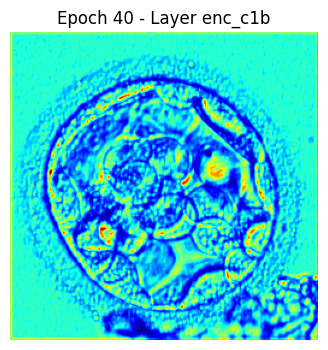

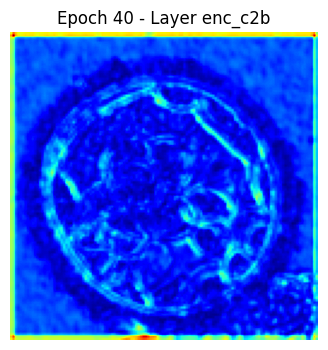

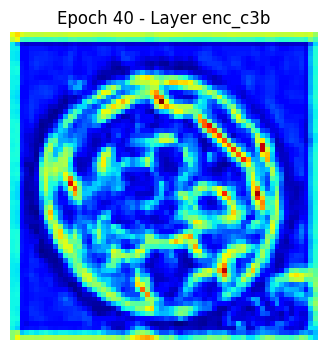

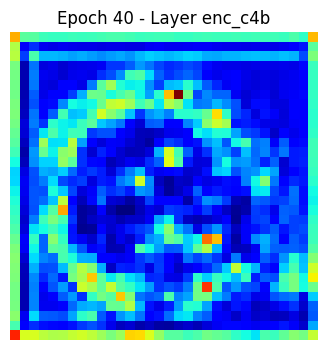

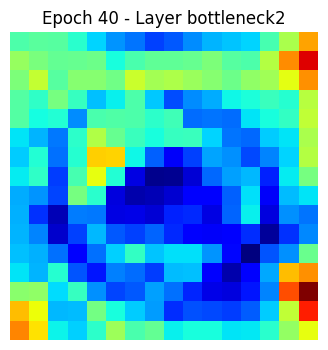

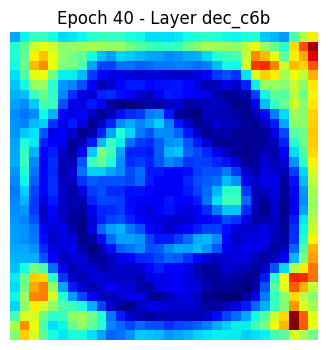

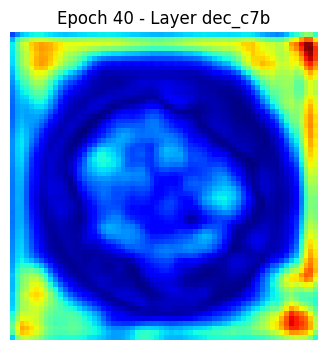

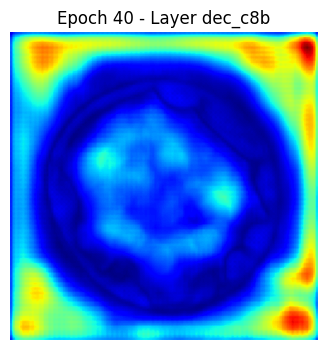

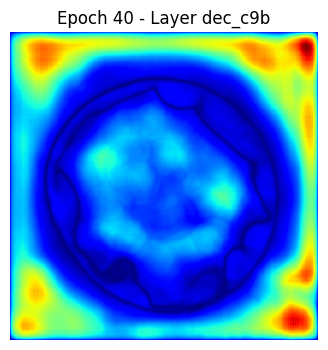

100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 230ms/step - accuracy: 0.8692 - dice_coefficient: 0.9200 - iou_metric: 0.8521 - loss: 0.1284 - val_accuracy: 0.8667 - val_dice_coefficient: 0.8086 - val_iou_metric: 0.6817 - val_loss: 0.3468
Epoch 41/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 222ms/step - accuracy: 0.8700 - dice_coefficient: 0.9215 - iou_metric: 0.8547 - loss: 0.1248 - val_accuracy: 0.8611 - val_dice_coefficient: 0.7975 - val_iou_metric: 0.6657 - val_loss: 0.3534
Epoch 42/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 222ms/step - accuracy: 0.8692 - dice_coefficient: 0.9159 - iou_metric: 0.8453 - loss: 0.1332 - val_accuracy: 0.8663 - val_dice_coefficient: 0.8140 - val_iou_metric: 0.6896 - val_loss: 0.3451
Epoch 43/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 222ms/step - accuracy: 0.8700 - dice_coefficient: 0.9233 - iou_metric: 0.8579 - loss: 0.1228 - val_accuracy: 0.8678 - val_dice_coefficient: 0.8031 - val_iou_metric: 0.6743 - val_loss: 0.3597
Epoch 44/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 22s 222ms/step - accura

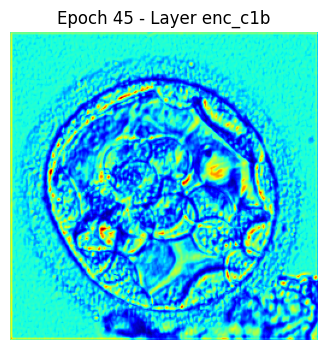

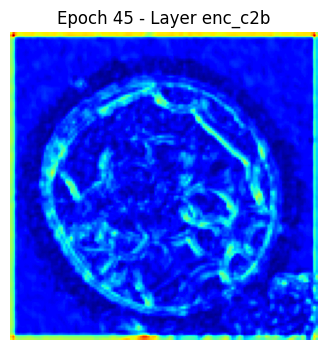

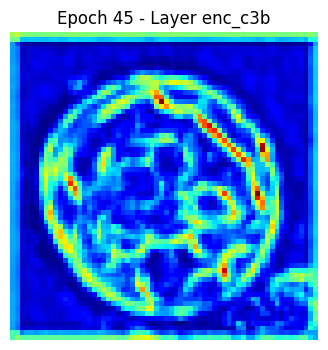

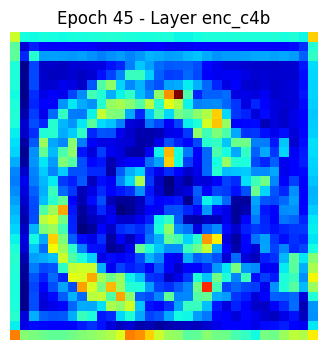

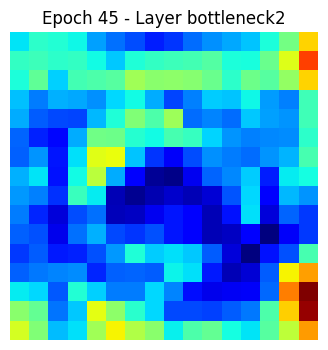

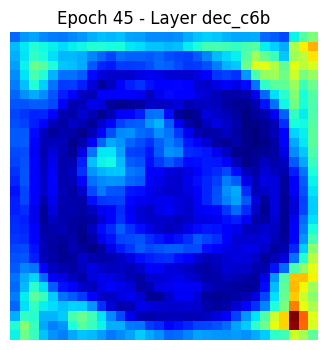

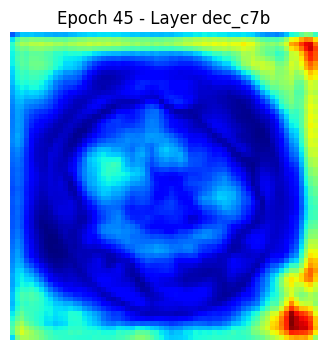

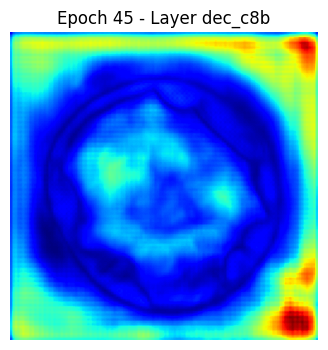

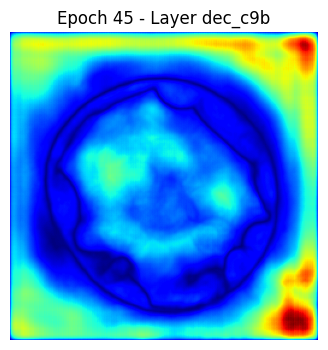

100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 229ms/step - accuracy: 0.8699 - dice_coefficient: 0.9304 - iou_metric: 0.8701 - loss: 0.1105 - val_accuracy: 0.8663 - val_dice_coefficient: 0.8176 - val_iou_metric: 0.6944 - val_loss: 0.3560


Model: "functional_8"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer_4       │ (None, 256, 256,  │          0 │ -                 │
│ (InputLayer)        │ 1)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c1a (Conv2D)    │ (None, 256, 256,  │        640 │ input_layer_4[0]… │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c1b (Conv2D)    │ (None, 256, 256,  │     36,928 │ enc_c1a[0][0]     │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool1               │ (None, 128, 128,  │          0 │ enc_c1b[0][0]     │
│ (MaxPooling2D)      │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c2a (Conv2D)    │ (None, 128, 128,  │     73,856 │ pool1[0][0]       │
│                     │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c2b (Conv2D)    │ (None, 128, 128,  │    147,584 │ enc_c2a[0][0]     │
│                     │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool2               │ (None, 64, 64,    │          0 │ enc_c2b[0][0]     │
│ (MaxPooling2D)      │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c3a (Conv2D)    │ (None, 64, 64,    │    295,168 │ pool2[0][0]       │
│                     │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c3b (Conv2D)    │ (None, 64, 64,    │    590,080 │ enc_c3a[0][0]     │
│                     │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool3               │ (None, 32, 32,    │          0 │ enc_c3b[0][0]     │
│ (MaxPooling2D)      │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c4a (Conv2D)    │ (None, 32, 32,    │  1,180,160 │ pool3[0][0]       │
│                     │ 512)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c4b (Conv2D)    │ (None, 32, 32,    │  2,359,808 │ enc_c4a[0][0]     │
│                     │ 512)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool4               │ (None, 16, 16,    │          0 │ enc_c4b[0][0]     │
│ (MaxPooling2D)      │ 512)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ bottleneck1         │ (None, 16, 16,    │  4,719,616 │ pool4[0][0]       │
│ (Conv2D)            │ 1024)             │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ bottleneck2         │ (None, 16, 16,    │  9,438,208 │ bottleneck1[0][0] │
│ (Conv2D)            │ 1024)             │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dec6_up             │ (None, 32, 32,    │  2,097,664 │ bottleneck2[0][0] │
│ (Conv2DTranspose)   │ 512)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dec6_att            │ (None, 32, 32,    │         99 │ enc_c4b[0][0]   

 Total params: 93,092,969 (355.12 MB)

 Trainable params: 31,030,989 (118.37 MB)

 Non-trainable params: 0 (0.00 B)

 Optimizer params: 62,061,980 (236.75 MB)

GFLOPs calculation not available, use tensorflow profiler for exact computation.
Training time for fold 5: 1037.98s


In [15]:
import matplotlib.pyplot as plt
import time
from sklearn.model_selection import KFold
import numpy as np
import glob
import tensorflow as tf
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint

# -------------------------
# Training loop with K-Fold
# -------------------------
EPOCHS = 300
BATCH_SIZE = 8

early_stopping = EarlyStopping(
    monitor='val_dice_coefficient',
    patience=10,
    mode='max',
    restore_best_weights=True
)

checkpoint = ModelCheckpoint(
    "best_model.h5",
    monitor='val_dice_coefficient',
    save_best_only=True,
    mode='max'
)

image_paths = np.array(sorted(glob.glob(os.path.join(TRAIN_IMAGES_DIR, "*.bmp"))))
mask_paths  = np.array(sorted(glob.glob(os.path.join(TRAIN_MASKS_DIR, "*.bmp"))))

kfold = KFold(n_splits=5, shuffle=True, random_state=42)
fold_num = 1

for train_idx, val_idx in kfold.split(image_paths):
    print(f"\n--- Fold {fold_num} ---")

    train_images, train_masks = image_paths[train_idx], mask_paths[train_idx]
    val_images, val_masks = image_paths[val_idx], mask_paths[val_idx]

    # -------------------------
    # Dataset creation
    # -------------------------
    def dataset_from_paths(images, masks, shuffle=True):
        dataset = tf.data.Dataset.from_tensor_slices((images, masks))
        dataset = dataset.map(load_image, num_parallel_calls=tf.data.AUTOTUNE)
        if shuffle:
            dataset = dataset.shuffle(100)
        return dataset.batch(BATCH_SIZE).prefetch(tf.data.AUTOTUNE)

    train_dataset = dataset_from_paths(train_images, train_masks)
    val_dataset = dataset_from_paths(val_images, val_masks, shuffle=False)

    # -------------------------
    # Build model
    # -------------------------
    model = unet_with_spatial_block(input_shape=(256,256,1))
    model.compile(
        optimizer=tf.keras.optimizers.Adam(learning_rate=1e-4),
        loss=bce_dice_loss,
        metrics=['accuracy', dice_coefficient, iou_metric]
    )

    # -------------------------
    # Feature extractor for attention visualization
    # -------------------------
    layer_names = [
       'enc_c1b', 'enc_c2b', 'enc_c3b', 'enc_c4b', 'bottleneck2',
       'dec_c6b', 'dec_c7b', 'dec_c8b', 'dec_c9b'
    ]
    intermediate_outputs = [model.get_layer(name).output for name in layer_names]
    feature_model = tf.keras.Model(inputs=model.input, outputs=intermediate_outputs)

    # Sample image for attention visualization
    sample_image = load_only_image(val_images[0])
    sample_image = tf.expand_dims(sample_image, axis=0)  # Add batch dimension

    # -------------------------
    # Custom callback for attention maps
    # -------------------------
    class AttentionMapLogger(tf.keras.callbacks.Callback):
        def __init__(self, sample_image, every_n_epochs=5):
            super().__init__()
            self.sample_image = sample_image
            self.every_n_epochs = every_n_epochs

        def on_epoch_end(self, epoch, logs=None):
            if (epoch + 1) % self.every_n_epochs == 0:
                attention_features = feature_model(self.sample_image, training=False)
                for i, fmap in enumerate(attention_features):
                    fmap_mean = tf.reduce_mean(fmap, axis=-1)  # average over channels
                    fmap_img = tf.squeeze(fmap_mean).numpy()
                    plt.figure(figsize=(4,4))
                    plt.imshow(fmap_img, cmap='jet')
                    plt.title(f"Epoch {epoch+1} - Layer {layer_names[i]}")
                    plt.axis('off')
                    plt.show()

    attention_logger = AttentionMapLogger(sample_image, every_n_epochs=5)

    # -------------------------
    # Train
    # -------------------------
    start_time = time.time()
    history = model.fit(
        train_dataset,
        validation_data=val_dataset,
        epochs=EPOCHS,
        callbacks=[early_stopping, checkpoint, attention_logger]
    )
    end_time = time.time()

    # -------------------------
    # Model summary, GFLOPs, training time
    # -------------------------
    model.summary()
    try:
        from tensorflow.python.profiler import model_analyzer
        from tensorflow.python.profiler.option_builder import ProfileOptionBuilder
        profile = model_analyzer.profile(
            model, options=ProfileOptionBuilder.float_operation()
        )
        print(f"GFLOPs: {profile.total_float_ops / 1e9}")
    except:
        print("GFLOPs calculation not available, use tensorflow profiler for exact computation.")

    print(f"Training time for fold {fold_num}: {end_time - start_time:.2f}s")
    fold_num += 1


In [16]:

# -------------------------
# Load best model
# -------------------------
model = unet_with_spatial_block(input_shape=(256, 256, 1))
model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=1e-4),
              loss=bce_dice_loss,
              metrics=['accuracy', dice_coefficient, iou_metric])

model.load_weights("best_model.h5")


# -------------------------
# Evaluate on test set
# -------------------------
results = model.evaluate(test_dataset)
print("\nTest Results:")
for name, value in zip(model.metrics_names, results):
    print(f"{name}: {value:.4f}")

25/25 ━━━━━━━━━━━━━━━━━━━━ 5s 14ms/step - accuracy: 0.9600 - dice_coefficient: 0.8318 - iou_metric: 0.7166 - loss: 0.4476

Test Results:
loss: 0.3758
compile_metrics: 0.9657


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step


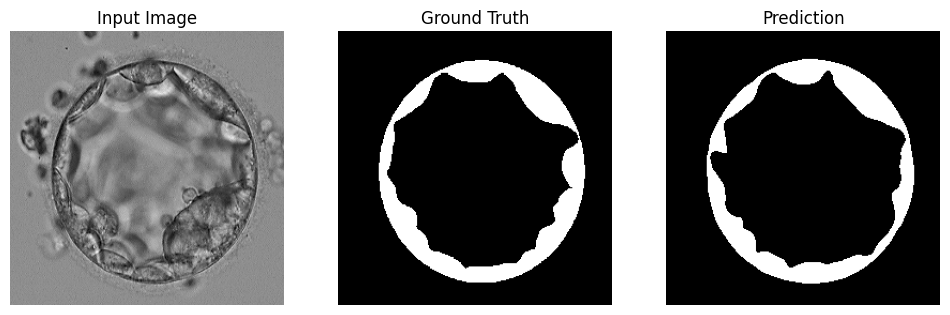

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step


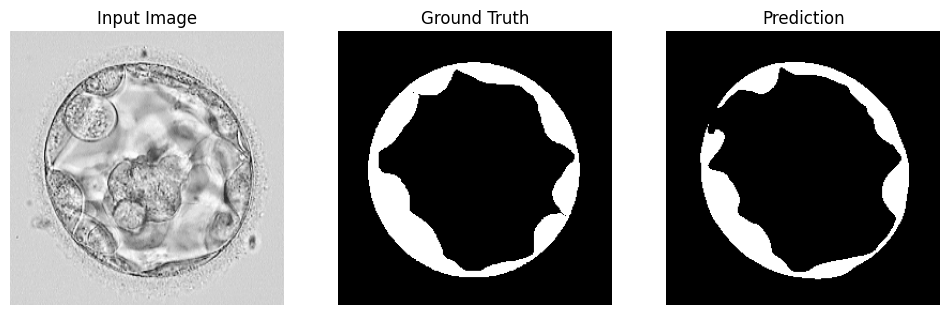

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step


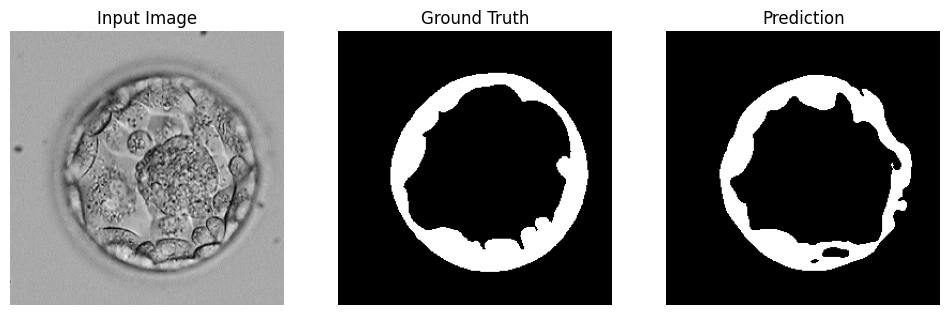

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step


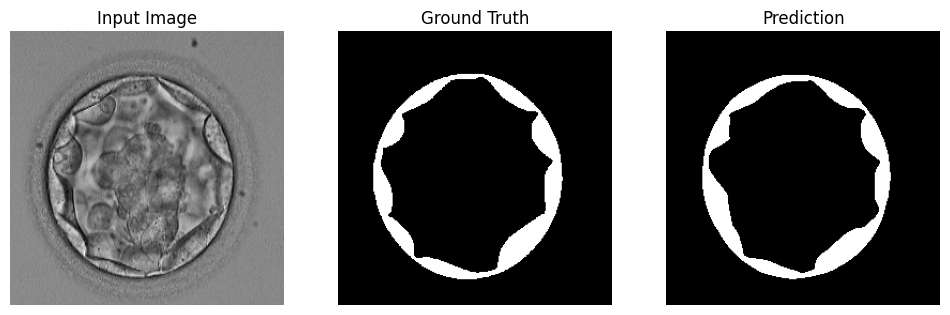

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step


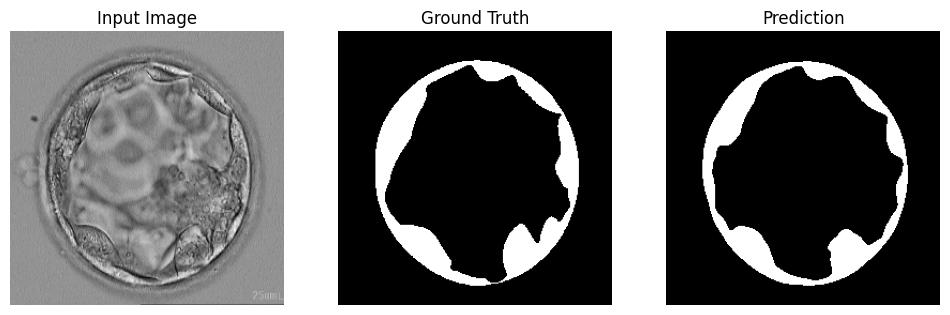

In [17]:
def display_predictions(model, dataset, num_samples=5):
    for batch_idx, (images, masks) in enumerate(dataset.take(num_samples)):
        preds = model.predict(images)
        preds = (preds > 0.5).astype("float32")  # Binarize predictions

        for i in range(len(images)):
            plt.figure(figsize=(12, 4))

            plt.subplot(1, 3, 1)
            plt.title("Input Image")
            plt.imshow(images[i].numpy().squeeze(), cmap="gray")
            plt.axis("off")

            plt.subplot(1, 3, 2)
            plt.title("Ground Truth")
            plt.imshow(masks[i].numpy().squeeze(), cmap="gray")
            plt.axis("off")

            plt.subplot(1, 3, 3)
            plt.title("Prediction")
            plt.imshow(preds[i].squeeze(), cmap="gray")
            plt.axis("off")

            plt.show()


display_predictions(model, test_dataset, num_samples=5)


